In [1]:
%matplotlib inline
import numpy as np
import pandas as pd

import datetime

import matplotlib.pyplot as plt
import pylab
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6

import statsmodels.api as sm  
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, acf, pacf, q_stat
from statsmodels.tsa.arima_model import ARIMA, ARMAResults
from statsmodels.graphics.gofplots import qqplot

from sklearn.metrics import mean_squared_error
from math import sqrt

In [2]:
np.random.seed(42)
data = pd.read_csv('../data/siteA.csv')

In [3]:
data['Date_Name'] = data['Date_Name'].apply(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

In [4]:
print data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66160 entries, 0 to 66159
Data columns (total 4 columns):
Date_Name        66160 non-null datetime64[ns]
subCategory      66160 non-null object
Purchase_Hour    66160 non-null int64
sales            66160 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 2.0+ MB
None


In [5]:
# Make a dataframe for each category, and put it into a list...len(list) = 16
# Essentially becomes a list of dataframe
def make_dataframe(df, lis):
    f = lambda x: df[df['subCategory'] == x]
    return map(f, lis)

temp_list = data['subCategory'].unique()
splitted_data = make_dataframe(data, temp_list)
print len(splitted_data)
print splitted_data[2][0:5]

16
      Date_Name subCategory  Purchase_Hour   sales
9259 2016-03-01           C              7  460.34
9260 2016-03-04           C              7  414.03
9261 2016-03-07           C              7  370.37
9262 2016-03-08           C              7  368.68
9263 2016-03-11           C              7  439.15


In [6]:
# Looks like some have missing dates, like category #10 has only half of the data.
idx = pd.date_range('09-26-2015', '09-30-2016')

for i, item in enumerate(temp_list):
    splitted_data[i] = splitted_data[i].groupby(by=['Date_Name'])['sales'].sum()
    print item, ':', splitted_data[i].shape
    

    splitted_data[i].index = pd.DatetimeIndex(splitted_data[i].index)
    splitted_data[i] = splitted_data[i].reindex(idx, fill_value=0)
    print item, ':', splitted_data[i].shape, '-', splitted_data[i].index

print '\n', splitted_data[0].head()

A : (345,)
A : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
B : (345,)
B : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
C : (345,)
C : (371,) - DatetimeIndex(['2015-09-26',

### L has the least amount of data...

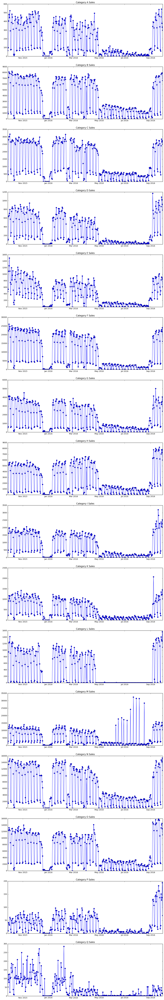

In [110]:
# Time series in connected point plot format...
# Scatter plot sales vs. DateTime for each subcategory...
# We can see the missing data(or date with 0 sales) in the time series this way

fig, axs = plt.subplots(16,1, figsize=(15, 96))
axs = axs.ravel()

for i, item in enumerate(data['subCategory'].unique()):
    axs[i].plot(splitted_data[i].index, splitted_data[i], '-o')
    axs[i].set_title('Category {} Sales'.format(item))

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

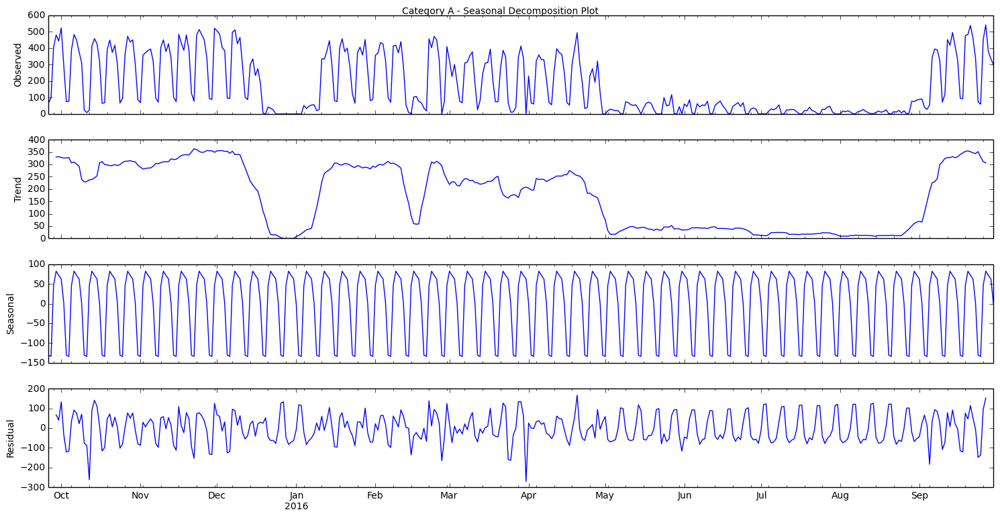

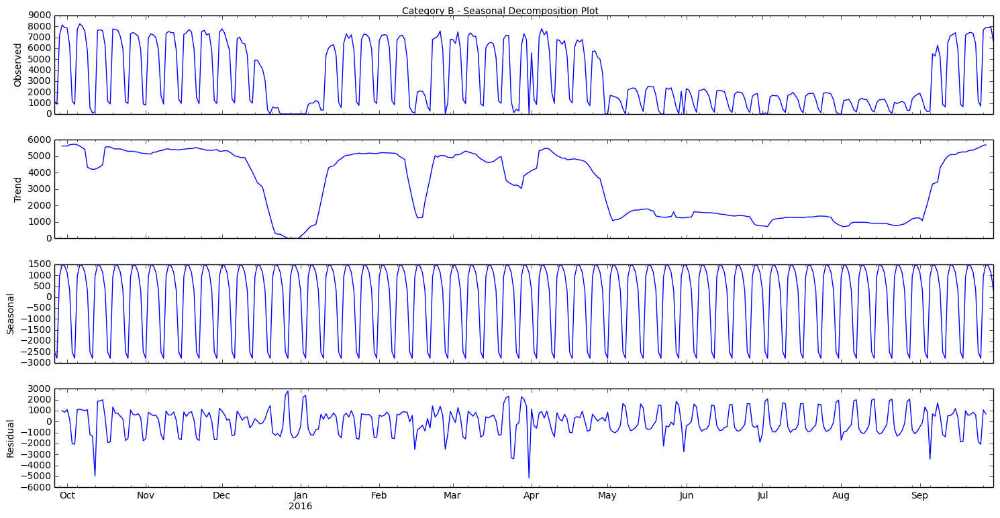

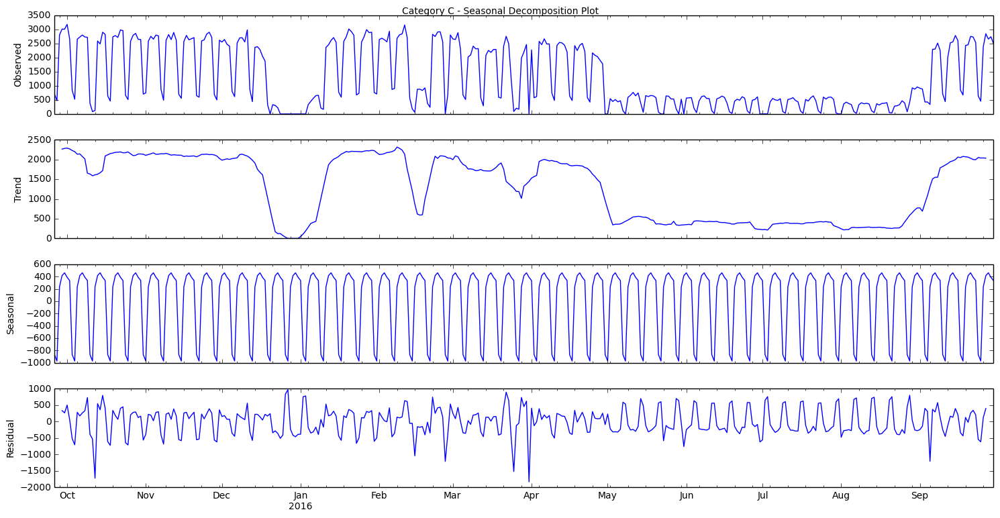

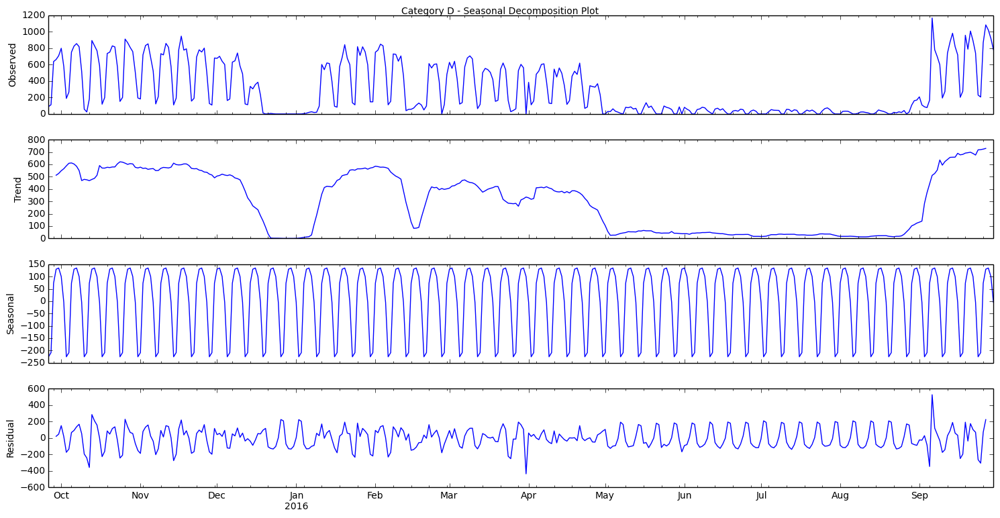

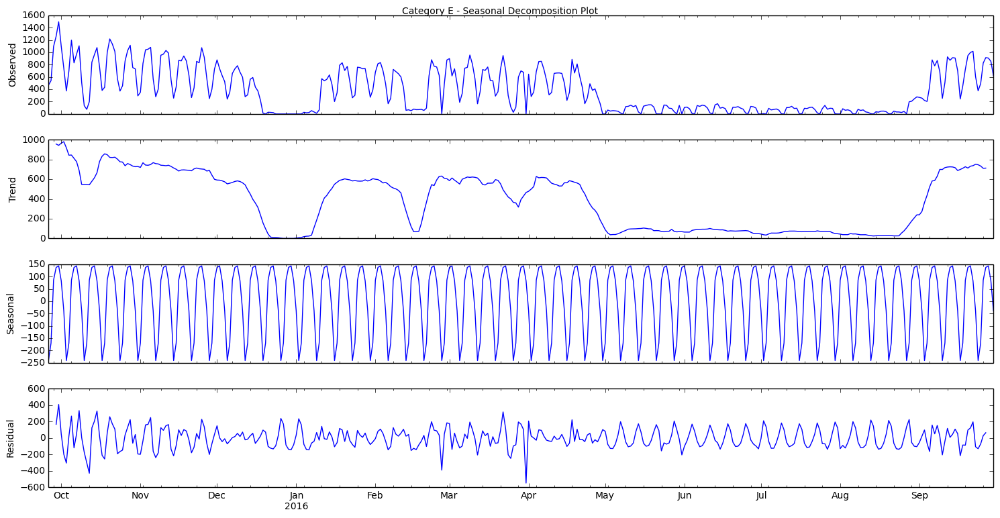

...

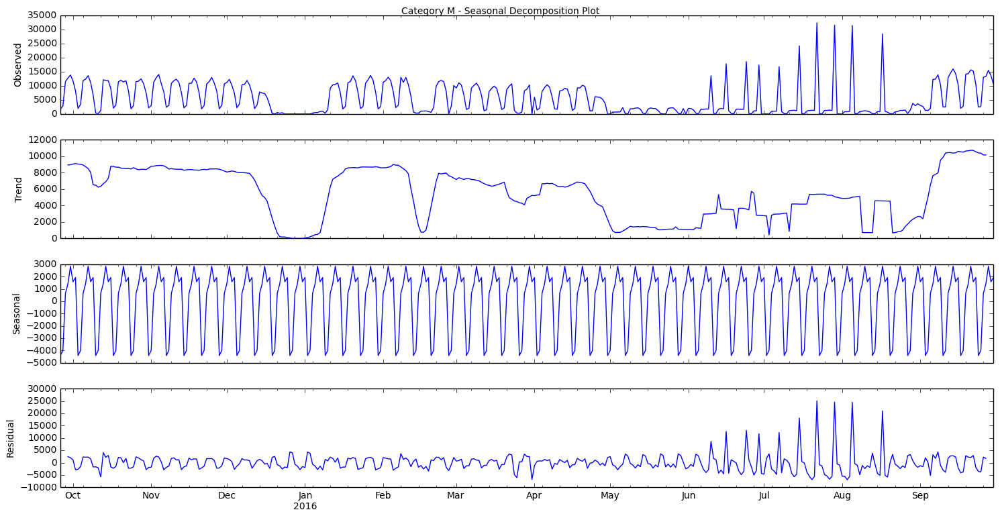

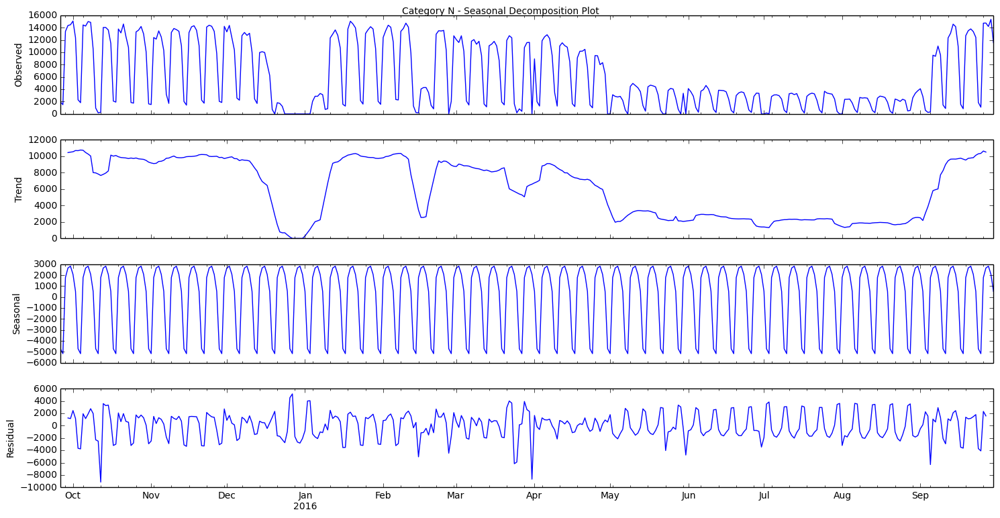

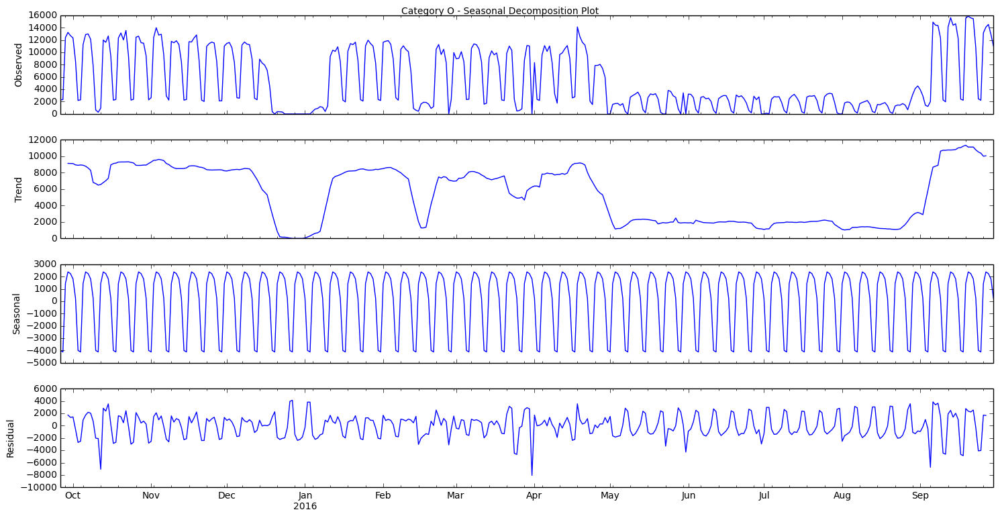

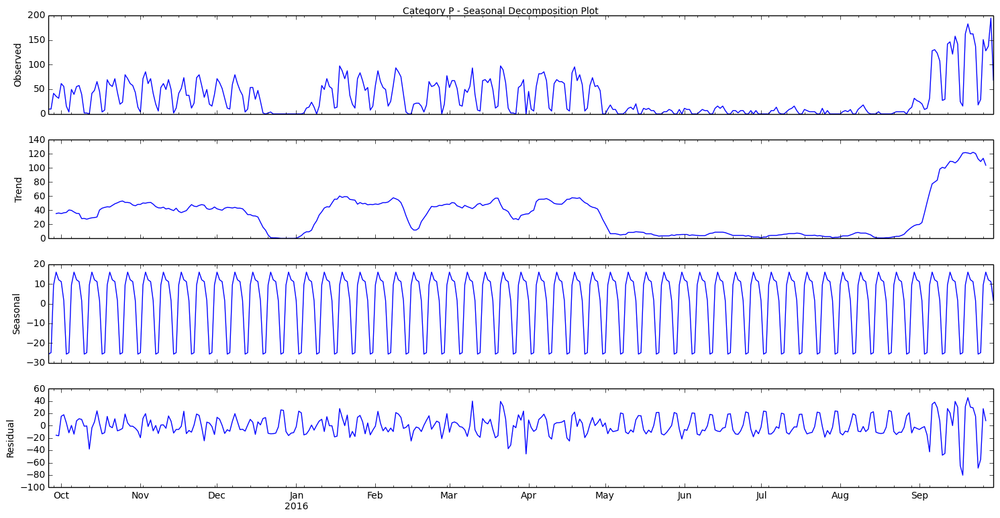

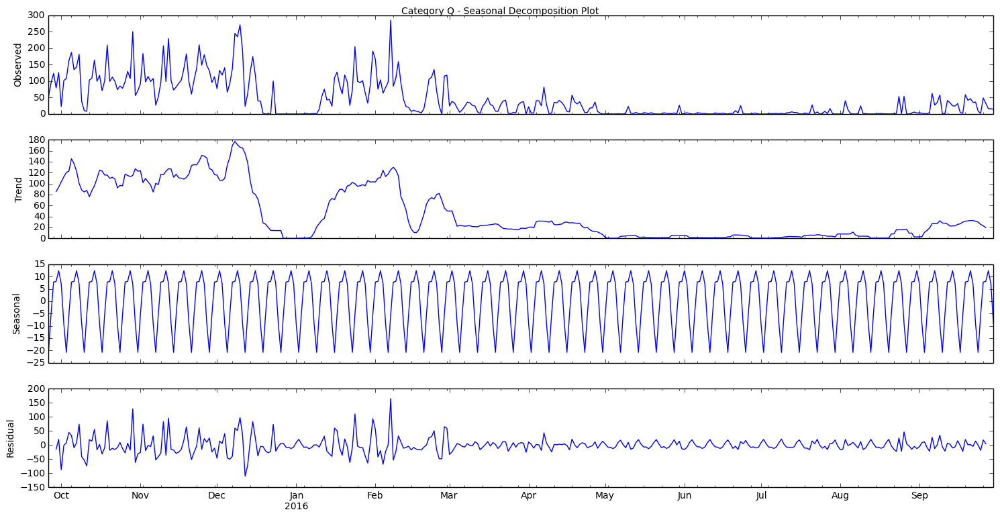

In [111]:
# Seasonal decomposition plots...
def decomposition(timeseries, item):
    decomposition = seasonal_decompose(timeseries, freq=7)
    fig = plt.figure()  
    fig = decomposition.plot()  
    fig.set_size_inches(15, 8)
    fig.suptitle('Category {} - Seasonal Decomposition Plot'.format(item))

map(decomposition, splitted_data, data['subCategory'].unique())

In [112]:
# A function to test serie's stationarity... 

def test_stationarity(timeseries, item):
    
    #Determing rolling statistics
    rolmean = pd.rolling_mean(timeseries, window=12)
    rolstd = pd.rolling_std(timeseries, window=12)

    #Plot rolling statistics:
    orig = plt.plot(timeseries, color='blue',label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('{} - Rolling Mean & Standard Deviation'.format(item))
    plt.show(block=False)
    
    #Perform Dickey-Fuller test:
    print 'Results of Dickey-Fuller Test:'
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print dfoutput

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


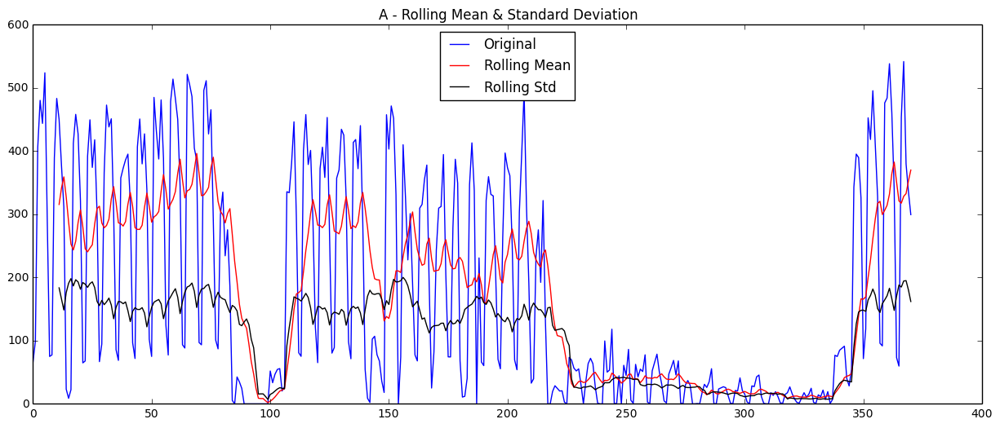

Results of Dickey-Fuller Test:
Test Statistic                  -2.295463
p-value                          0.173436
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


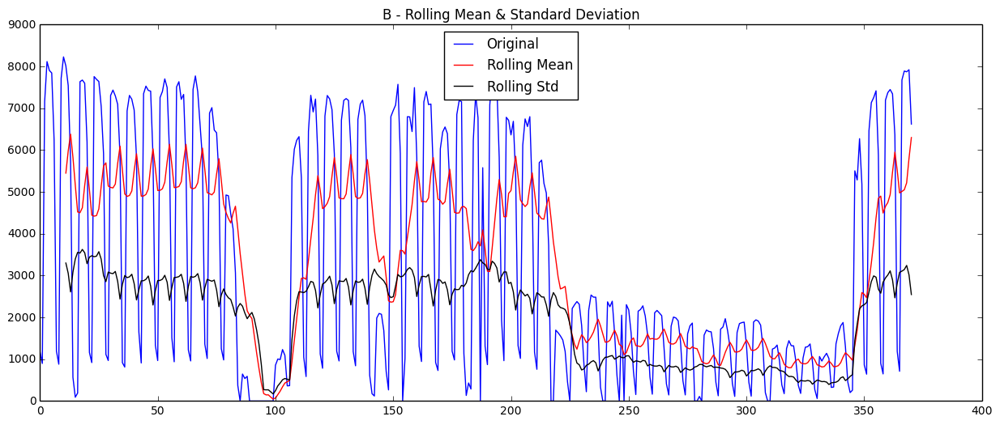

Results of Dickey-Fuller Test:
Test Statistic                  -2.428629
p-value                          0.133819
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


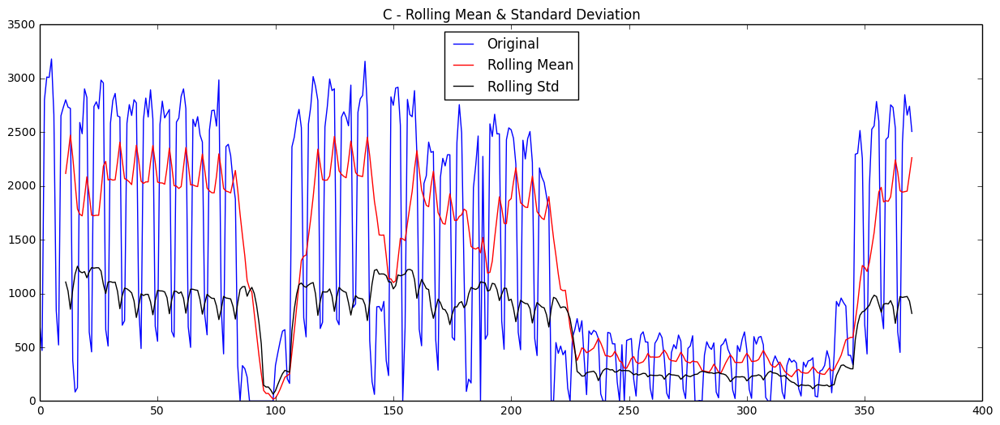

Results of Dickey-Fuller Test:
Test Statistic                  -2.466672
p-value                          0.123795
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


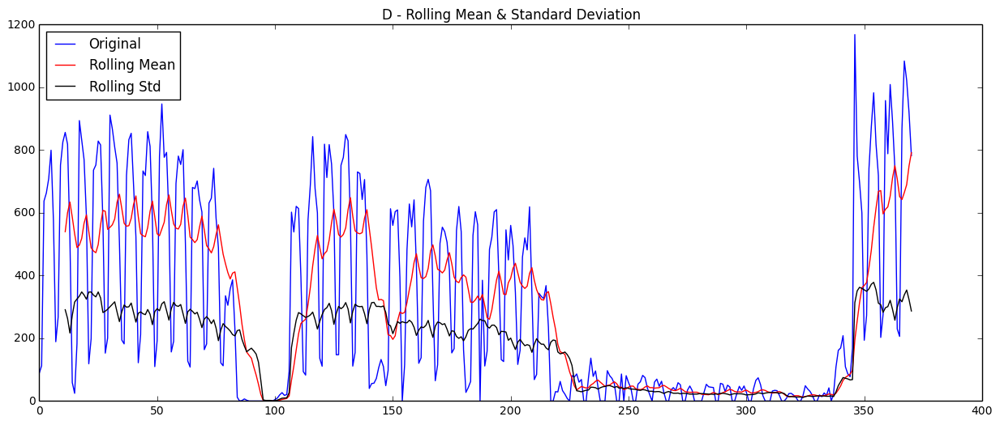

Results of Dickey-Fuller Test:
Test Statistic                  -2.255306
p-value                          0.186788
#Lags Used                       8.000000
Number of Observations Used    362.000000
Critical Value (5%)             -2.869557
Critical Value (1%)             -3.448544
Critical Value (10%)            -2.571041
dtype: float64


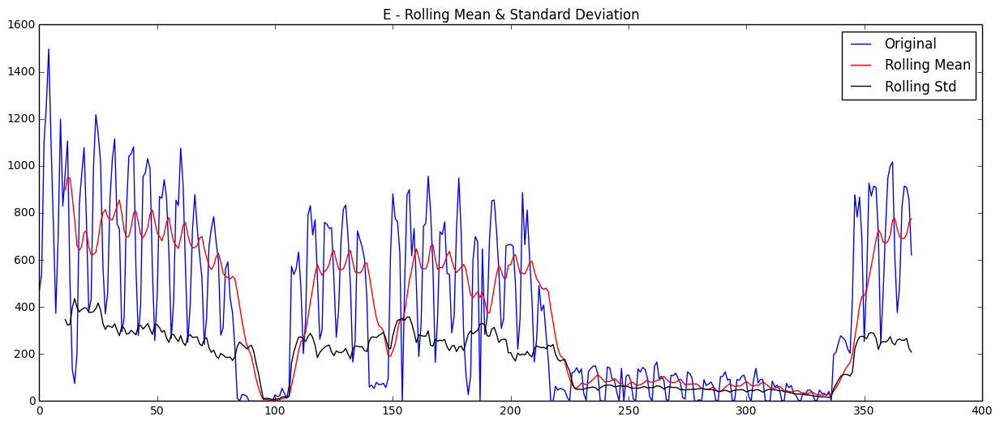

Results of Dickey-Fuller Test:
Test Statistic                  -2.023702
p-value                          0.276278
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


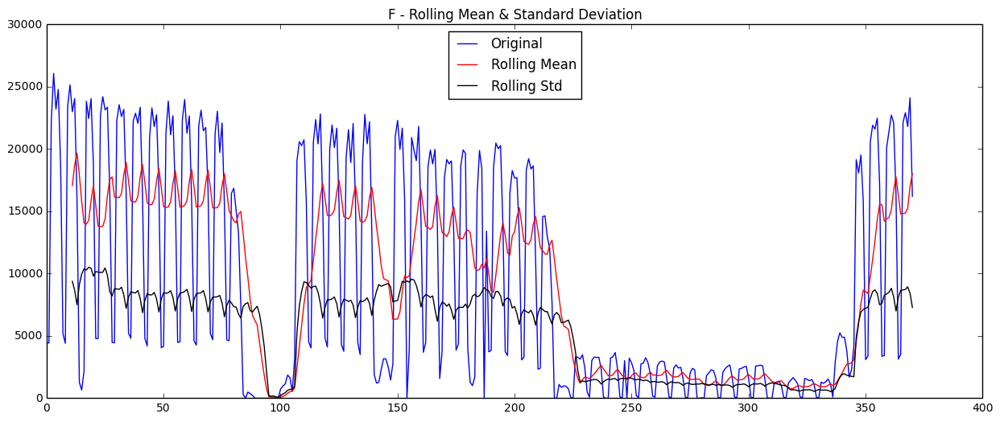

Results of Dickey-Fuller Test:
Test Statistic                  -2.251972
p-value                          0.187926
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


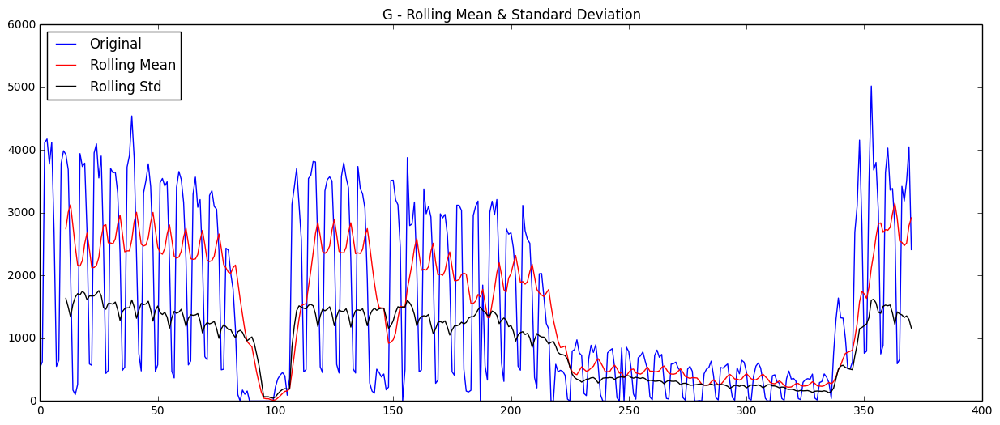

Results of Dickey-Fuller Test:
Test Statistic                  -2.361139
p-value                          0.153006
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


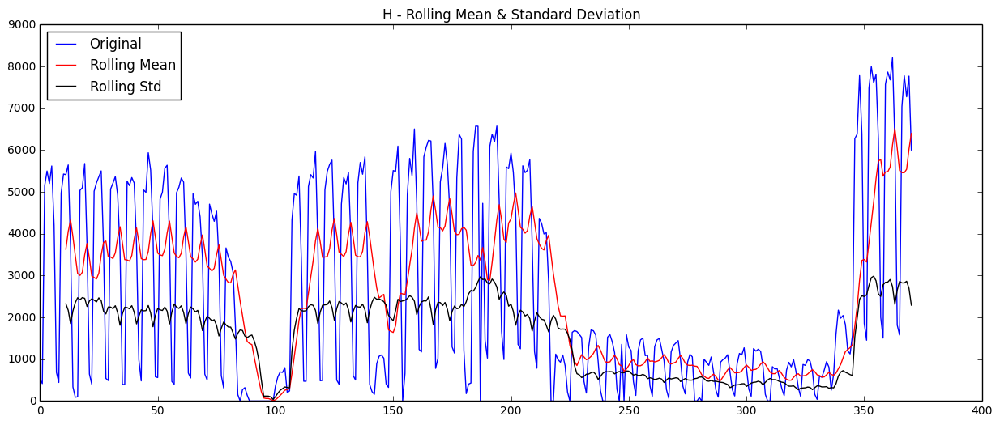

Results of Dickey-Fuller Test:
Test Statistic                  -2.173112
p-value                          0.216149
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


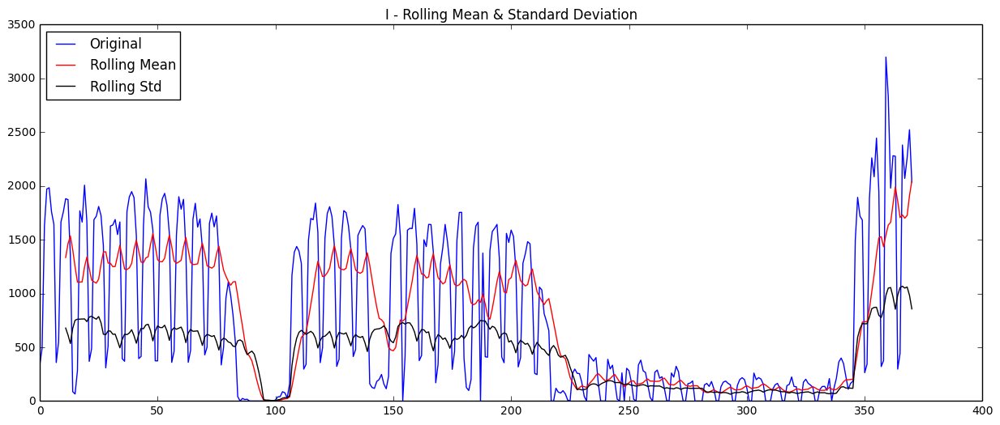

Results of Dickey-Fuller Test:
Test Statistic                  -2.155512
p-value                          0.222786
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


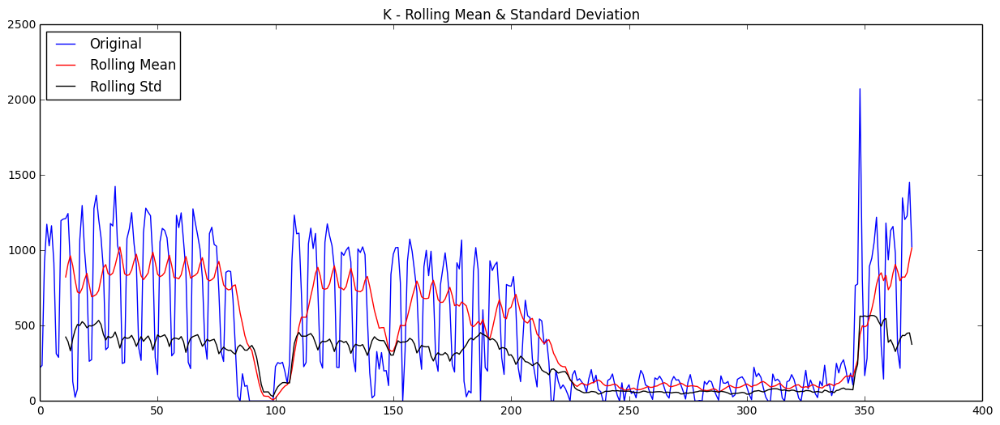

Results of Dickey-Fuller Test:
Test Statistic                  -2.132693
p-value                          0.231574
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


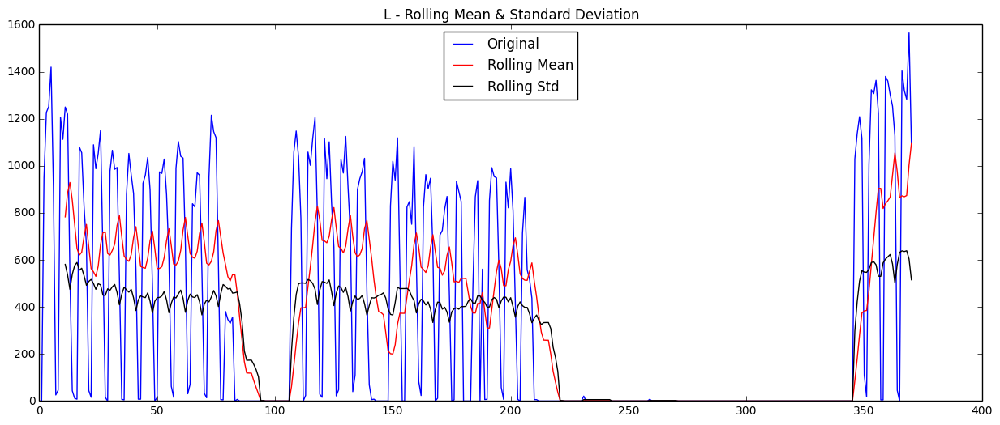

Results of Dickey-Fuller Test:
Test Statistic                  -2.164976
p-value                          0.219202
#Lags Used                      10.000000
Number of Observations Used    360.000000
Critical Value (5%)             -2.869602
Critical Value (1%)             -3.448646
Critical Value (10%)            -2.571065
dtype: float64


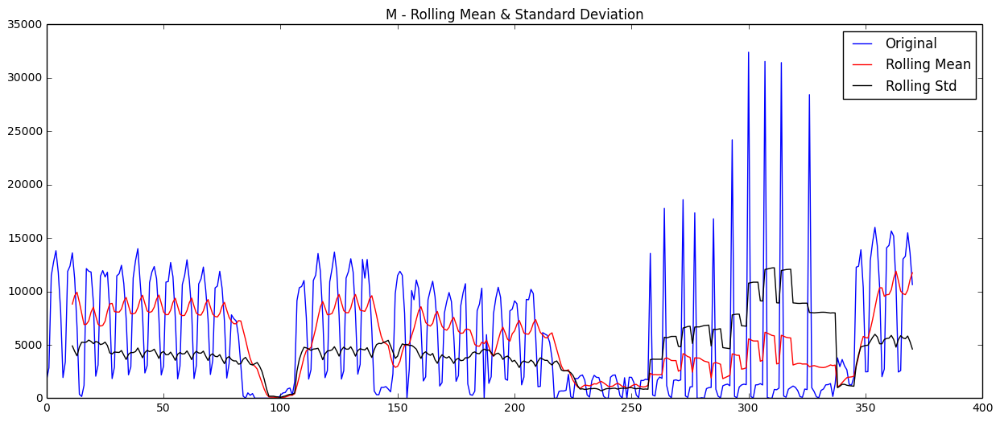

Results of Dickey-Fuller Test:
Test Statistic                  -2.717033
p-value                          0.071137
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


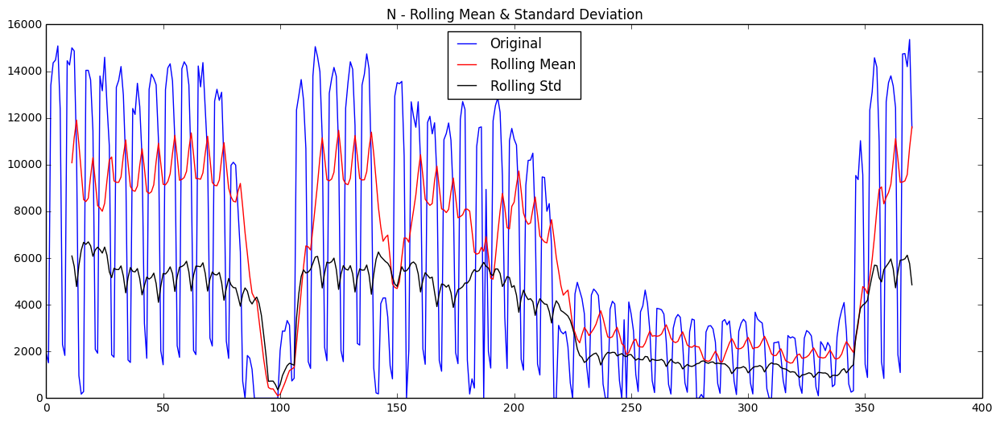

Results of Dickey-Fuller Test:
Test Statistic                  -2.408838
p-value                          0.139258
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


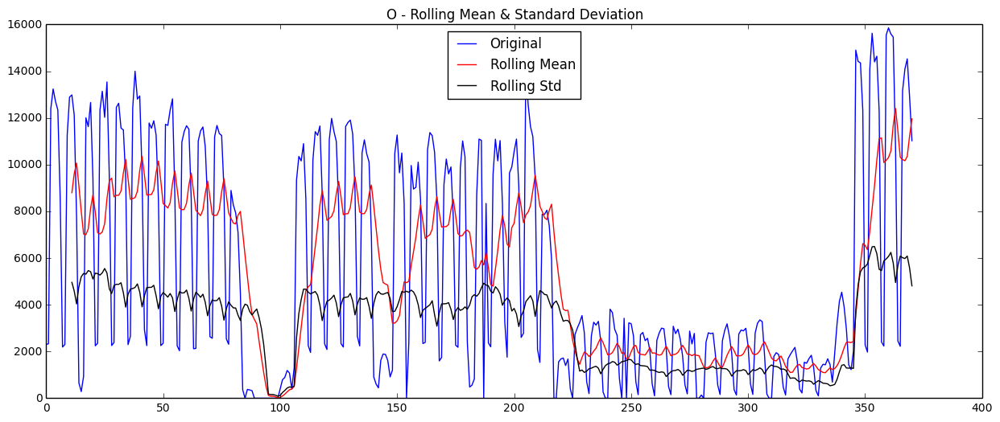

Results of Dickey-Fuller Test:
Test Statistic                  -2.493939
p-value                          0.116956
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


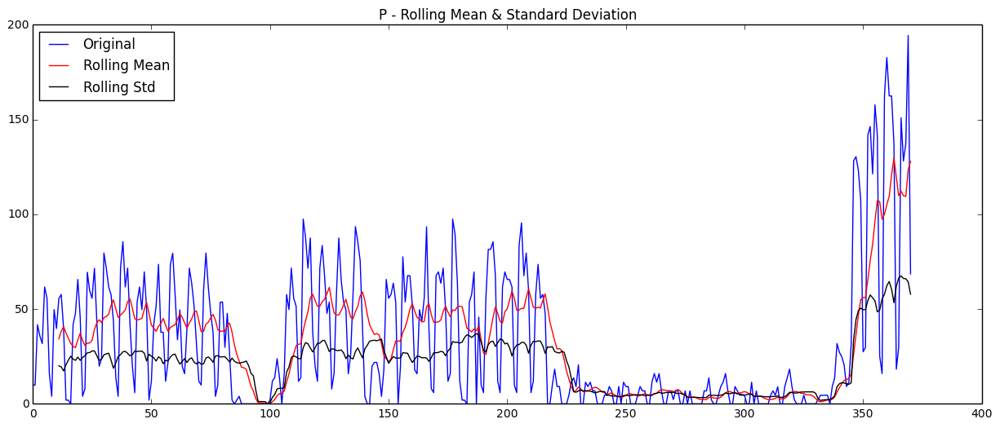

Results of Dickey-Fuller Test:
Test Statistic                  -2.402126
p-value                          0.141137
#Lags Used                       9.000000
Number of Observations Used    361.000000
Critical Value (5%)             -2.869580
Critical Value (1%)             -3.448595
Critical Value (10%)            -2.571053
dtype: float64


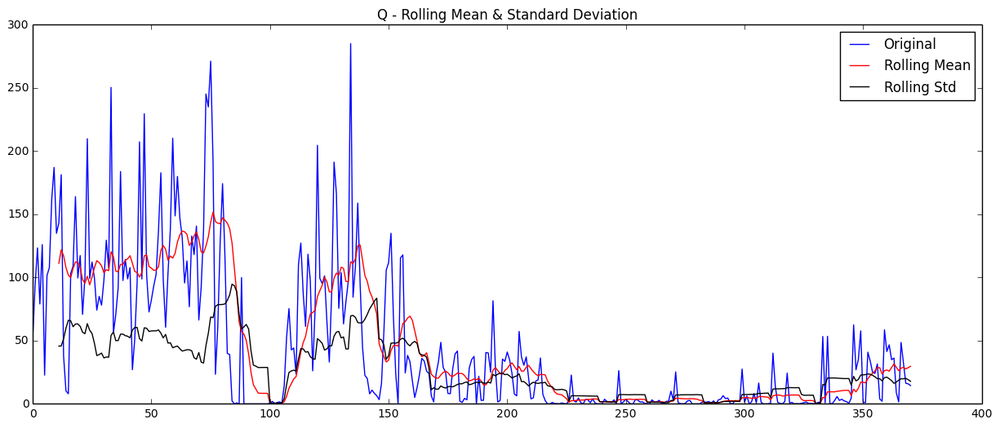

Results of Dickey-Fuller Test:
Test Statistic                  -2.230331
p-value                          0.195422
#Lags Used                      17.000000
Number of Observations Used    353.000000
Critical Value (5%)             -2.869763
Critical Value (1%)             -3.449011
Critical Value (10%)            -2.571151
dtype: float64


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [113]:
map(test_stationarity, splitted_data, data['subCategory'].unique())

### Most categories are not stationary...let's make it stationary!
#### 1) Log it
#### 2) Diff(Log)
#### 3) Season_diff(Diff(Log))

In [114]:
def plot_data(original, trans_2, item, title, label_1, label_2, trans_3=None, label_3=None):
    original.plot(label=' {} '.format(label_1))
    trans_2.plot(label=' {} '.format(label_2))
    if label_3:
        trans_3.plot(label=' {} '.format(label_3))
    plt.legend()
    plt.title(' {} - {} '.format(item, title))
    plt.show(block=False)

In [115]:
def log_data(timeseries, item):
    logged_data = timeseries.apply(lambda x: np.log(x))
    return logged_data

splitted_data_log = list(map(log_data, splitted_data, data['subCategory'].unique()))
print len(splitted_data_log[0])

371


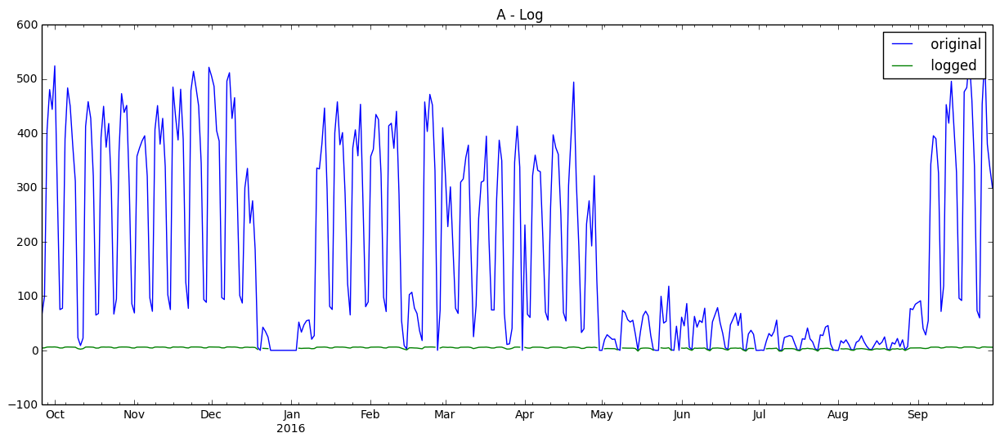

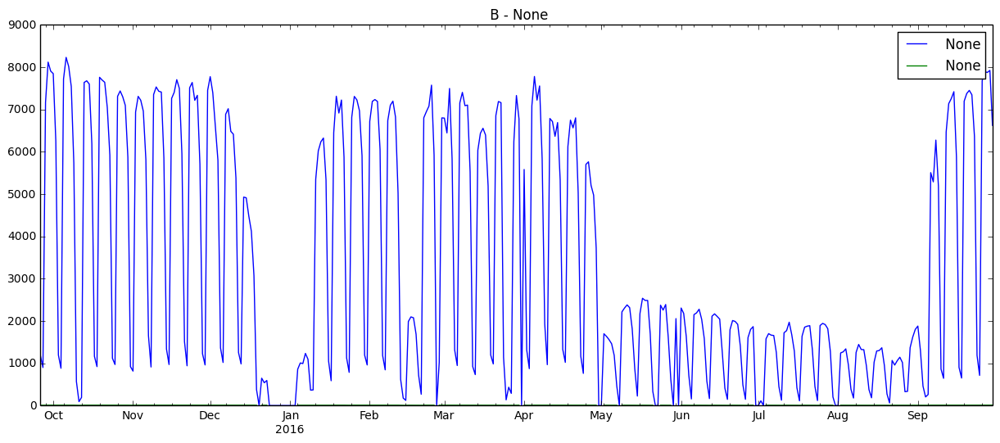

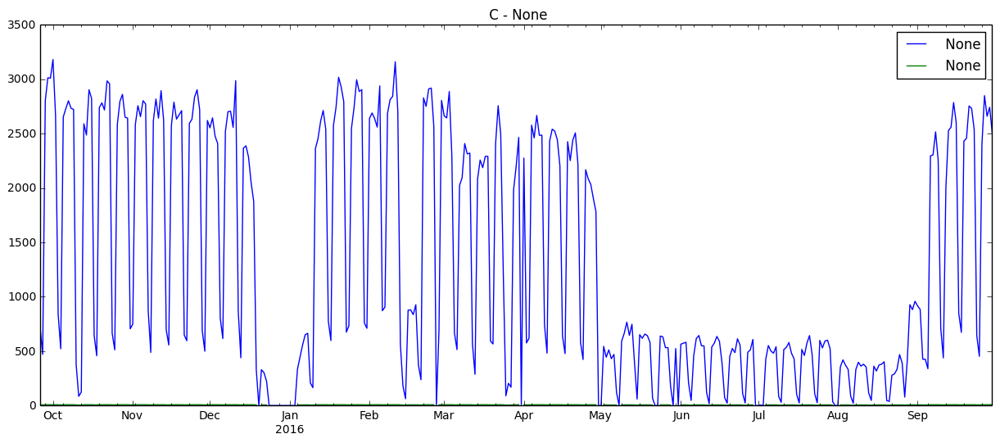

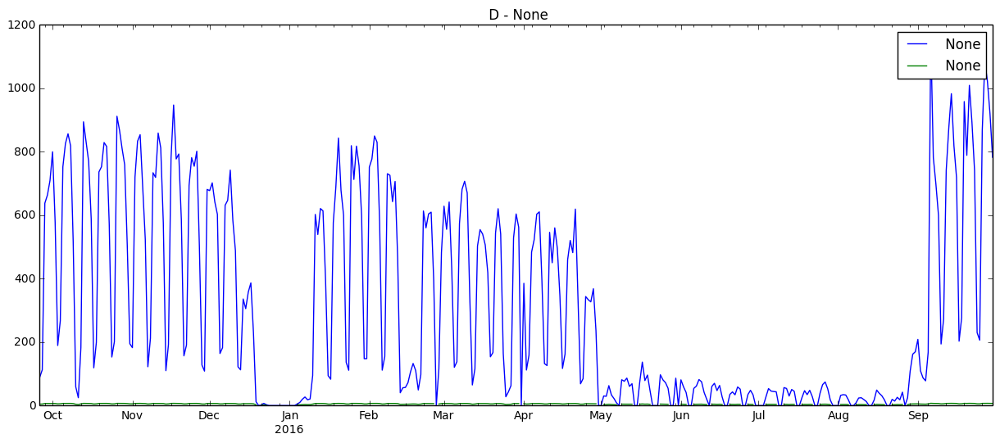

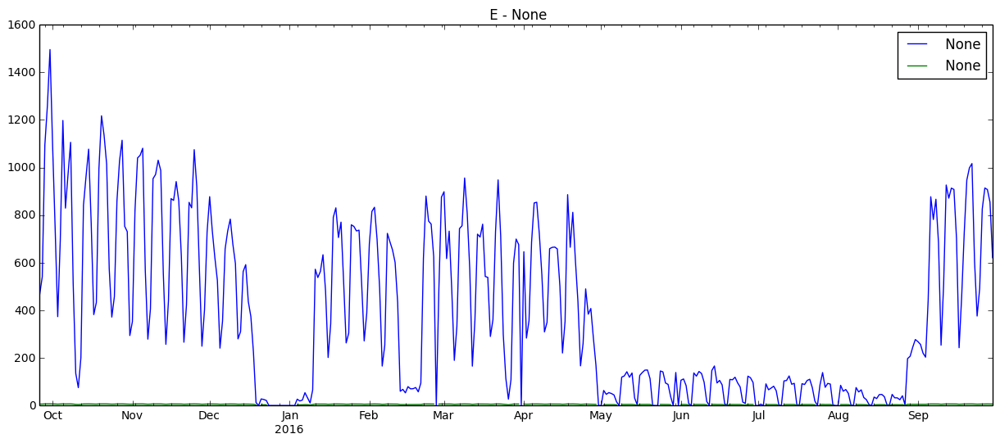

...

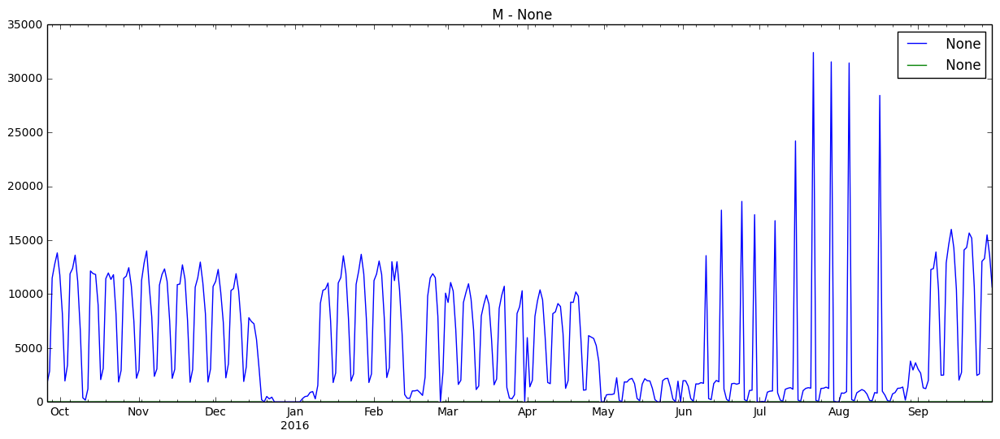

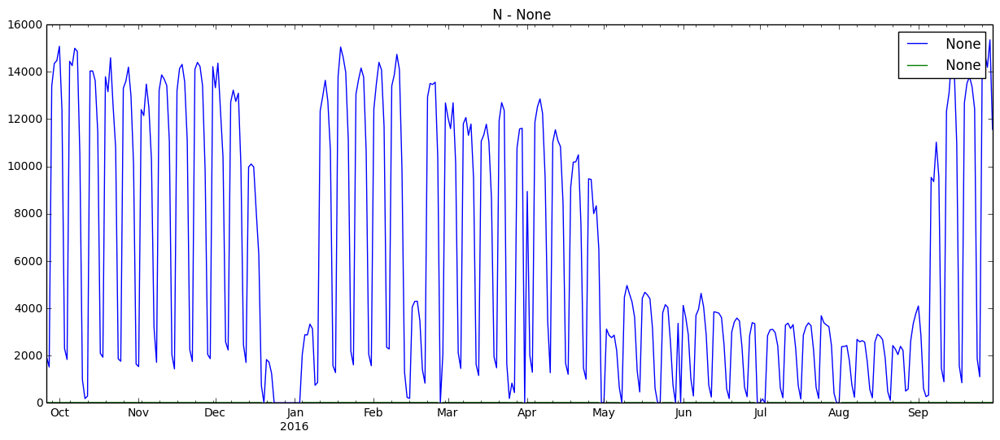

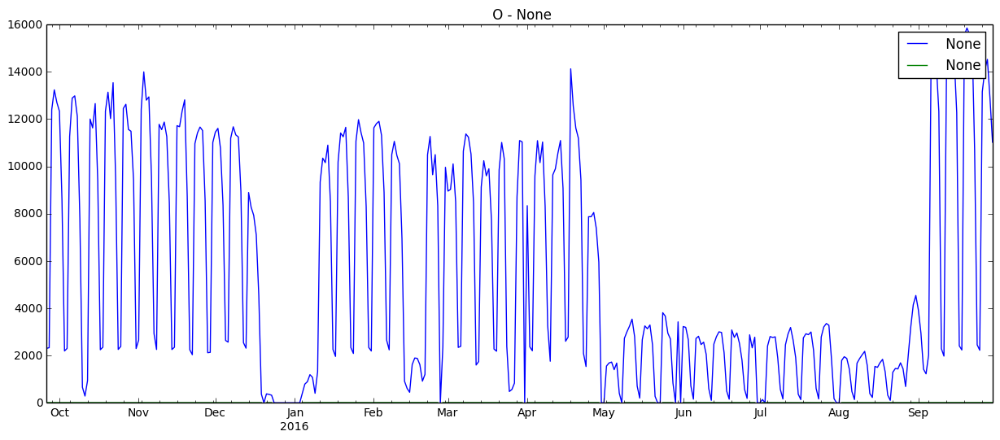

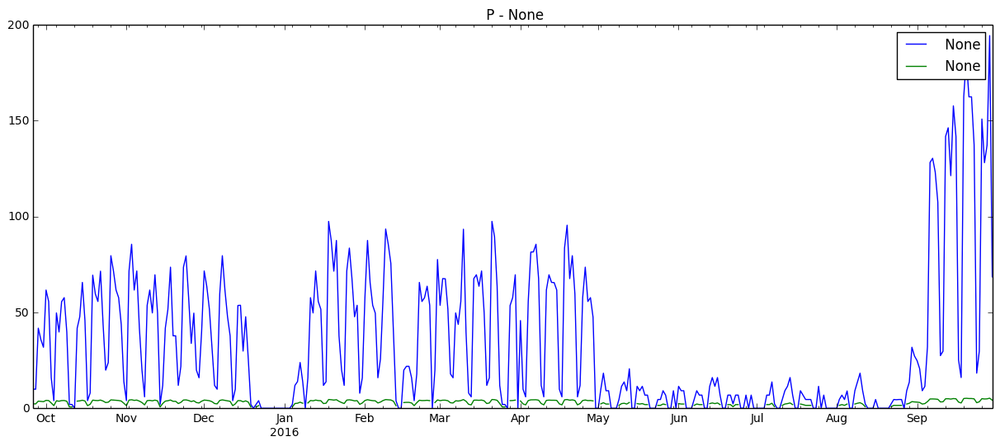

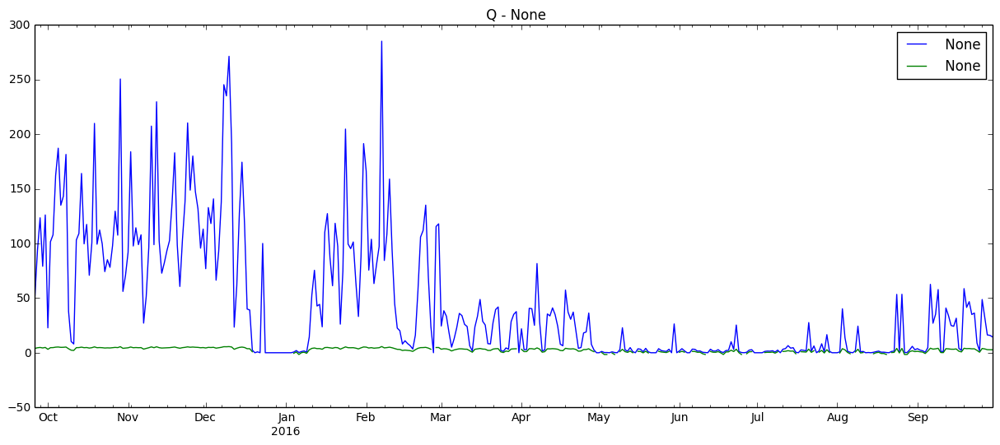

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [116]:
# Let's see the log plot.

map(plot_data, splitted_data, splitted_data_log, data['subCategory'].unique(), ['Log'], ['original'], ['logged'])

In [118]:
# Replace inf, -inf with 0...because after we log(0), we got inf values

replace_inf = lambda x: x.replace([np.inf, -np.inf], 0)
splitted_data_log = map(replace_inf, splitted_data_log)

In [119]:
print splitted_data_log[15]['2015-12-20']
print data['subCategory'].unique()

0.0
['A' 'B' 'C' 'D' 'E' 'F' 'G' 'H' 'I' 'K' 'L' 'M' 'N' 'O' 'P' 'Q']


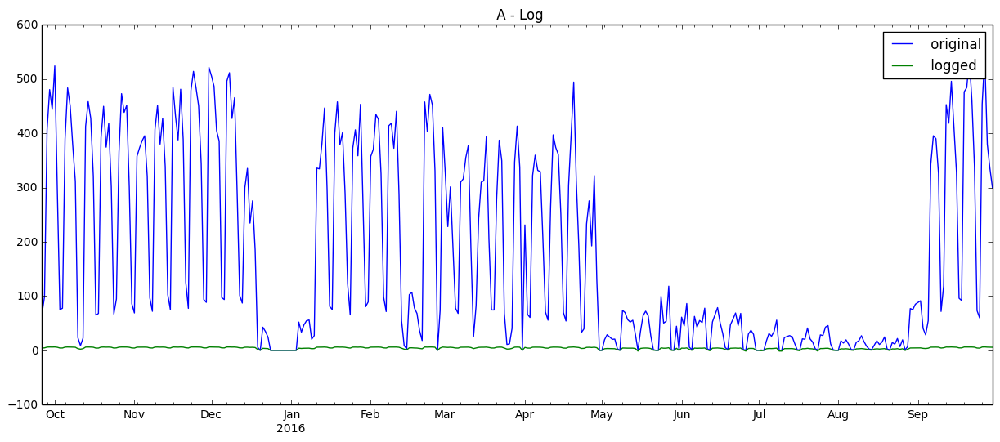

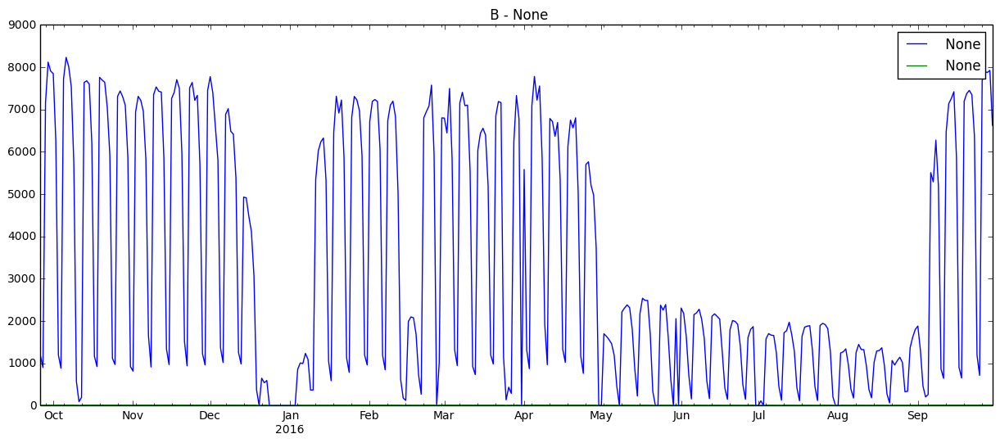

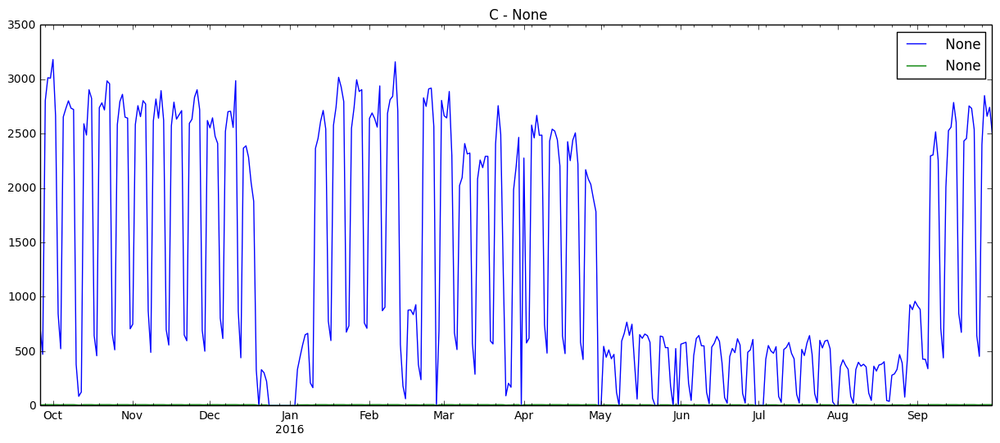

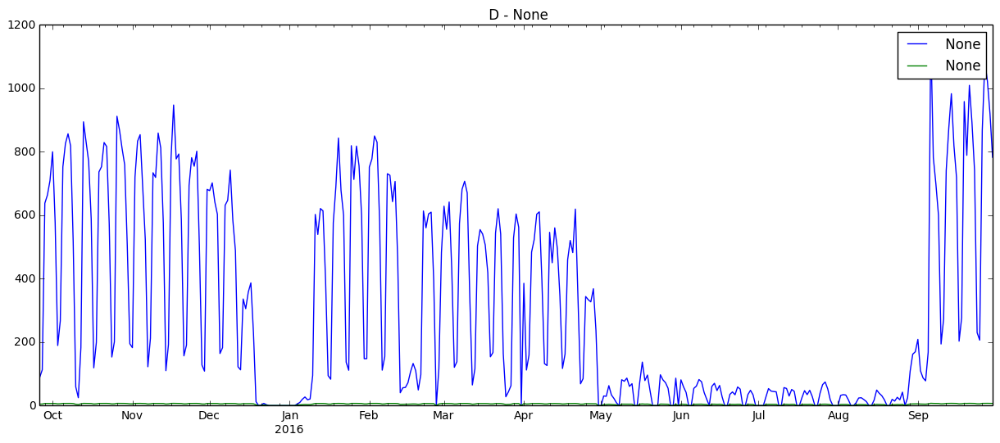

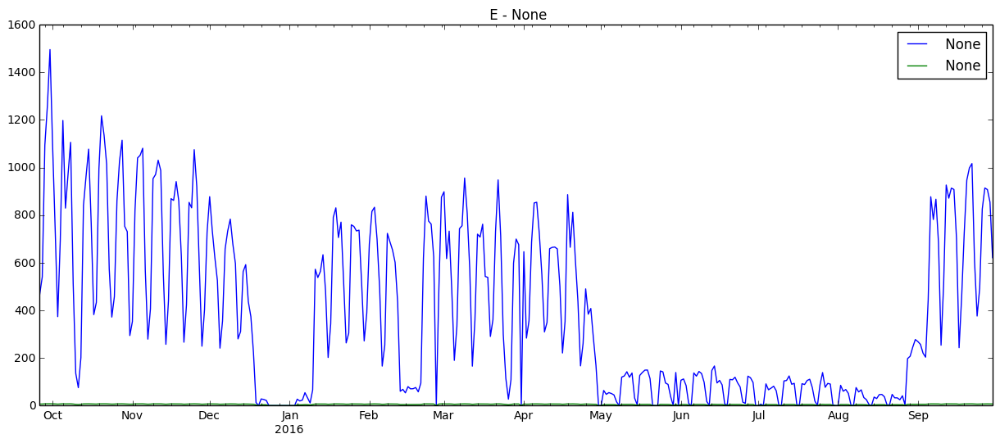

...

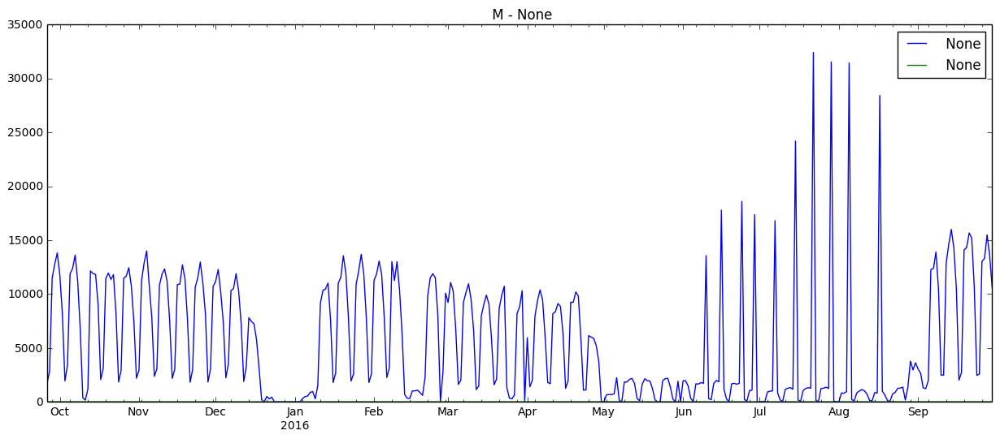

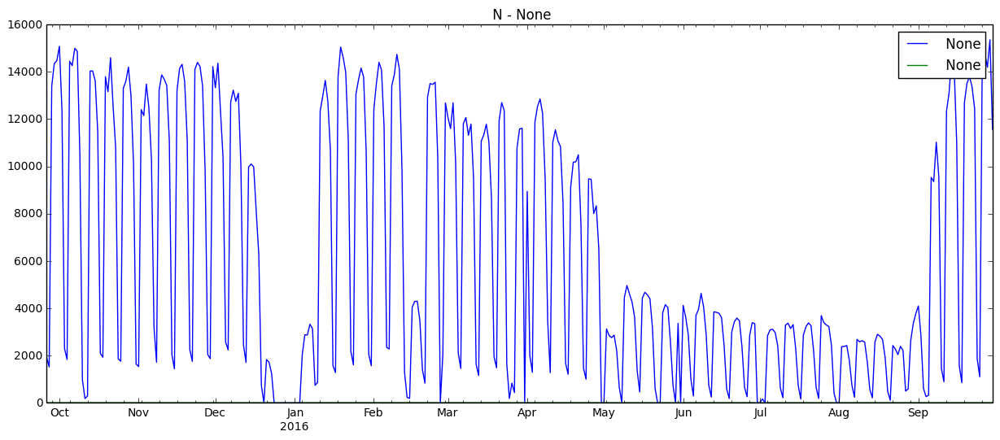

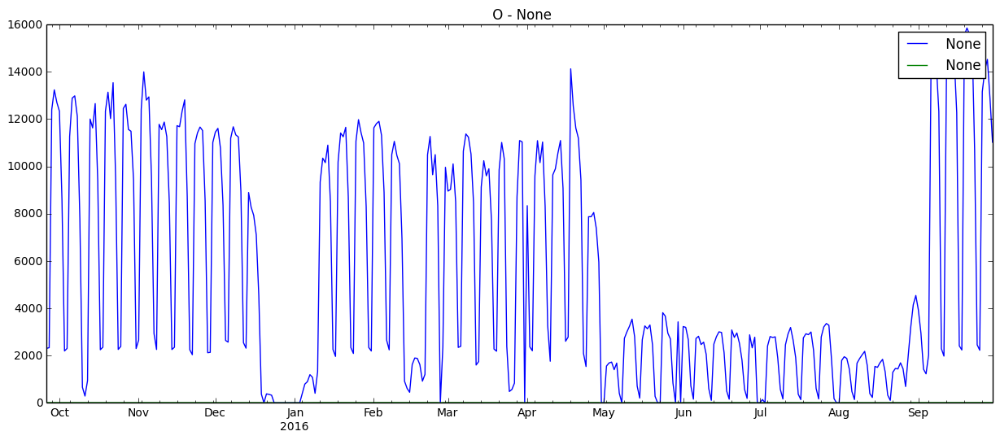

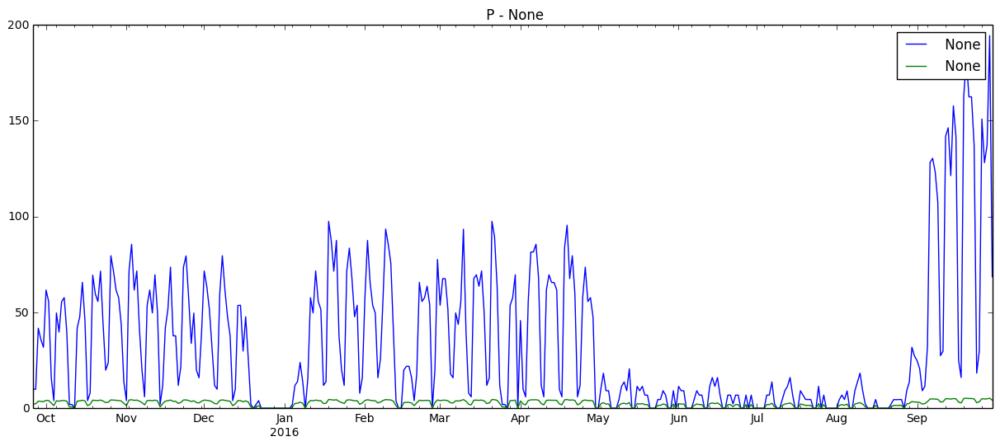

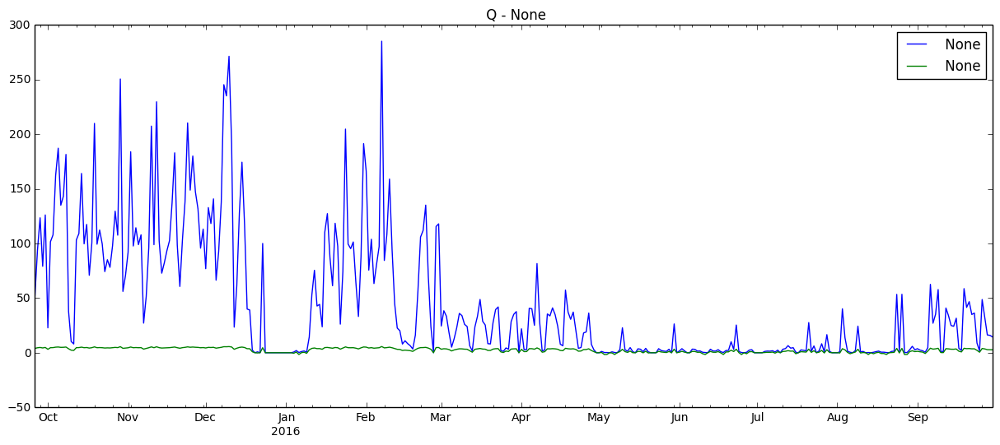

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [120]:
# Plot the log again after we replaced inf, -inf with 0.

map(plot_data, splitted_data, test_log, data['subCategory'].unique(), ['Log'], ['original'], ['logged'])

In [127]:
# Differencing to deal with trend...
# Log first difference

def diff_data(timeseries, item):
    timeseries_diff = timeseries - timeseries.shift()
    return timeseries_diff

splitted_data_log_diff = map(diff_data, test_log, temp_list)

# plt.plot(timeseries_diff, label='diff')
# plt.plot(timeseries.shift(), label='shift')
# plt.plot(timeseries, label='original')
# plt.legend(loc='best')
# plt.title('{}- First Diff'.format(item))
# plt.show(block=False)

In [124]:
print splitted_data_log_diff[0].head()

2015-09-26         NaN
2015-09-27    0.396809
2015-09-28    1.412017
2015-09-29    0.168415
2015-09-30   -0.078987
Freq: D, Name: sales, dtype: float64


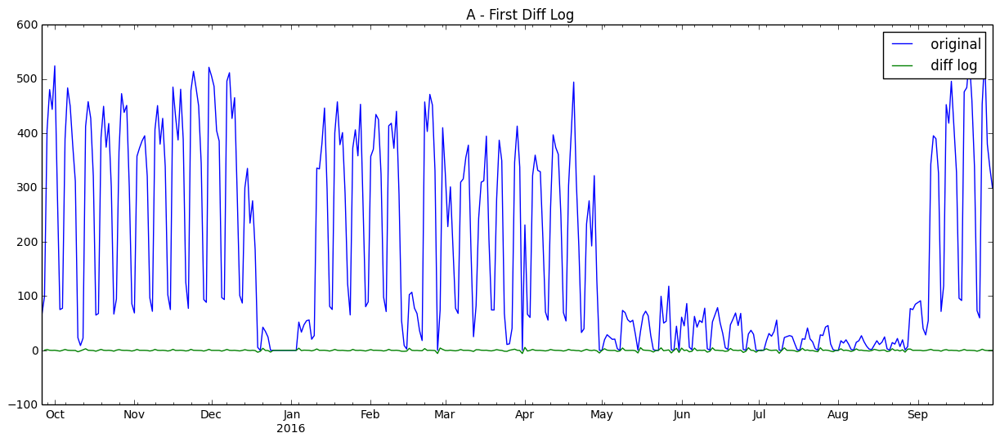

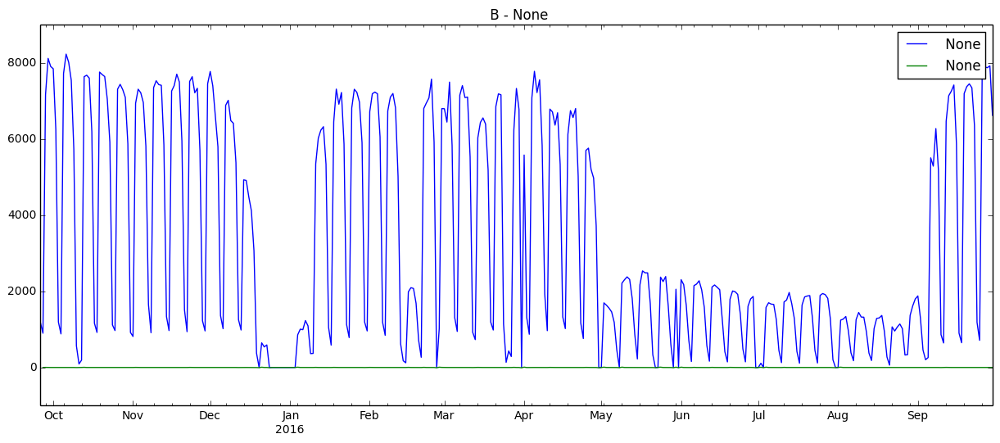

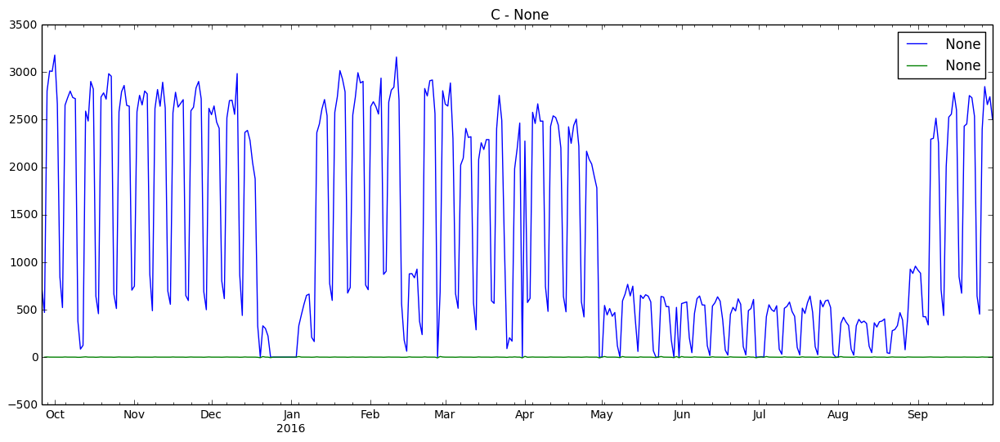

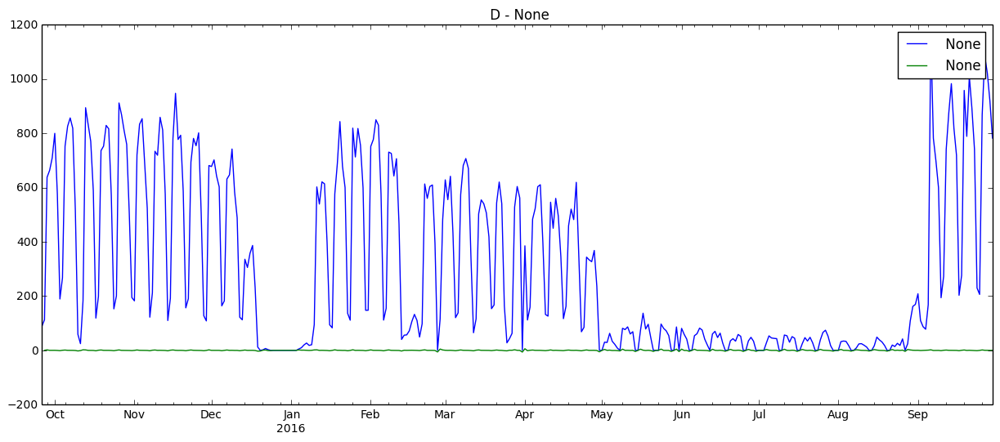

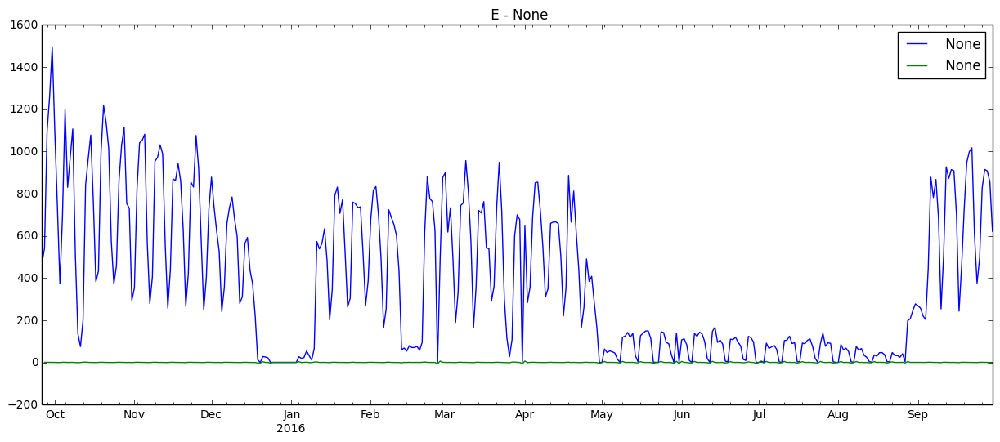

...

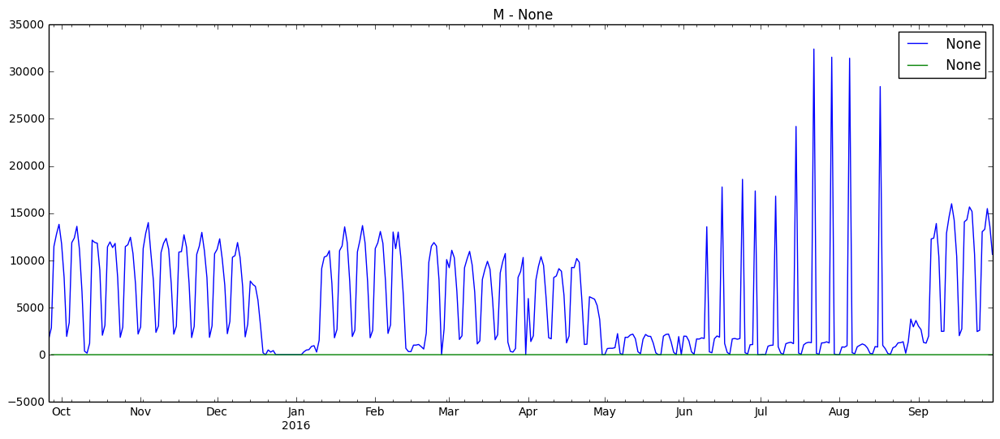

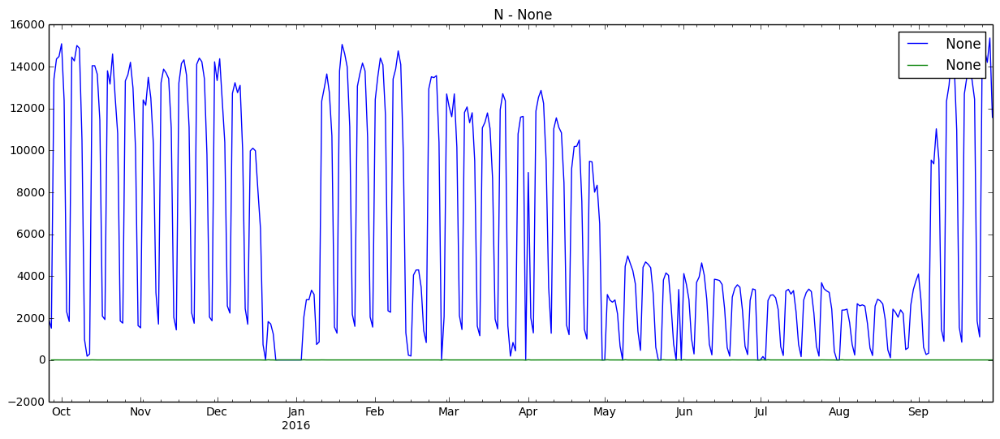

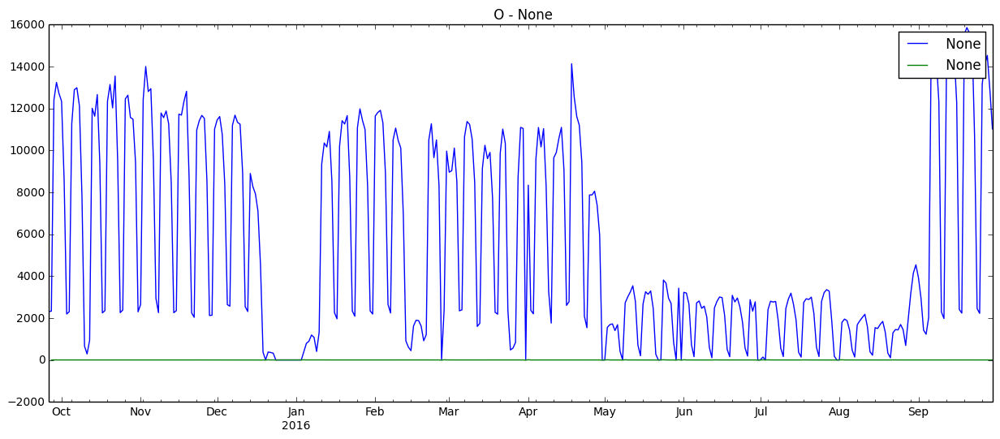

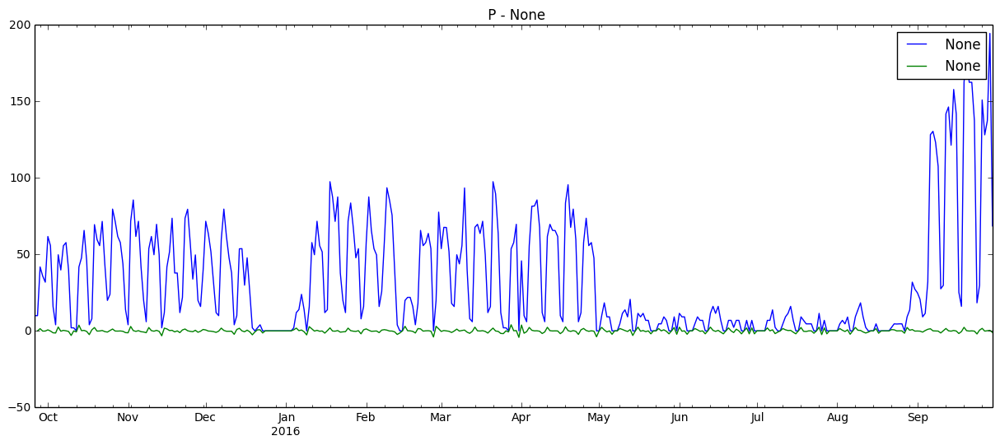

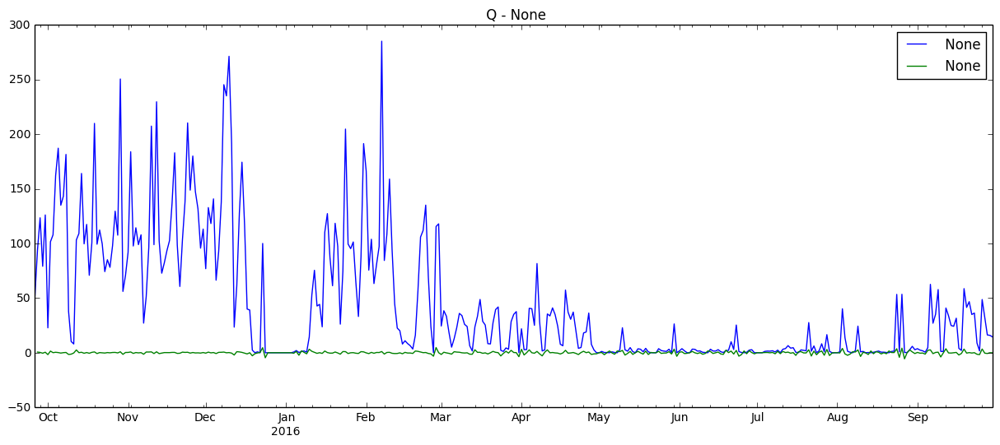

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [129]:
map(plot_data, splitted_data, splitted_data_log_diff, temp_list, ['First Diff Log'], ['original'], ['diff log'])

In [130]:
map(lambda x: x.dropna(inplace=True), splitted_data_log_diff)

# TODO: May not be necessary...
# Category A, seasonal decomposition plots...
# decomposition_diff = seasonal_decompose(temp_A_diff, freq=30)
# fig = plt.figure()
# fig = decomposition_diff.plot()
# fig.set_size_inches(15, 8)
# fig.suptitle('A - First Diff')

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


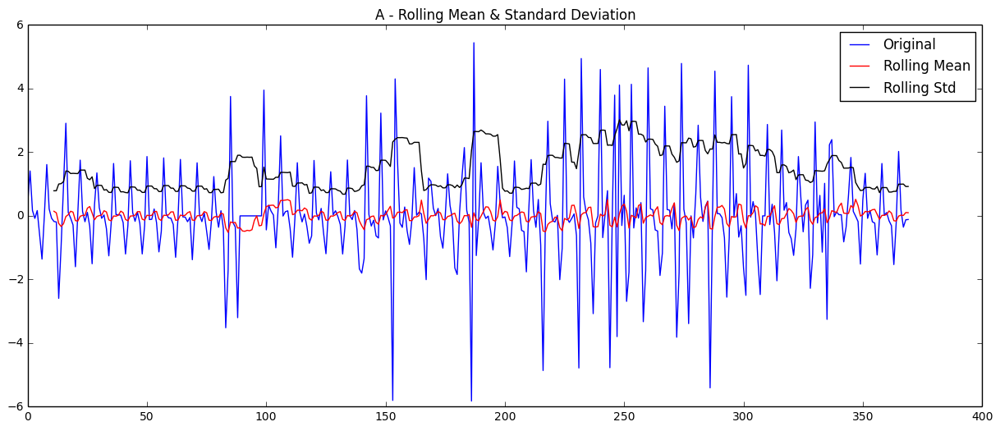

Results of Dickey-Fuller Test:
Test Statistic                -5.867731e+00
p-value                        3.295171e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


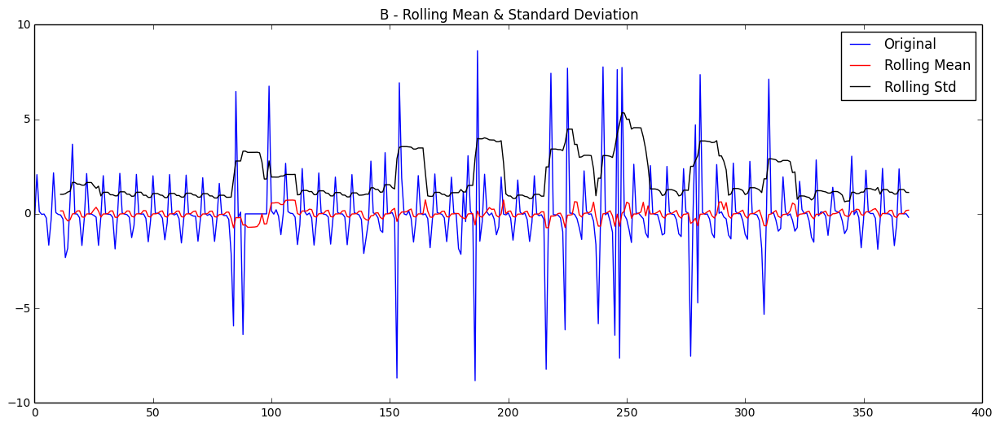

Results of Dickey-Fuller Test:
Test Statistic                -6.379569e+00
p-value                        2.239677e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


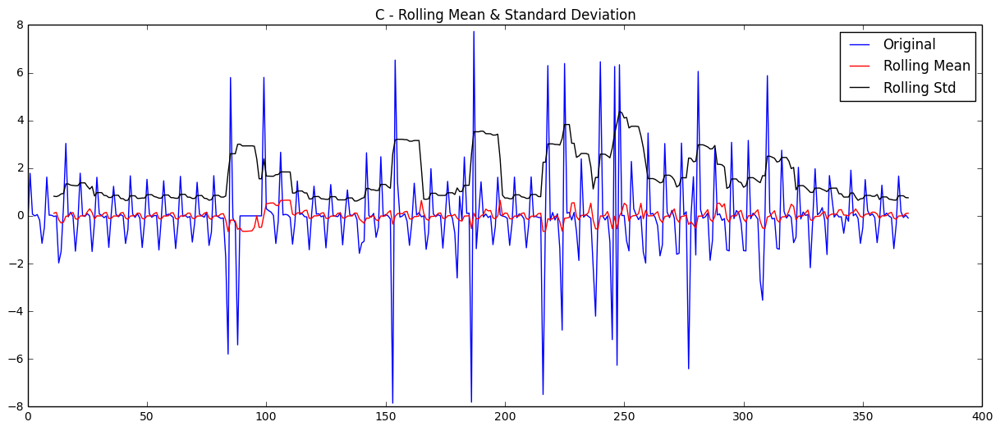

Results of Dickey-Fuller Test:
Test Statistic                -6.283016e+00
p-value                        3.756192e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


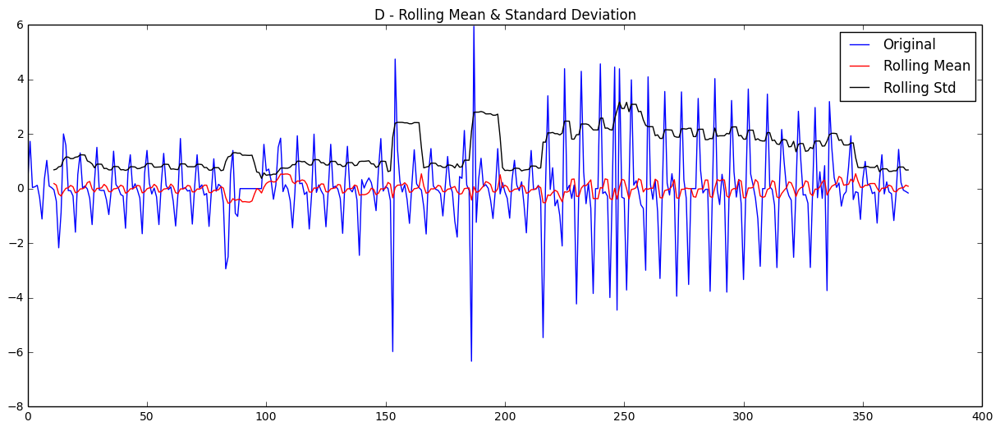

Results of Dickey-Fuller Test:
Test Statistic                  -4.358665
p-value                          0.000351
#Lags Used                      14.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


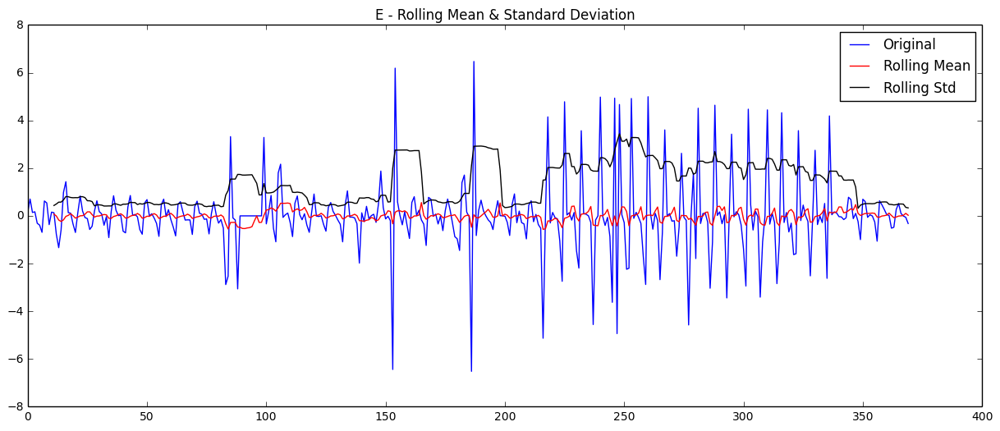

Results of Dickey-Fuller Test:
Test Statistic                  -5.491730
p-value                          0.000002
#Lags Used                      13.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


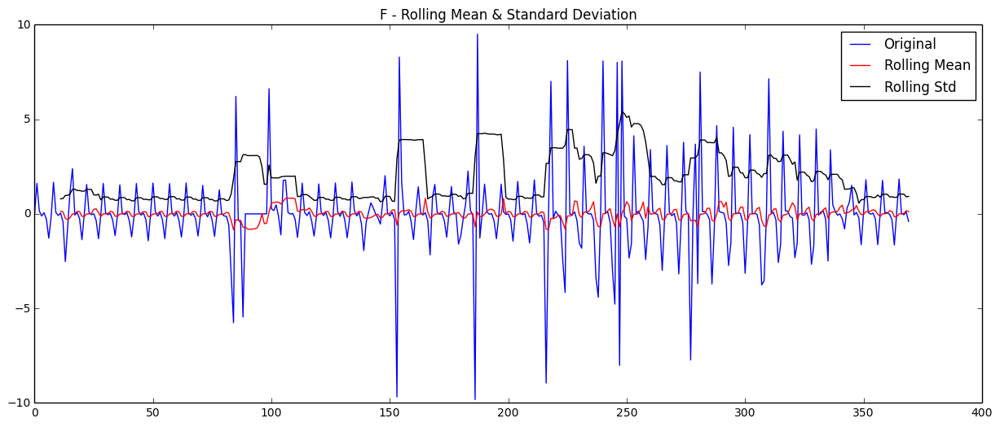

Results of Dickey-Fuller Test:
Test Statistic                -5.973994e+00
p-value                        1.906609e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


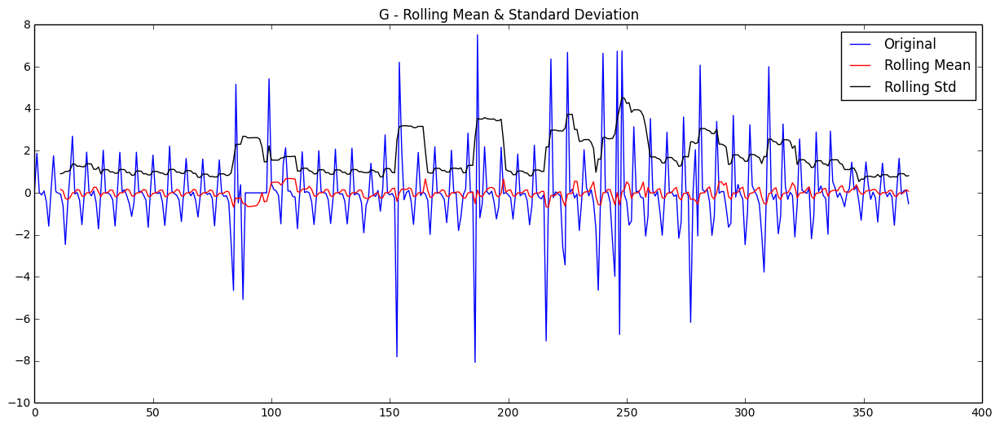

Results of Dickey-Fuller Test:
Test Statistic                -6.126546e+00
p-value                        8.601670e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


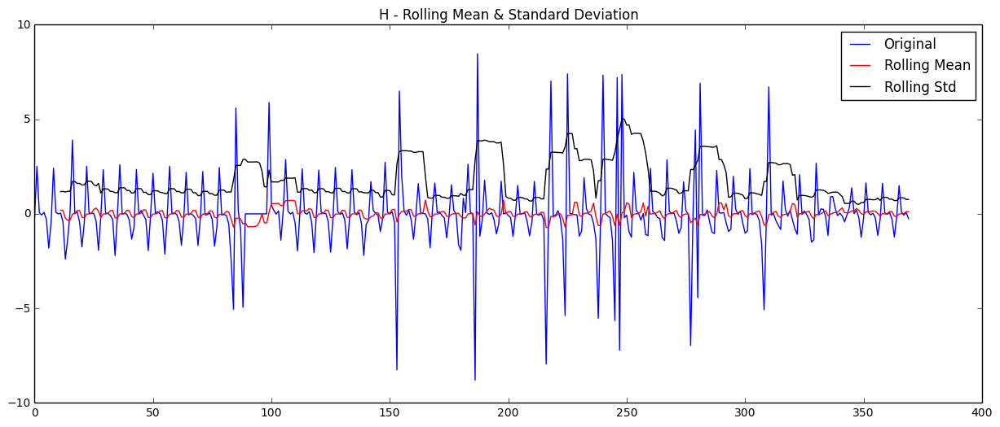

Results of Dickey-Fuller Test:
Test Statistic                -6.236673e+00
p-value                        4.806850e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


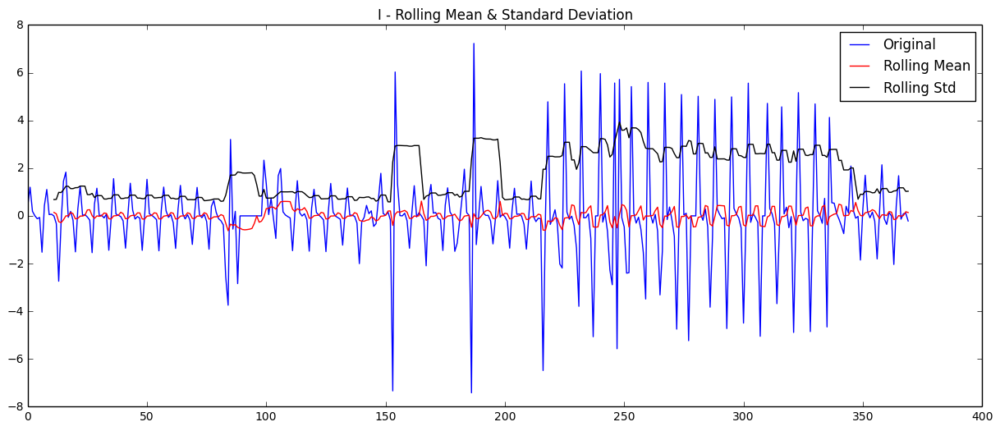

Results of Dickey-Fuller Test:
Test Statistic                  -5.512843
p-value                          0.000002
#Lags Used                      13.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


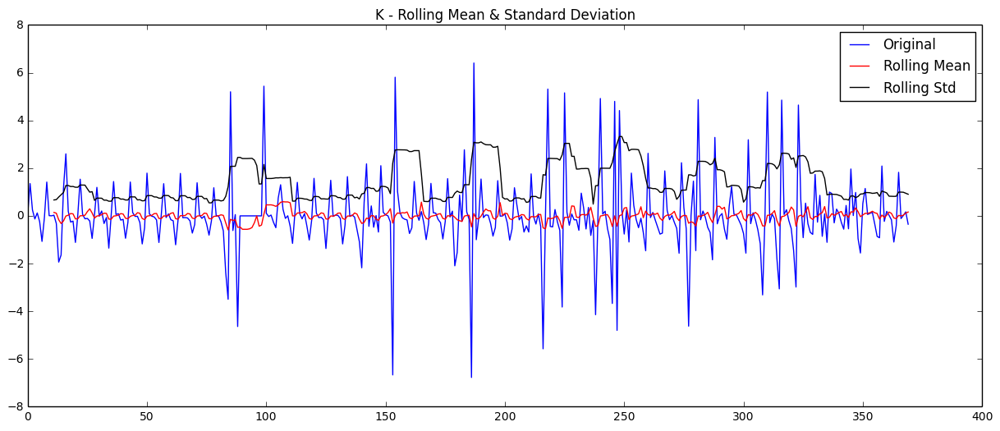

Results of Dickey-Fuller Test:
Test Statistic                -5.994589e+00
p-value                        1.713572e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


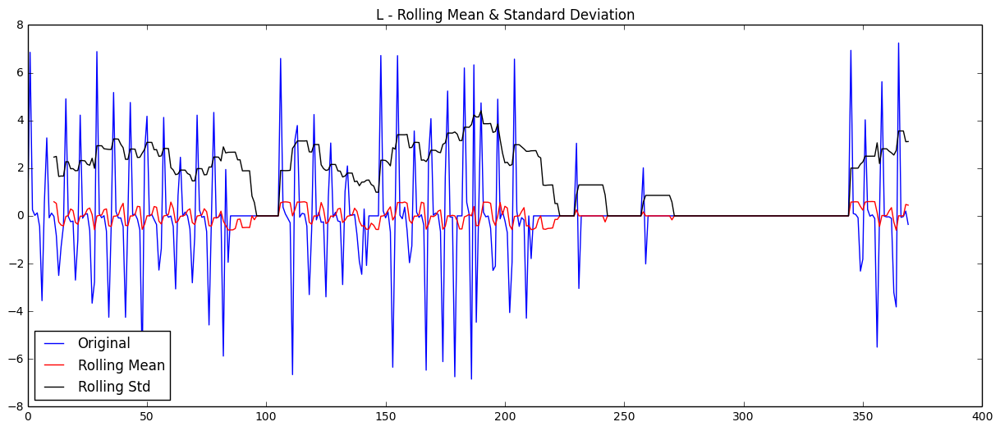

Results of Dickey-Fuller Test:
Test Statistic                -5.757345e+00
p-value                        5.778576e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


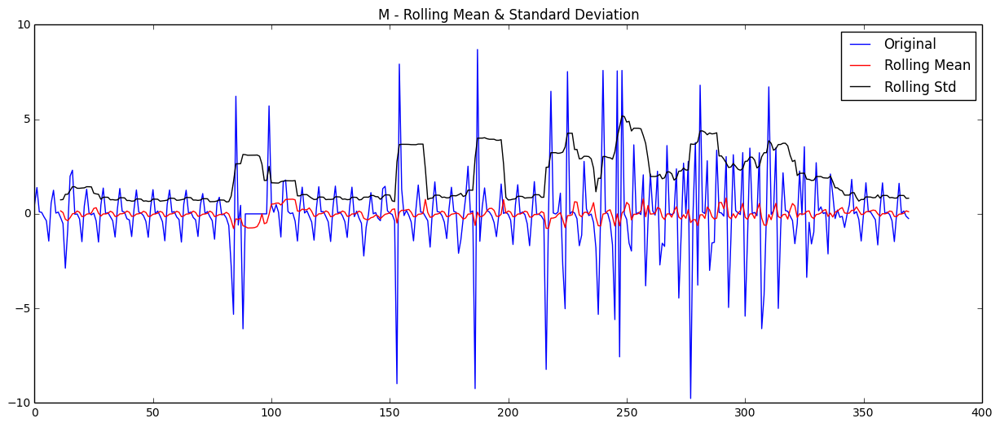

Results of Dickey-Fuller Test:
Test Statistic                -5.875896e+00
p-value                        3.160216e-07
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


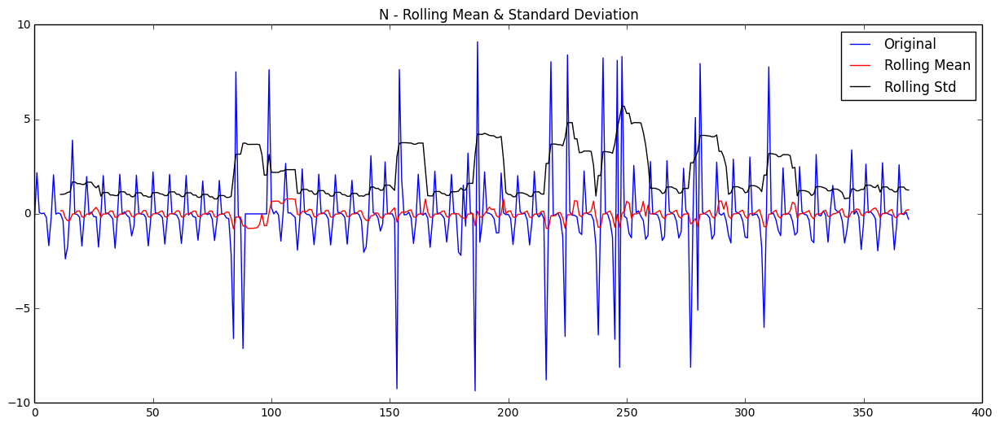

Results of Dickey-Fuller Test:
Test Statistic                -6.529351e+00
p-value                        9.959692e-09
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


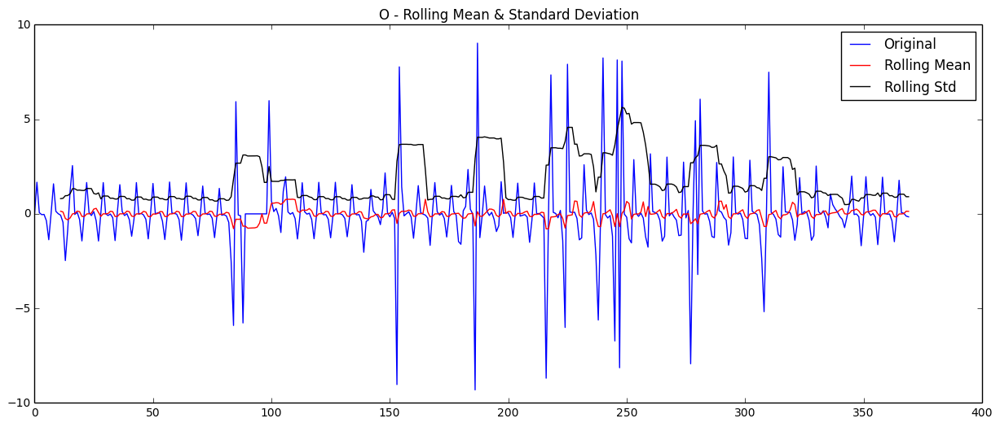

Results of Dickey-Fuller Test:
Test Statistic                -6.117129e+00
p-value                        9.037992e-08
#Lags Used                     1.300000e+01
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


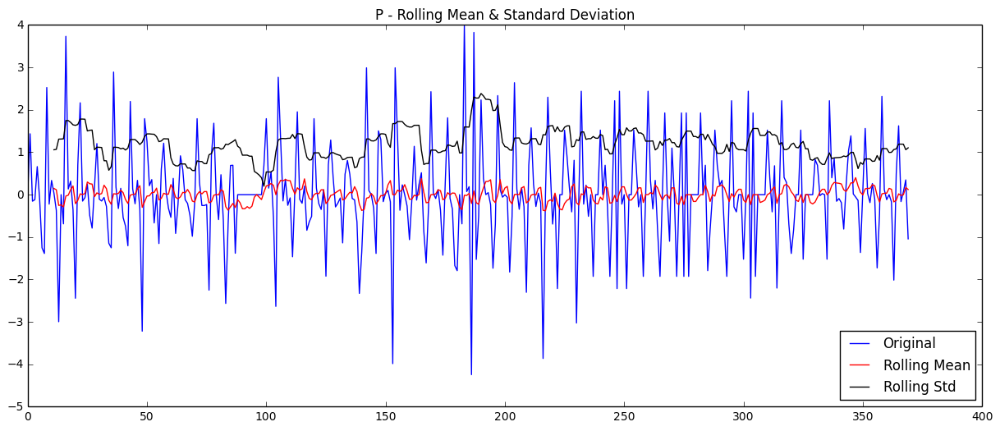

Results of Dickey-Fuller Test:
Test Statistic                  -5.592441
p-value                          0.000001
#Lags Used                      14.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


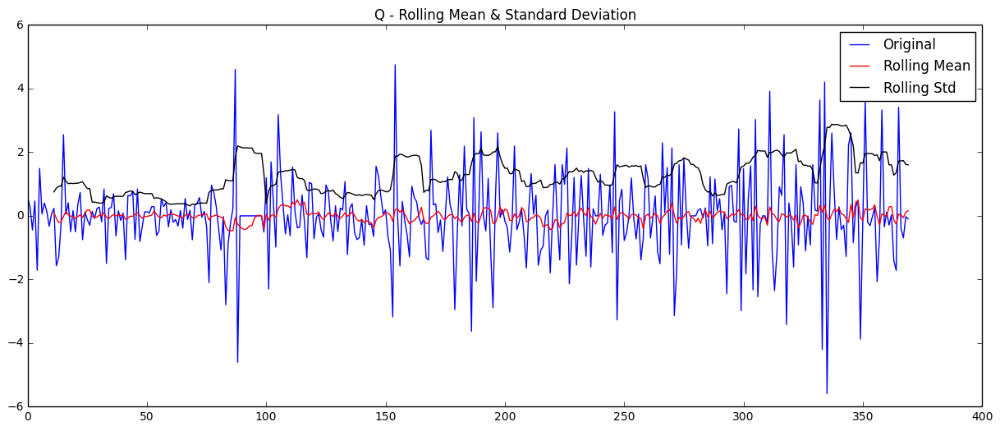

Results of Dickey-Fuller Test:
Test Statistic                  -5.386274
p-value                          0.000004
#Lags Used                      14.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [131]:
# Let's see the Dickey-Fuller test after taking the diff(1)...
map(test_stationarity, splitted_data_log_diff, temp_list)

### - Looks good! Mostly becomes stationary...
### - Now let's deal with seasonality

In [135]:
# Differencing to deal with seasonality...
# Log seasonal difference

splitted_data_log_diff_season = map(lambda x: x - x.shift(7), splitted_data_log_diff)
map(lambda x: x.dropna(inplace=True), splitted_data_log_diff_season)

# TODO: May not be necessary...
# plt.plot(temp_A_season, label='seasonal diff')
# plt.plot(temp_A_log.shift(30), label='shift')
# plt.plot(temp_A, label='original')
# plt.legend(loc='best')
# plt.title('A - Season')

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


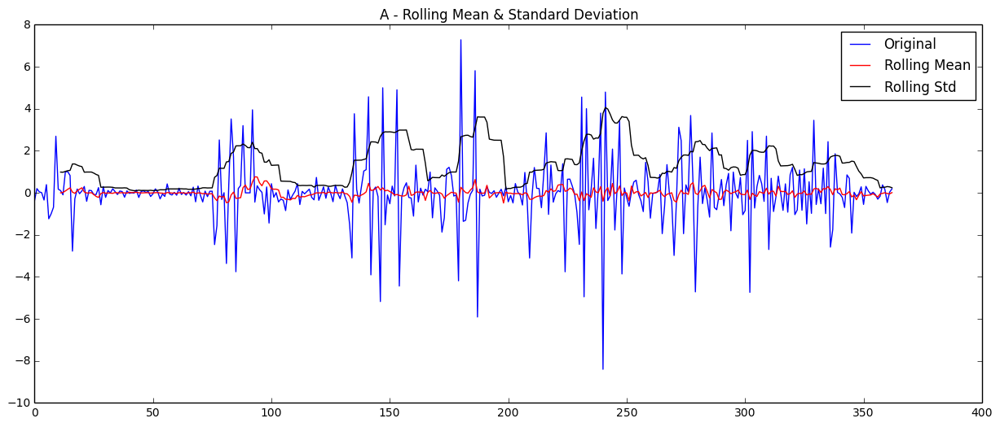

Results of Dickey-Fuller Test:
Test Statistic                -7.089922e+00
p-value                        4.437585e-10
#Lags Used                     1.700000e+01
Number of Observations Used    3.450000e+02
Critical Value (5%)           -2.869954e+00
Critical Value (1%)           -3.449447e+00
Critical Value (10%)          -2.571253e+00
dtype: float64


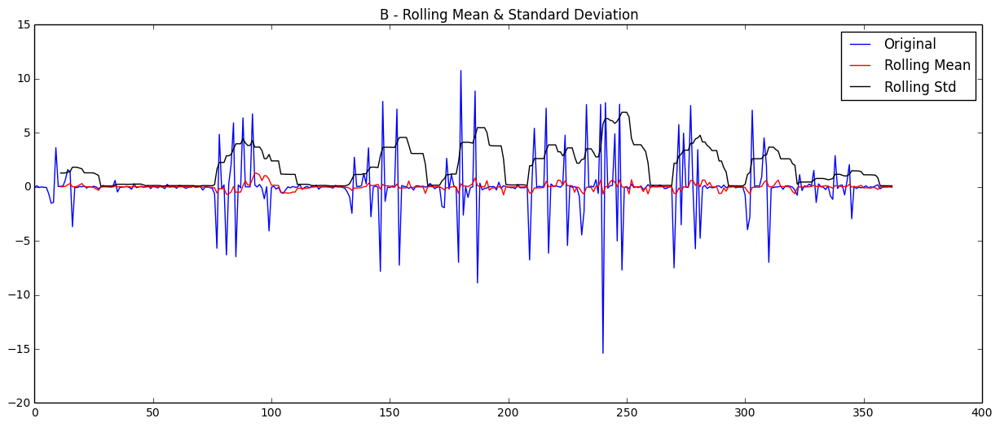

Results of Dickey-Fuller Test:
Test Statistic                -7.858329e+00
p-value                        5.367554e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


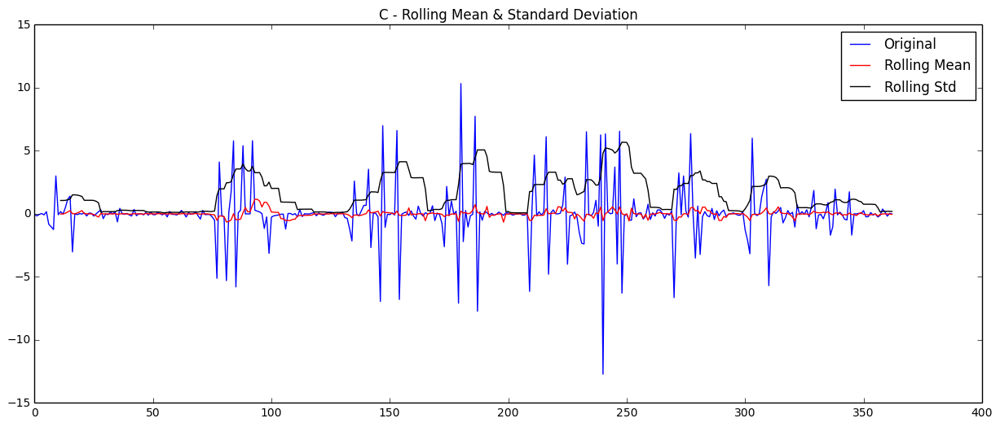

Results of Dickey-Fuller Test:
Test Statistic                -7.946767e+00
p-value                        3.204447e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


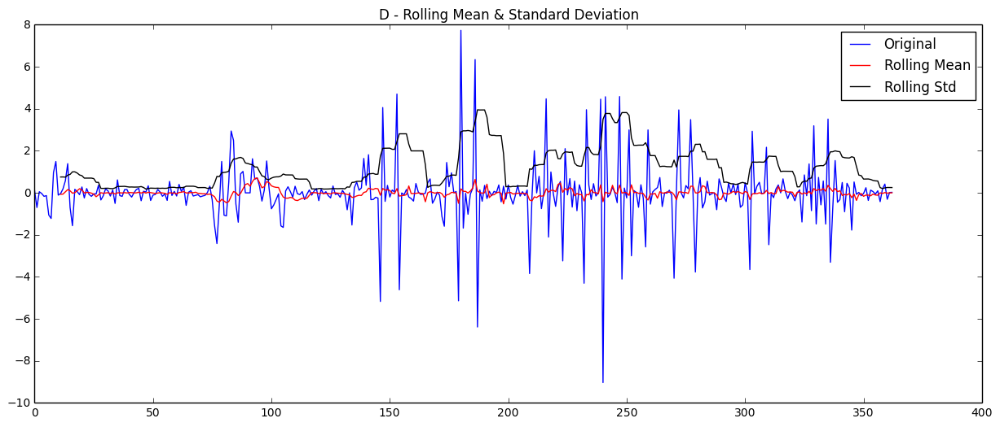

Results of Dickey-Fuller Test:
Test Statistic                -6.592978e+00
p-value                        7.038593e-09
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


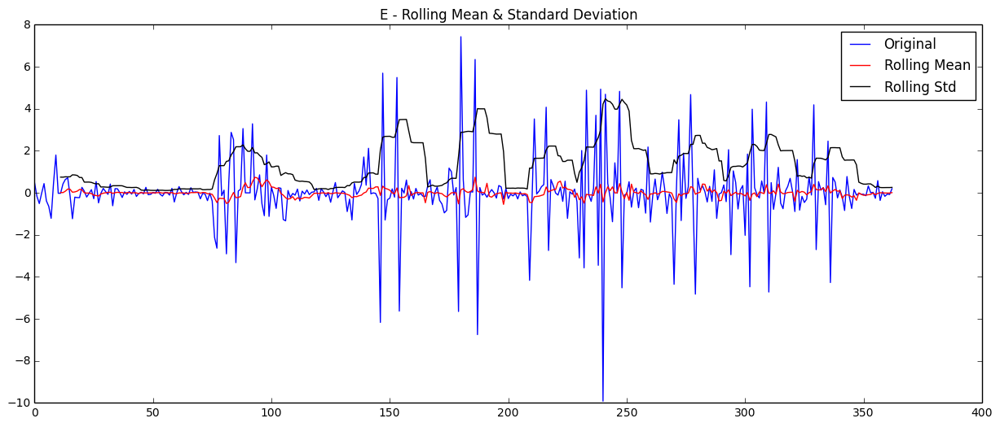

Results of Dickey-Fuller Test:
Test Statistic                -6.928629e+00
p-value                        1.098679e-09
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


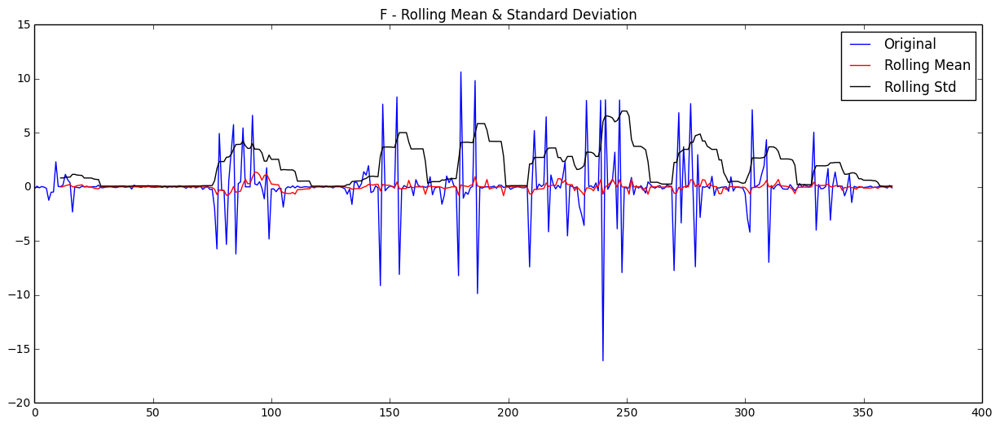

Results of Dickey-Fuller Test:
Test Statistic                -7.702990e+00
p-value                        1.324068e-11
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


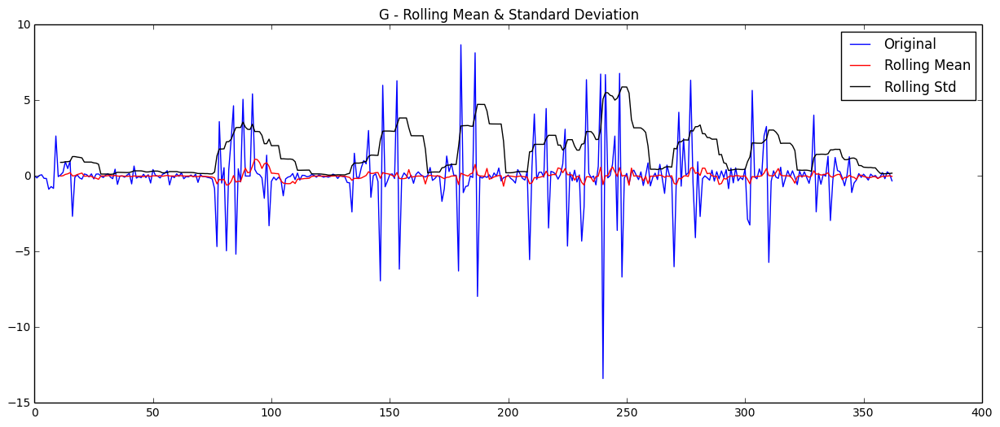

Results of Dickey-Fuller Test:
Test Statistic                -7.636023e+00
p-value                        1.951488e-11
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


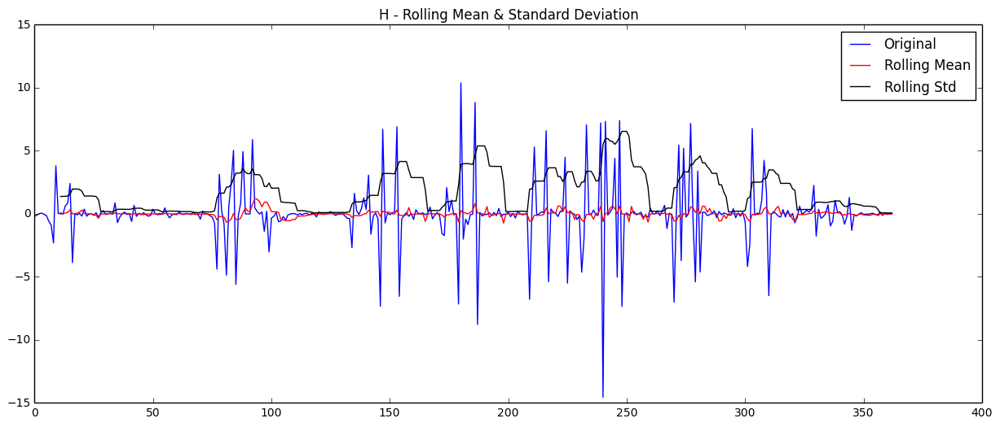

Results of Dickey-Fuller Test:
Test Statistic                -7.875851e+00
p-value                        4.846561e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


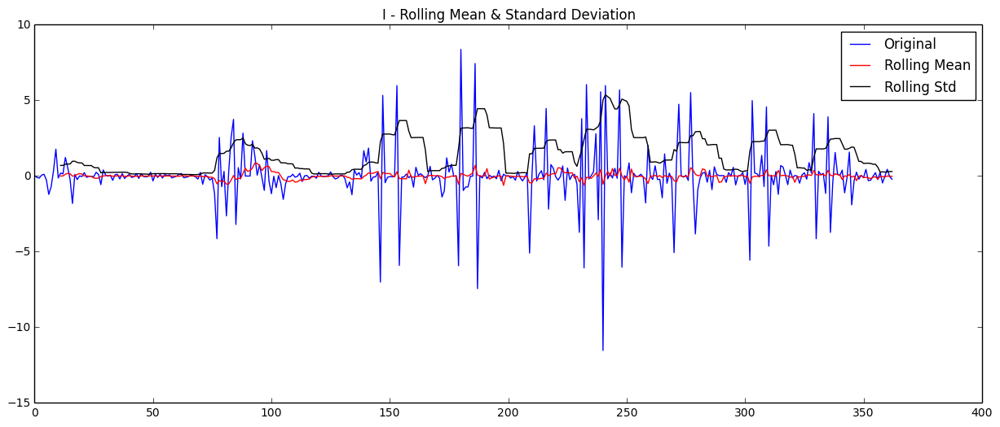

Results of Dickey-Fuller Test:
Test Statistic                -7.034861e+00
p-value                        6.052888e-10
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


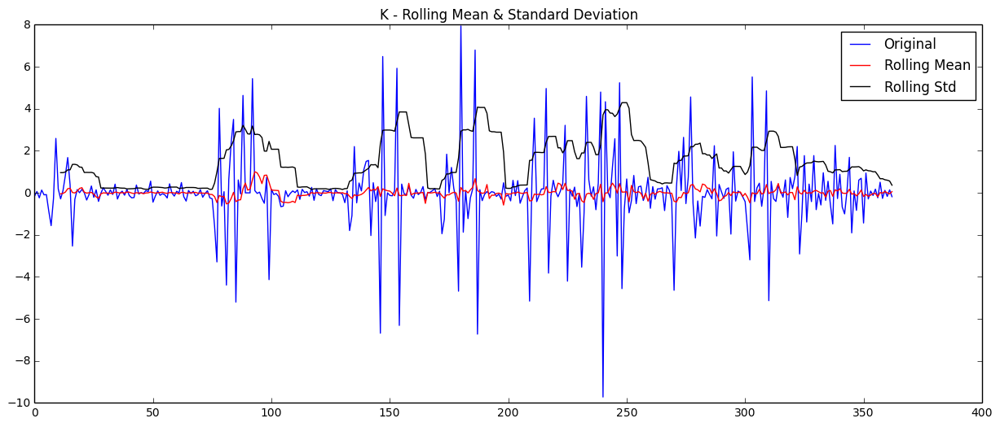

Results of Dickey-Fuller Test:
Test Statistic                -8.006229e+00
p-value                        2.263876e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


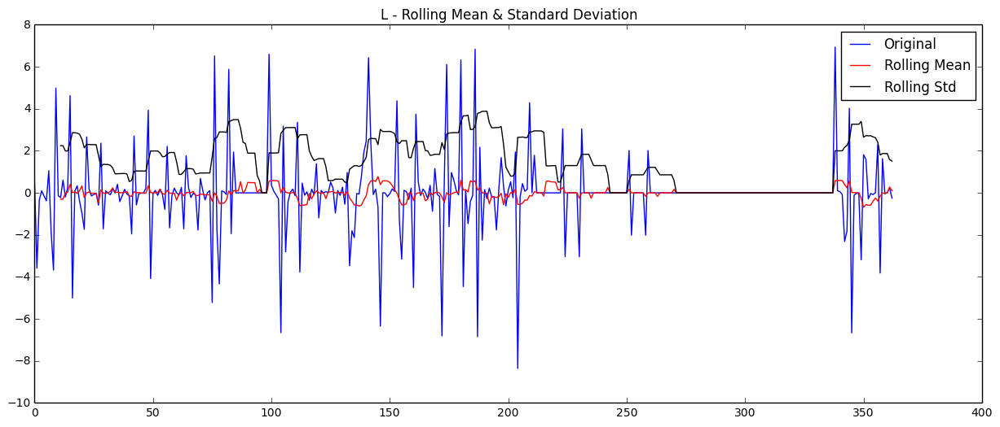

Results of Dickey-Fuller Test:
Test Statistic                -5.982565e+00
p-value                        1.823813e-07
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


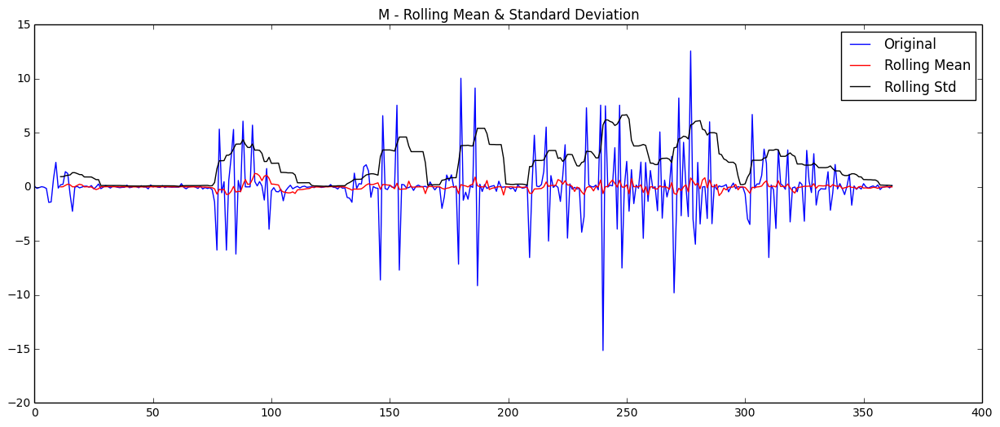

Results of Dickey-Fuller Test:
Test Statistic                -7.669657e+00
p-value                        1.606231e-11
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


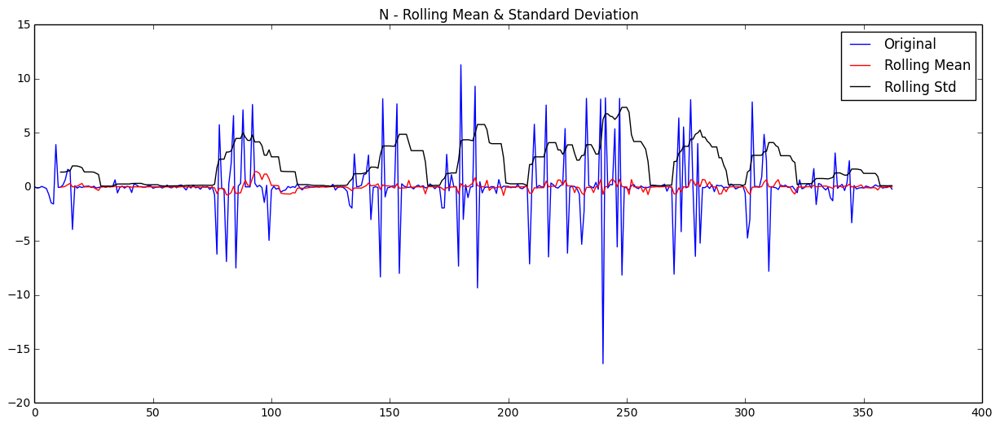

Results of Dickey-Fuller Test:
Test Statistic                -7.987777e+00
p-value                        2.521748e-12
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


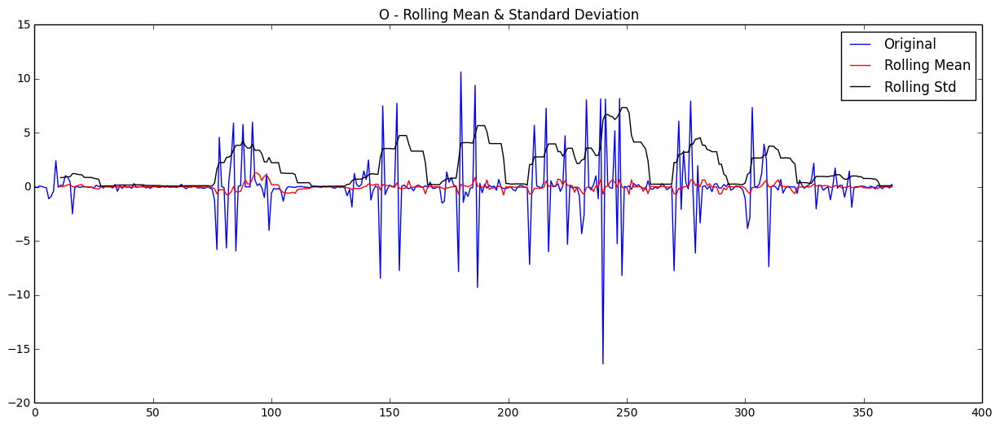

Results of Dickey-Fuller Test:
Test Statistic                -7.668630e+00
p-value                        1.615808e-11
#Lags Used                     1.600000e+01
Number of Observations Used    3.460000e+02
Critical Value (5%)           -2.869930e+00
Critical Value (1%)           -3.449392e+00
Critical Value (10%)          -2.571240e+00
dtype: float64


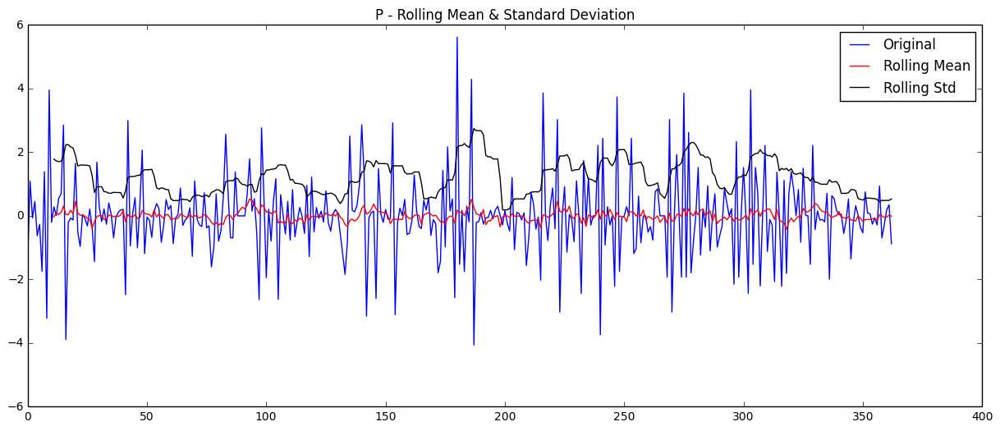

Results of Dickey-Fuller Test:
Test Statistic                -8.012994e+00
p-value                        2.176062e-12
#Lags Used                     1.500000e+01
Number of Observations Used    3.470000e+02
Critical Value (5%)           -2.869906e+00
Critical Value (1%)           -3.449337e+00
Critical Value (10%)          -2.571227e+00
dtype: float64


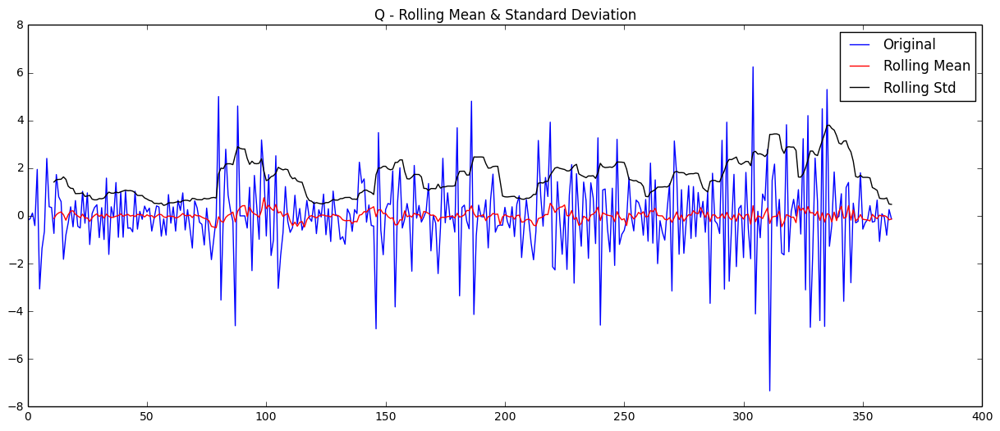

Results of Dickey-Fuller Test:
Test Statistic                -8.186785e+00
p-value                        7.860575e-13
#Lags Used                     1.400000e+01
Number of Observations Used    3.480000e+02
Critical Value (5%)           -2.869881e+00
Critical Value (1%)           -3.449282e+00
Critical Value (10%)          -2.571214e+00
dtype: float64


[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [136]:
# Let's see the Dickey-Fuller test after taking the log, diff, & season diff...
map(test_stationarity, splitted_data_log_diff_season, temp_list)

In [144]:
def acf_pacf_plot(timeseries, title, item, lags=30):
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(timeseries, lags=lags, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(timeseries, lags=lags, ax=ax2)
    fig.suptitle('Category {} - {} ACF/PACF Plot'.format(item, title), fontsize=20)

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

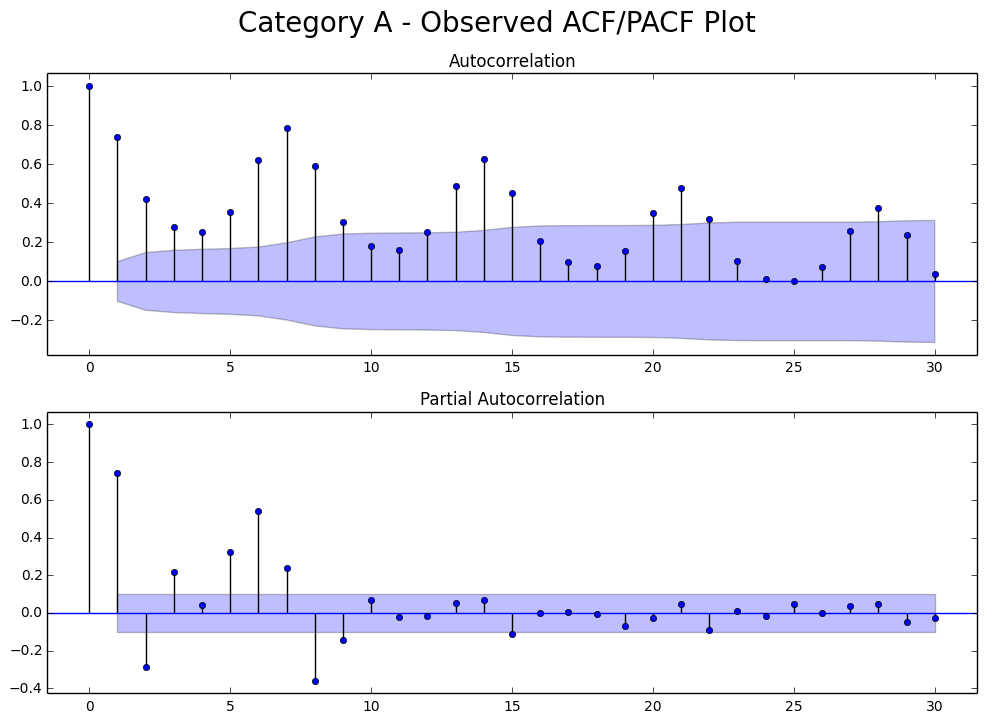

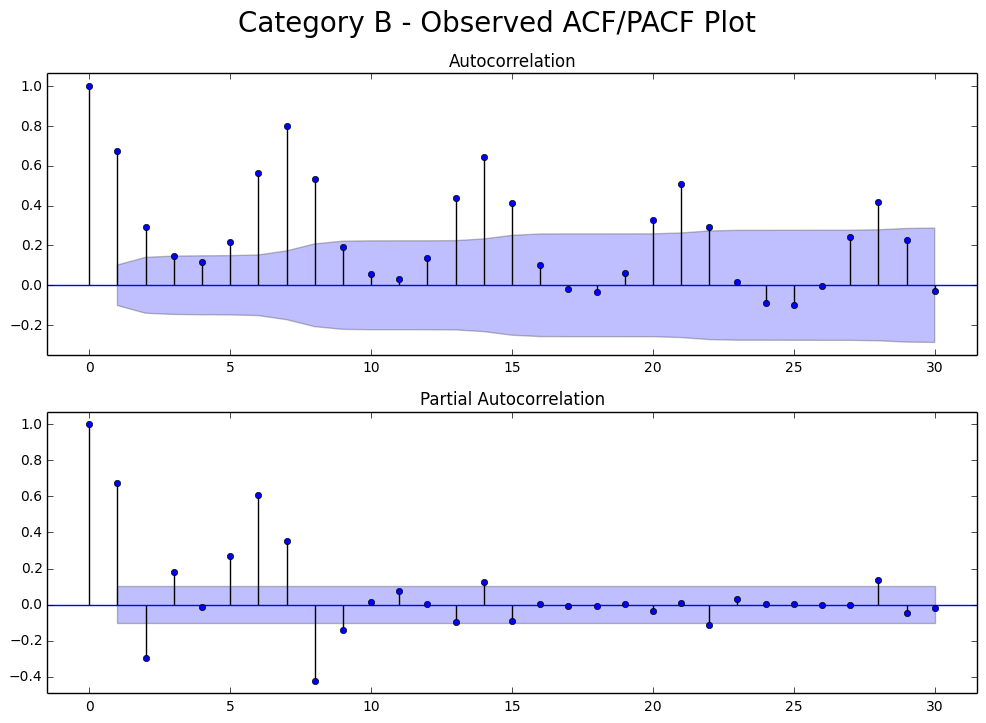

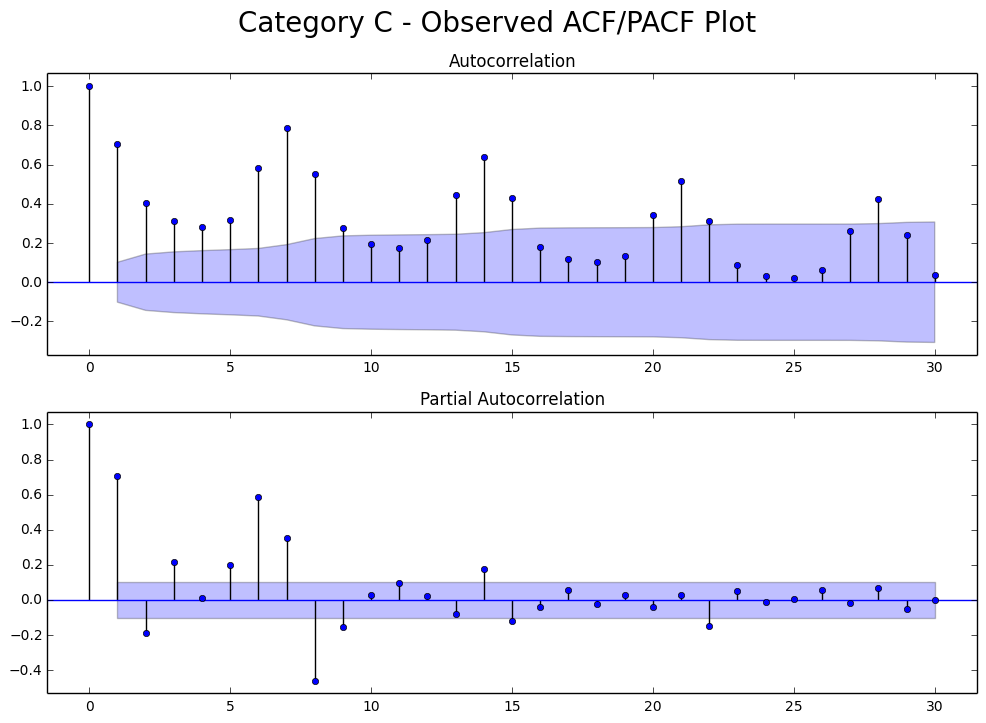

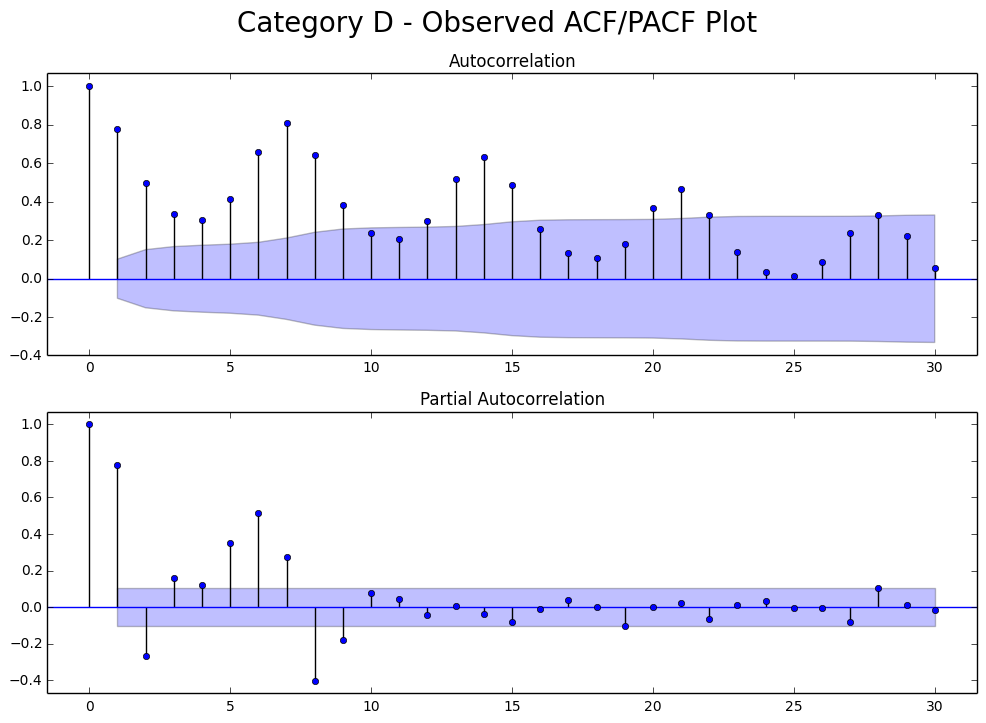

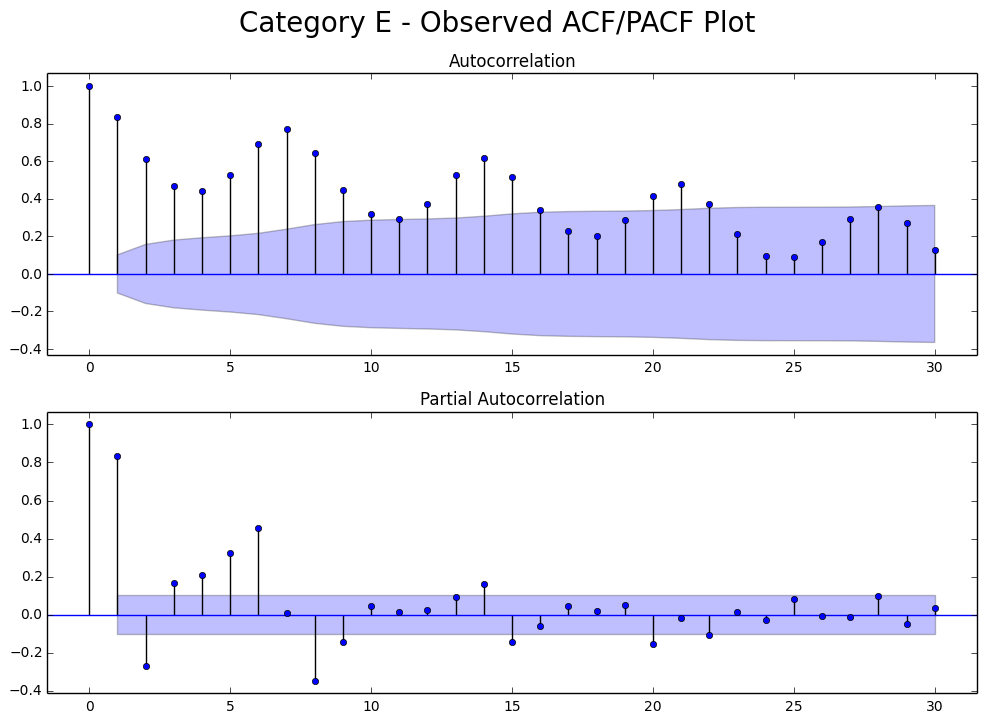

...

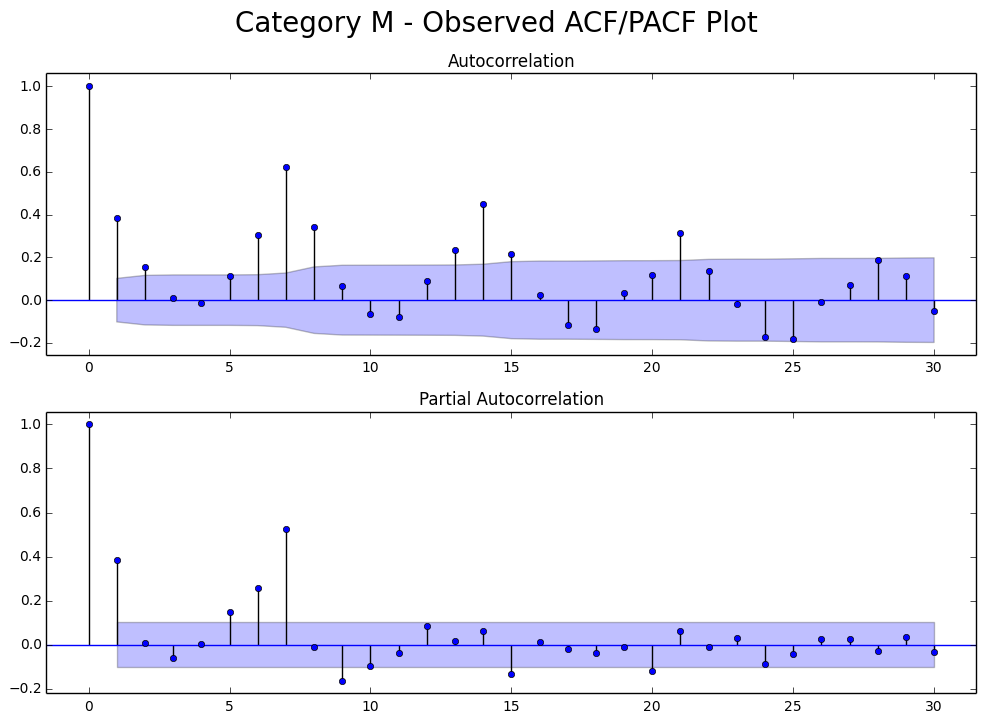

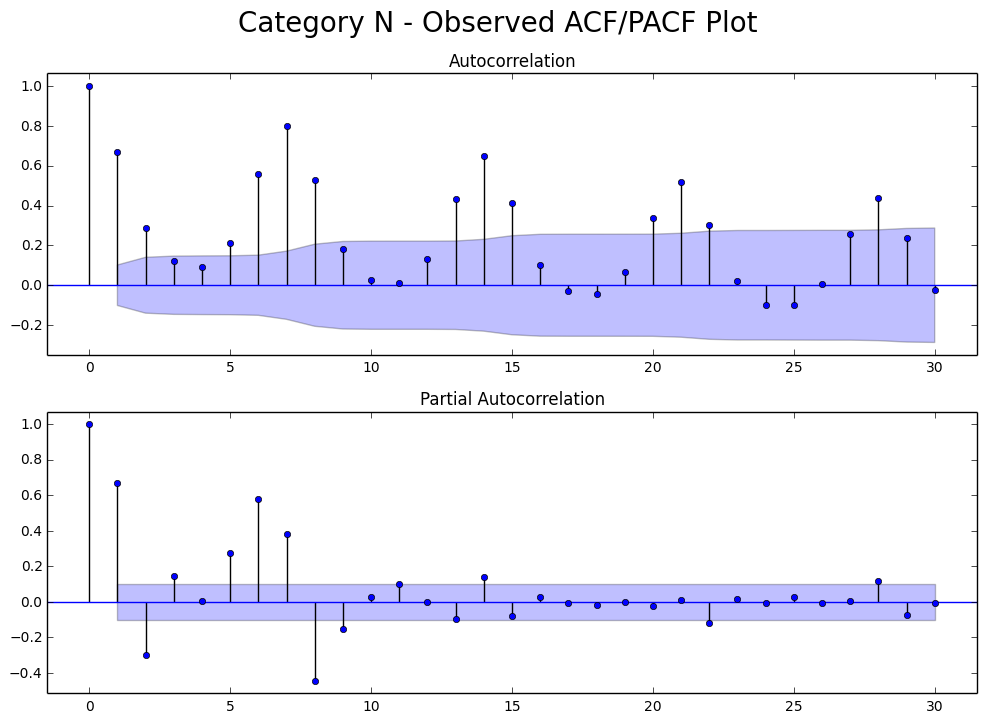

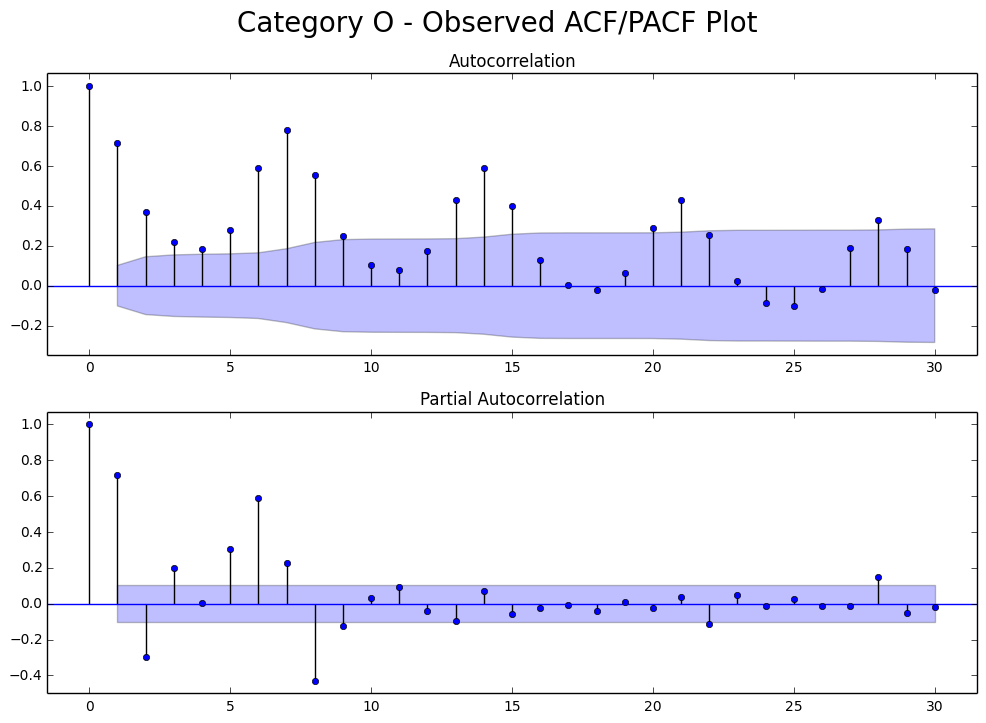

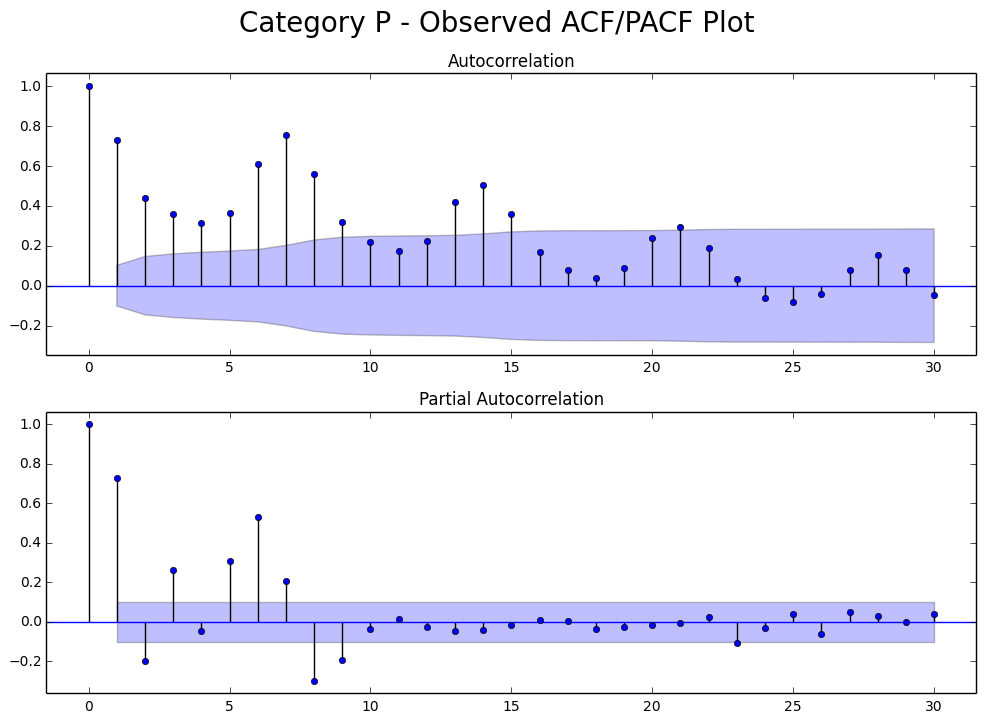

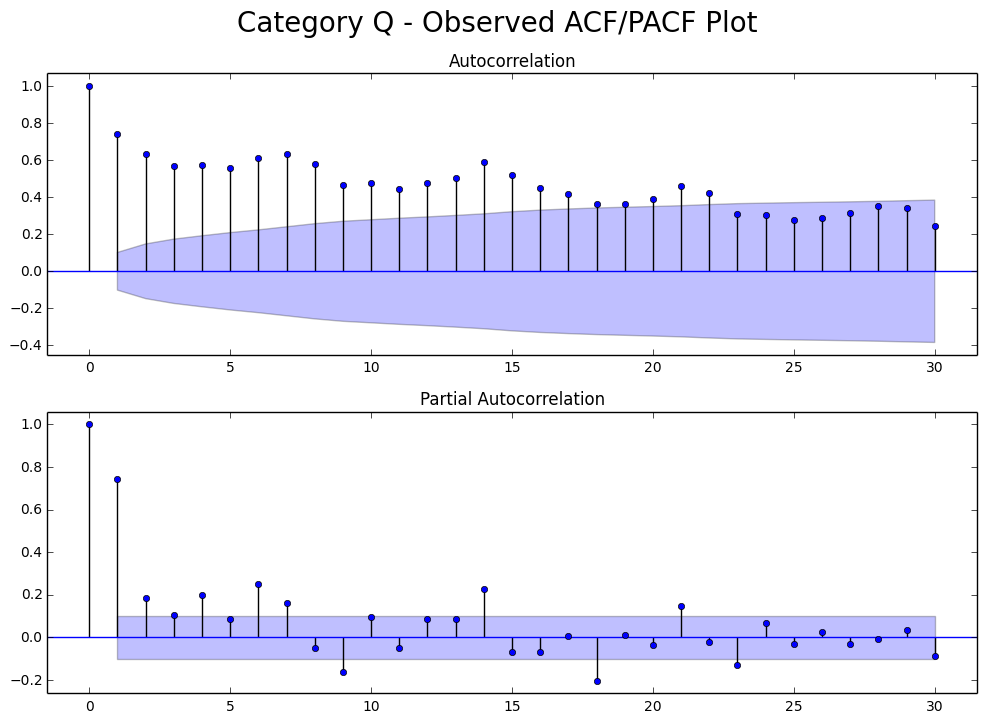

In [139]:
# Observed ACF/PACF plot.

map(acf_pacf_plot, splitted_data, ['Observed']*16, temp_list)

### A) Both tails off
### B), C), D), E), F), G), H), I), K), L), M), N), O), P) Both tails off
### Q) PACF cuts off at 1, probably AR(1) model...

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

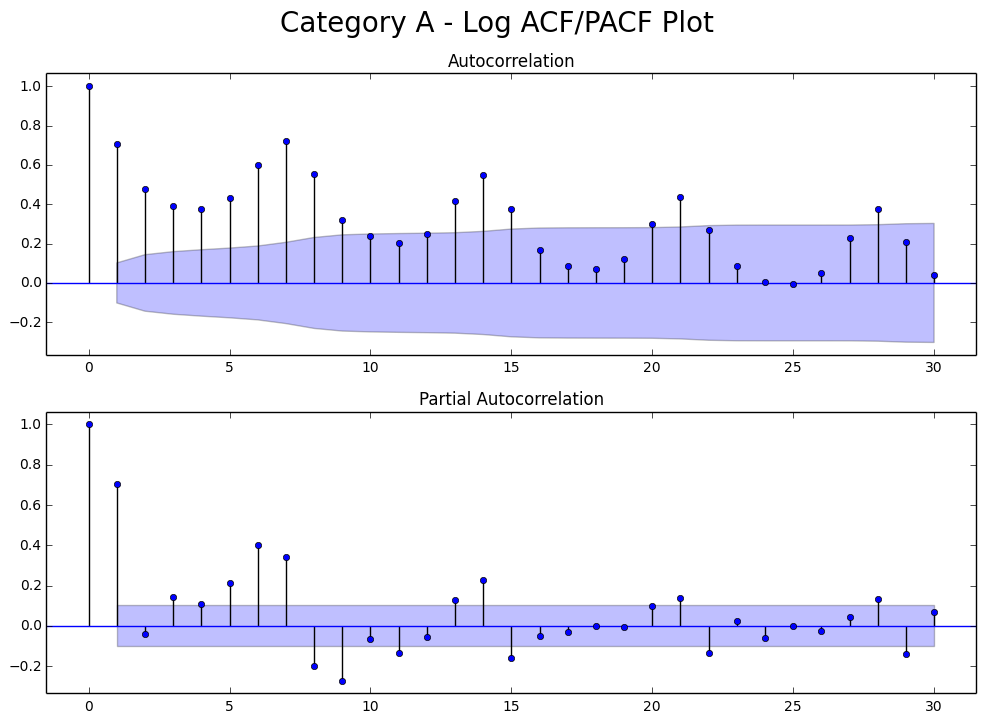

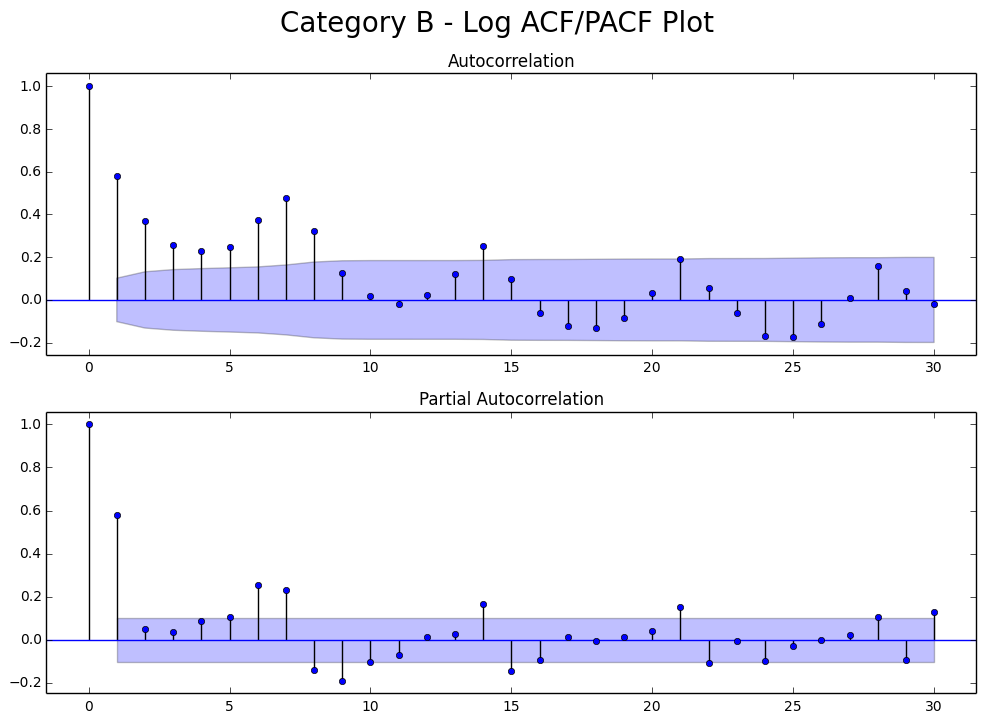

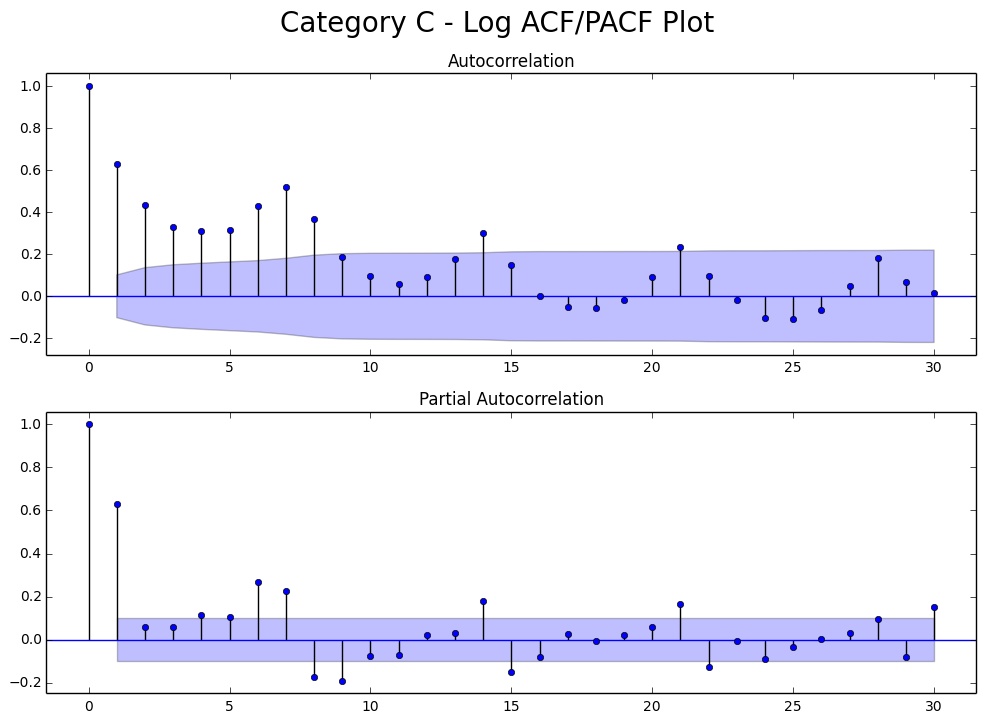

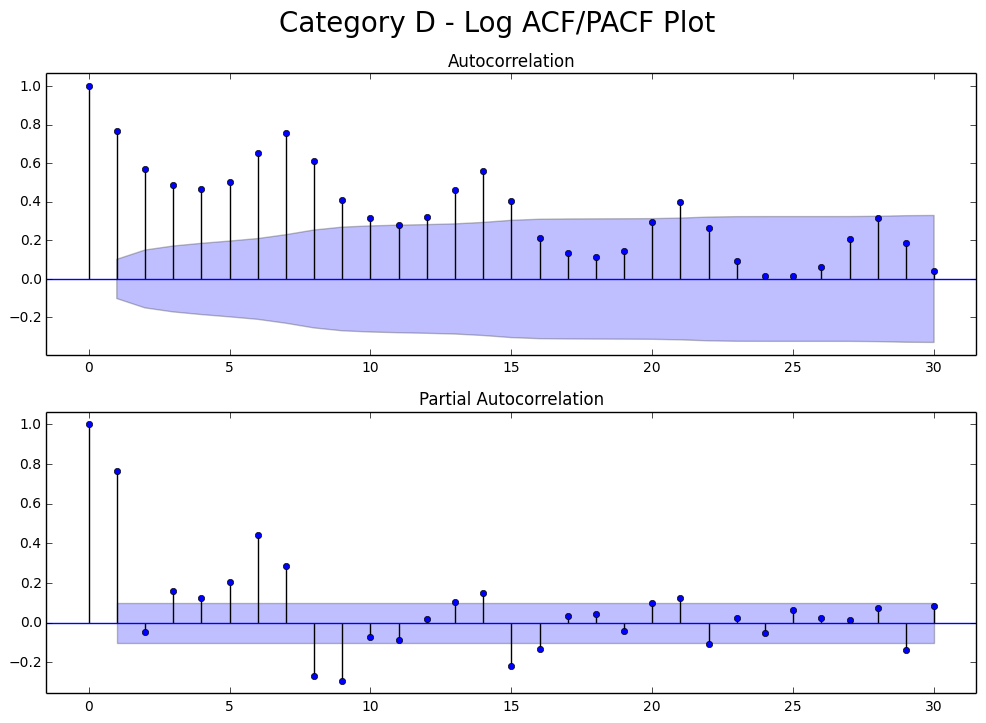

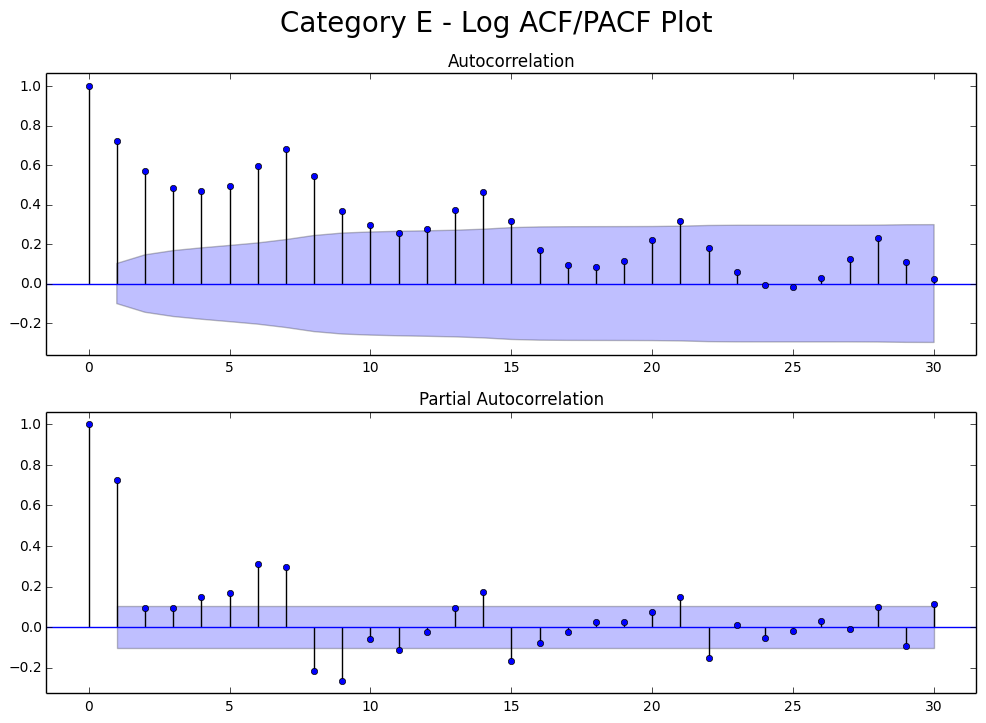

...

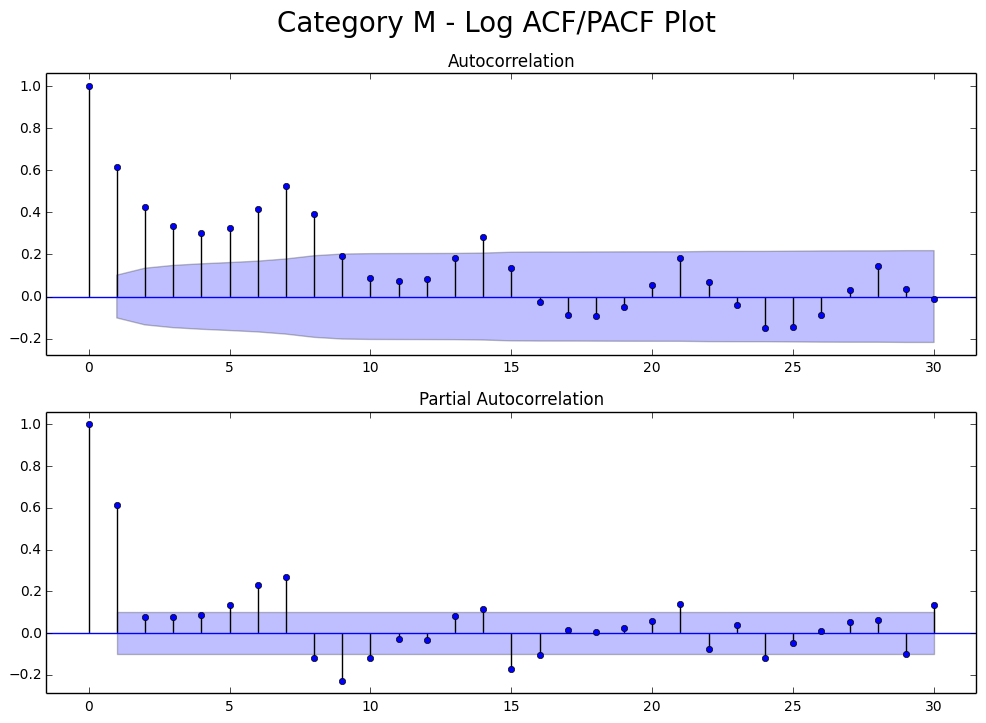

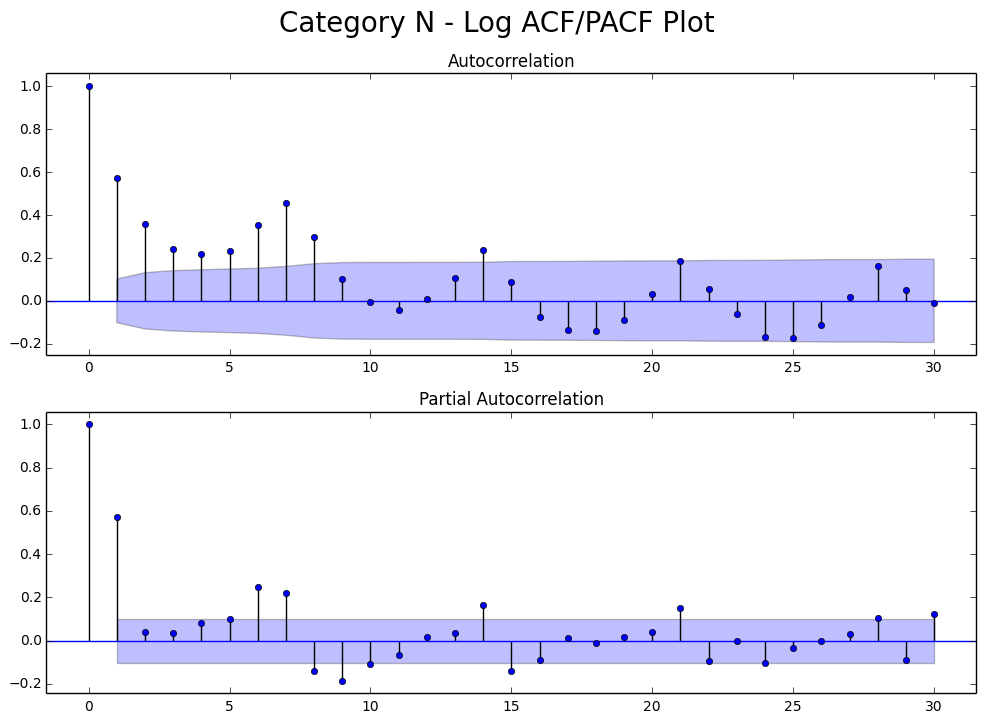

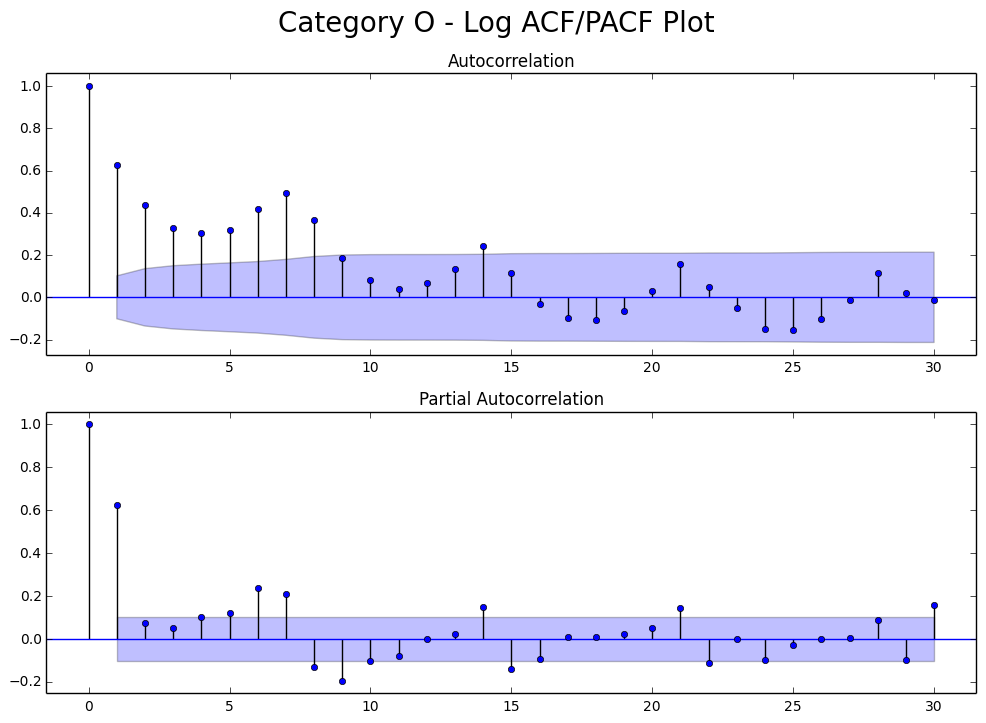

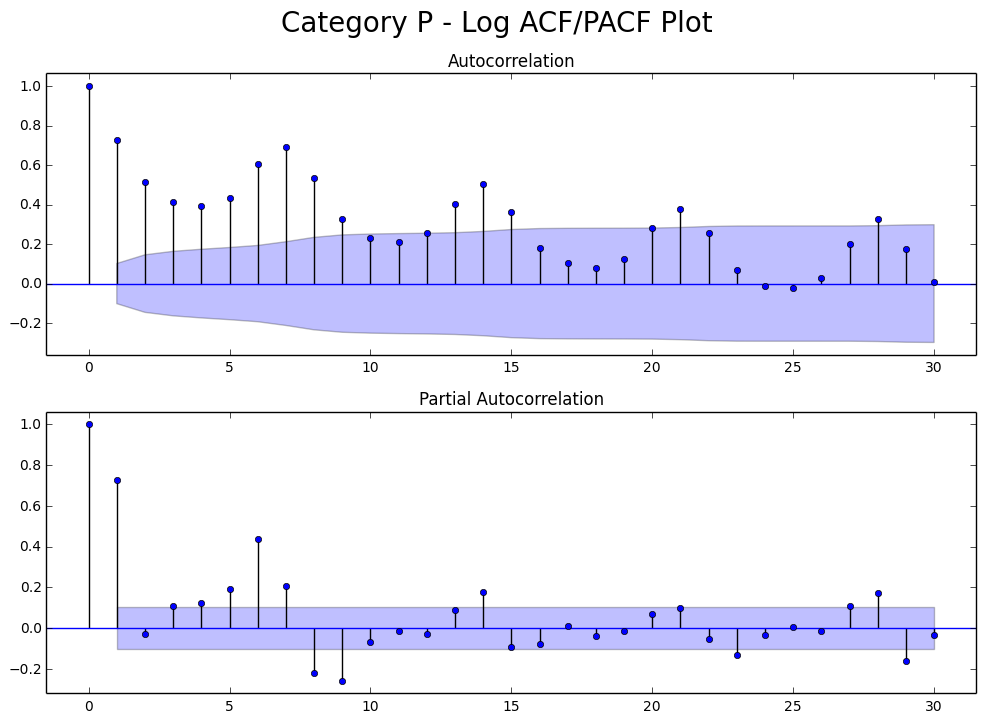

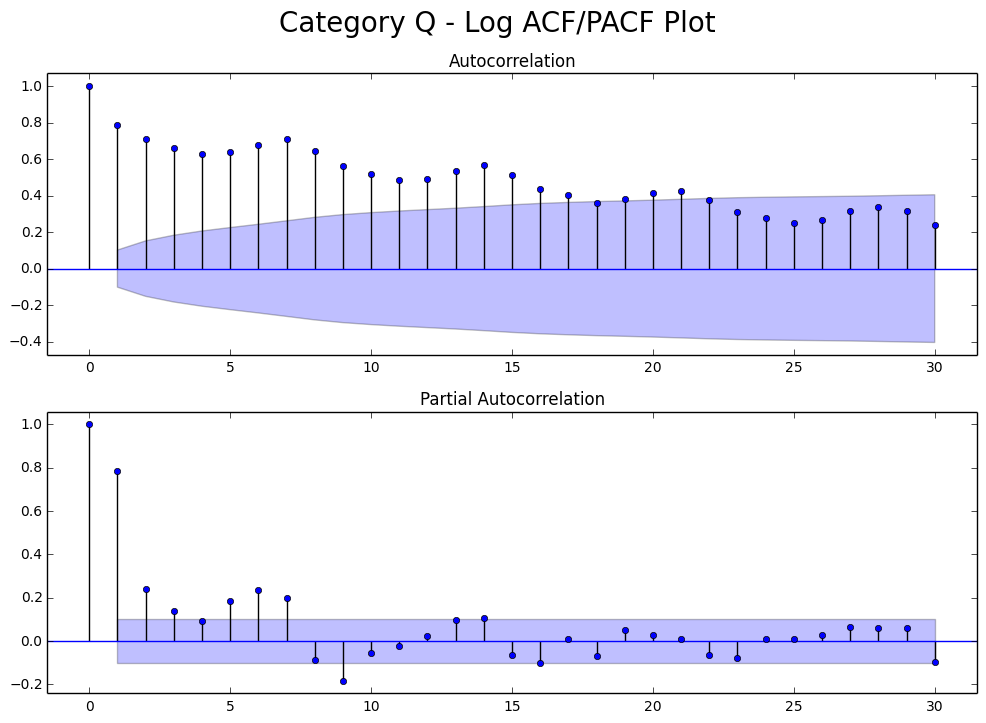

In [140]:
# Log ACF/PACF plot.

map(acf_pacf_plot, splitted_data_log, ['Log']*16, temp_list)

### A), D), E), F), G), H), I), L), P) both tail
### B), C), K), M), N), O), Q) PACF cut 1
### Some cut offs are not clear...possibly AR(1)?

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

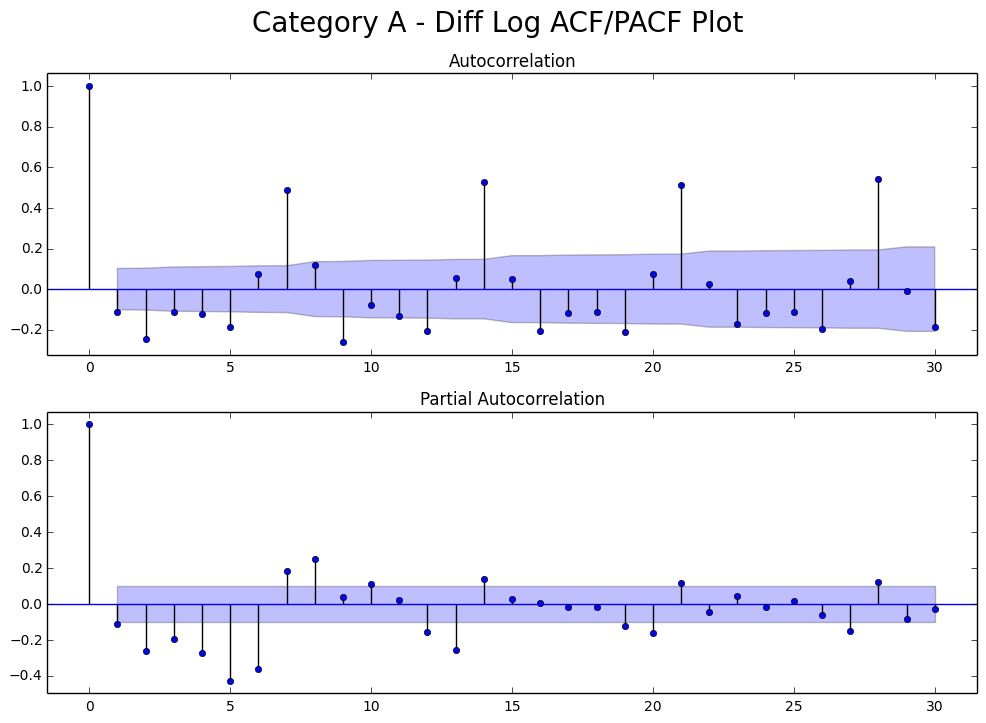

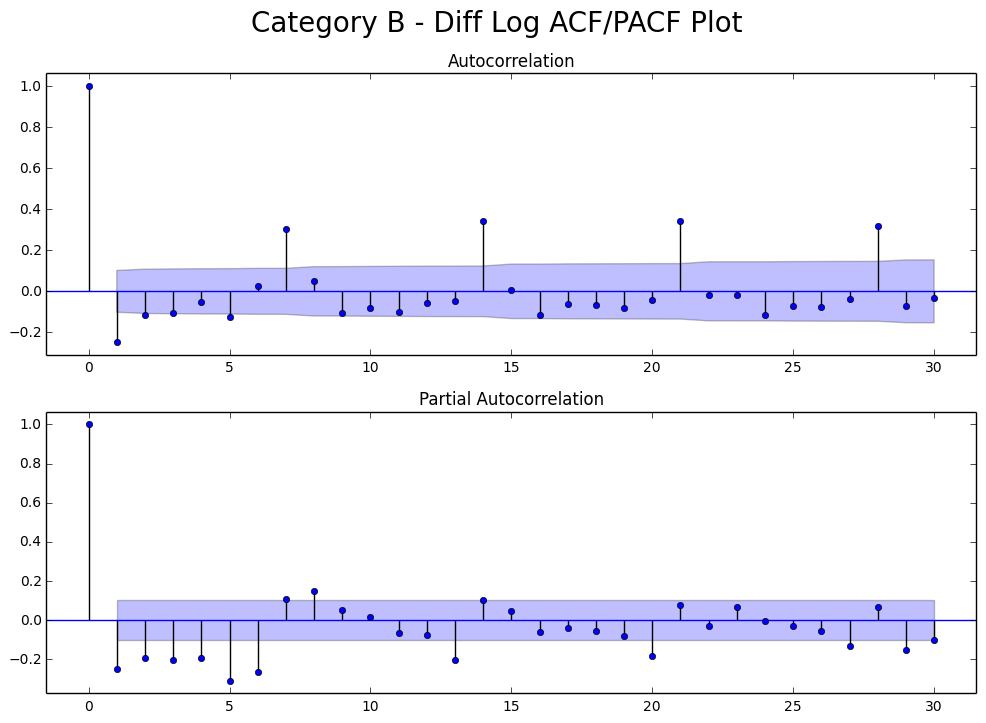

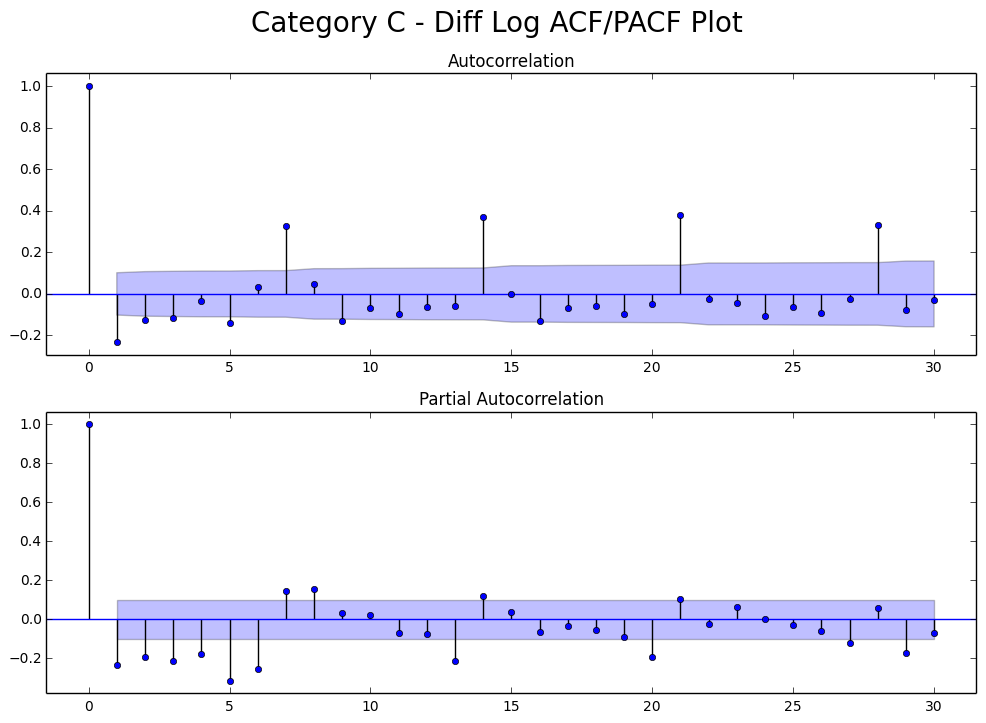

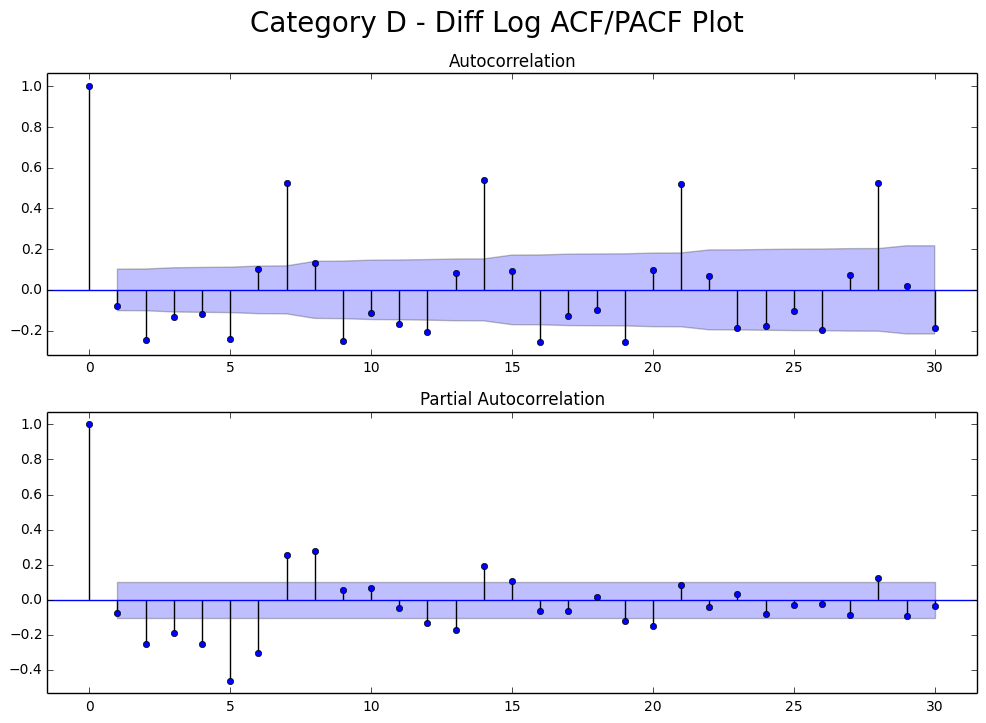

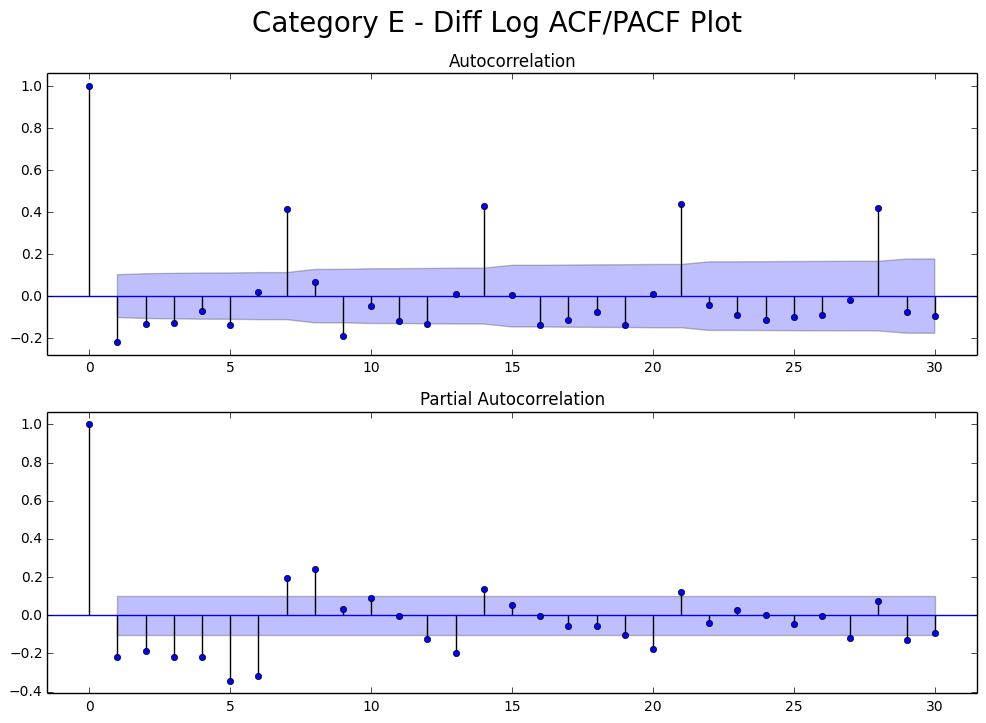

...

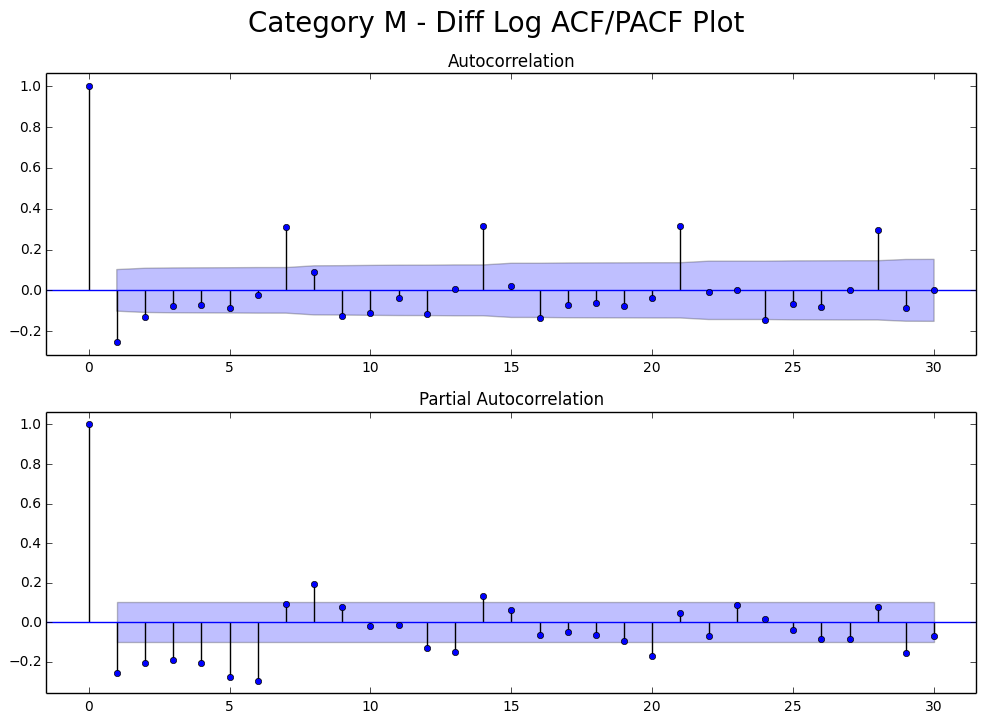

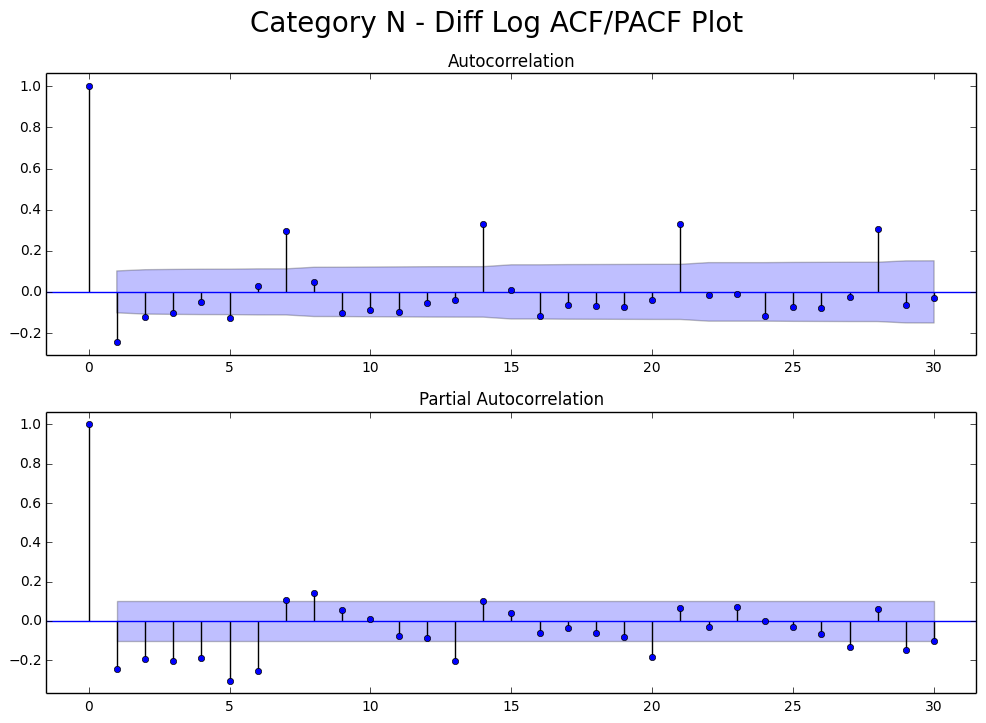

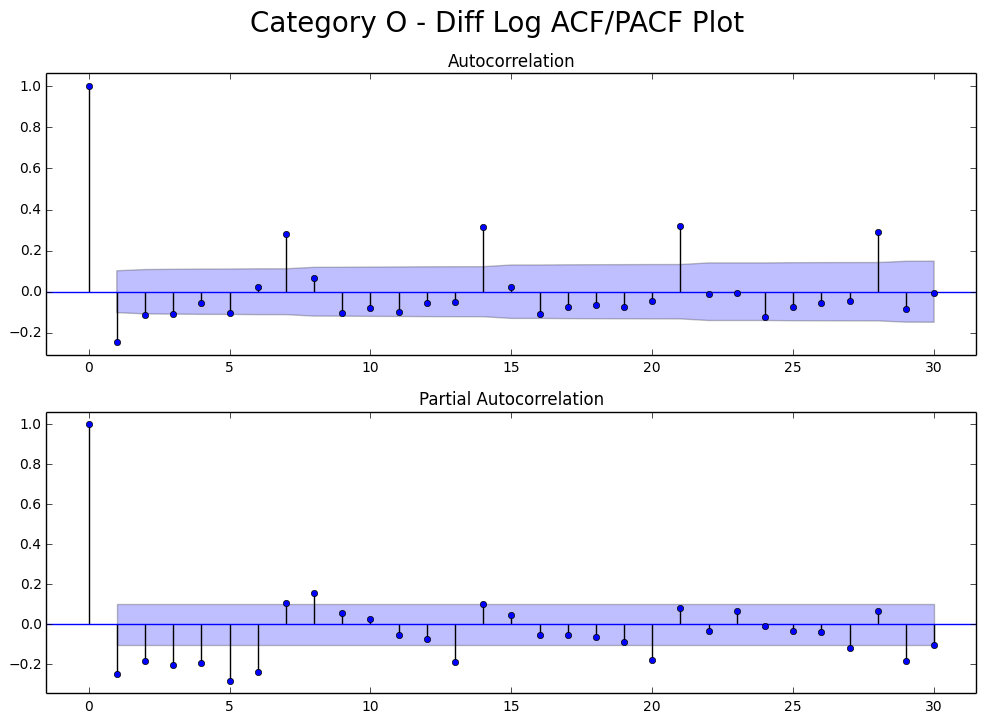

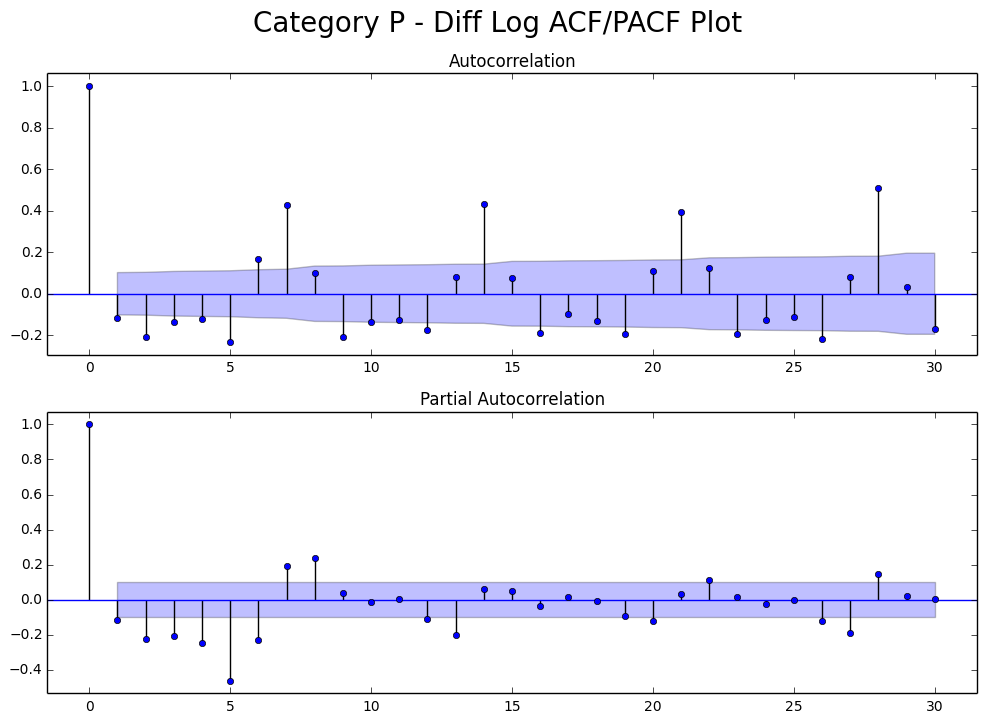

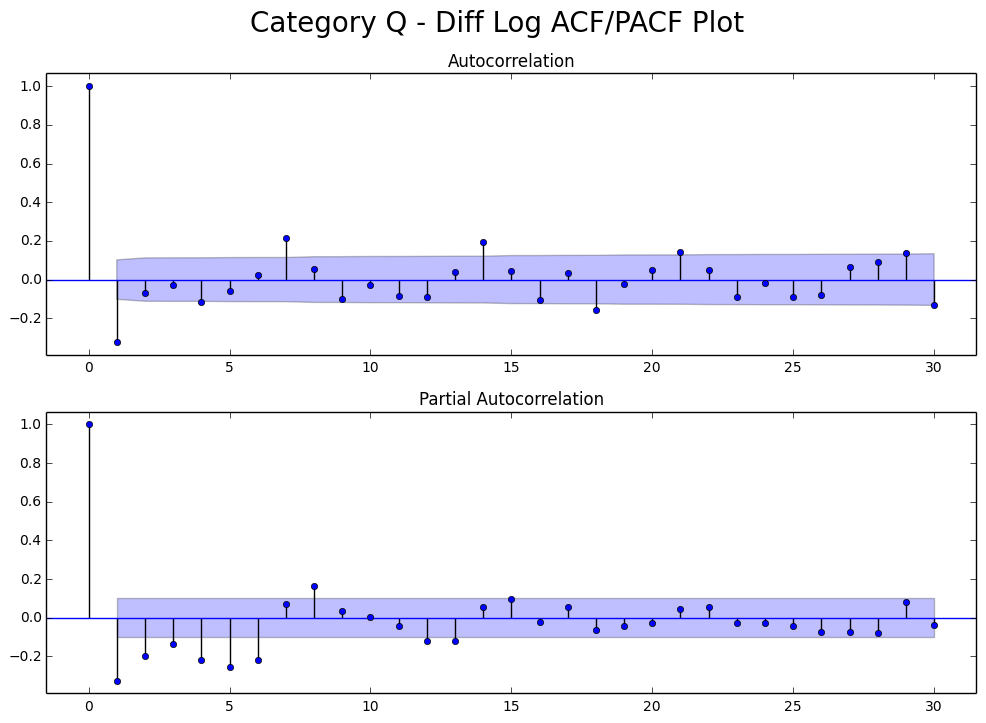

In [142]:
# Diff log ACF/PACF plot.

map(acf_pacf_plot, splitted_data_log_diff, ['Diff Log']*16, temp_list)

### - Log diff has both tails off, thus, ARMA behavior.
### - So...the observed data may be ARIMA...

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

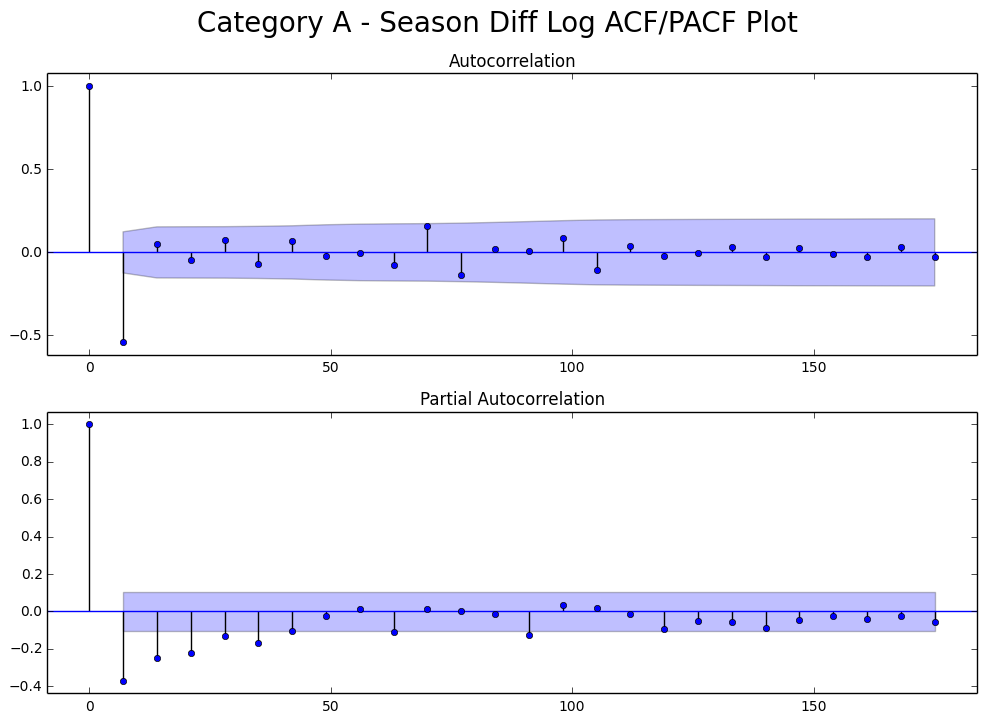

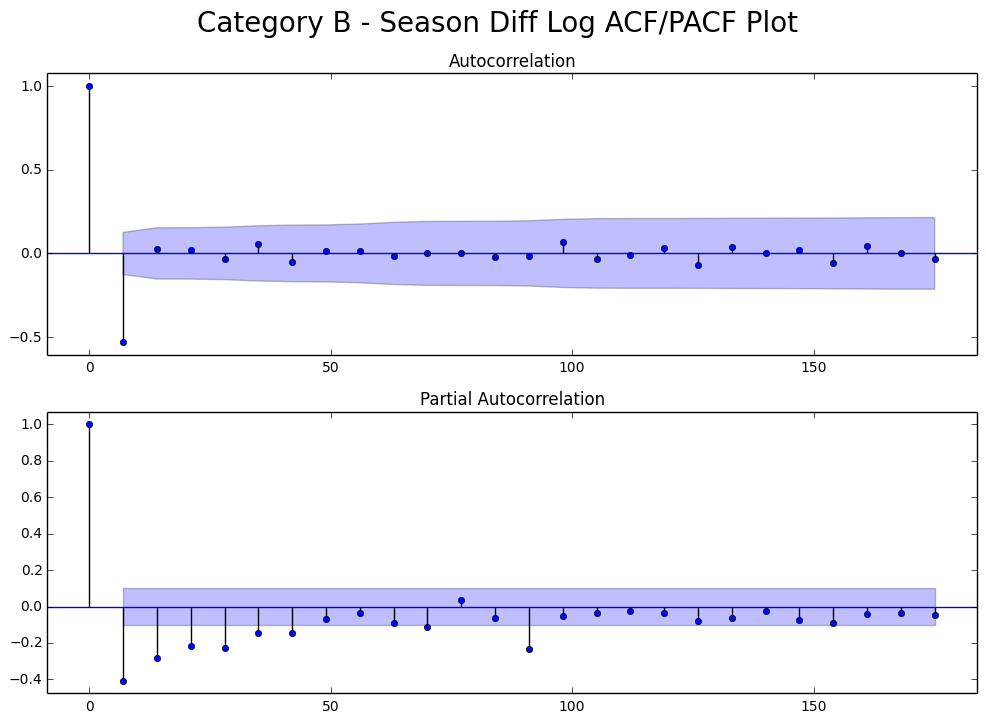

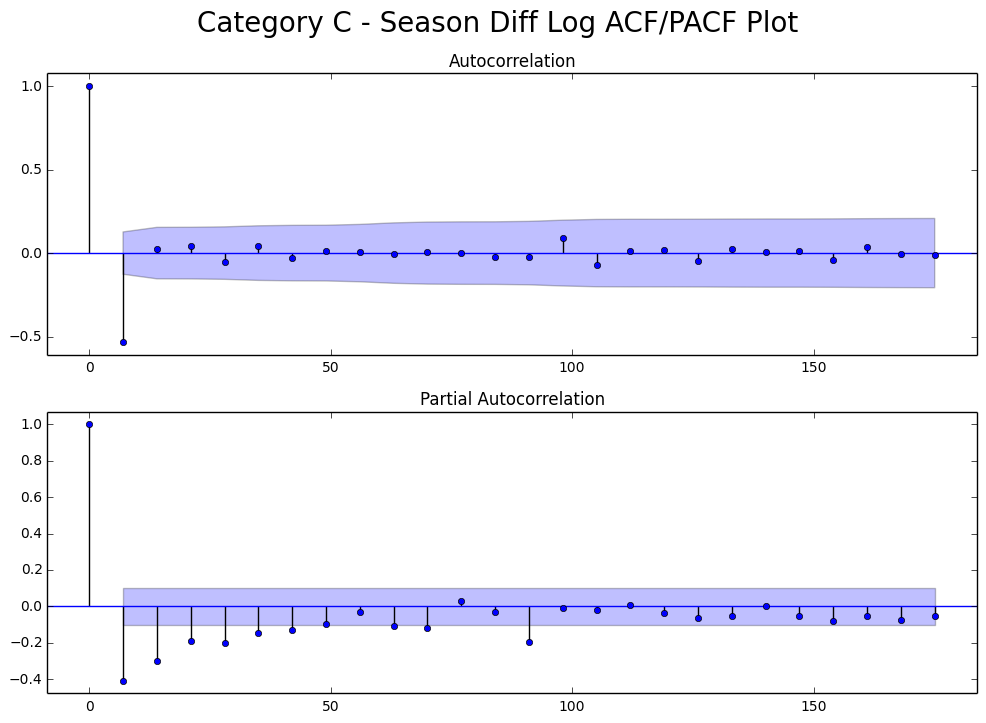

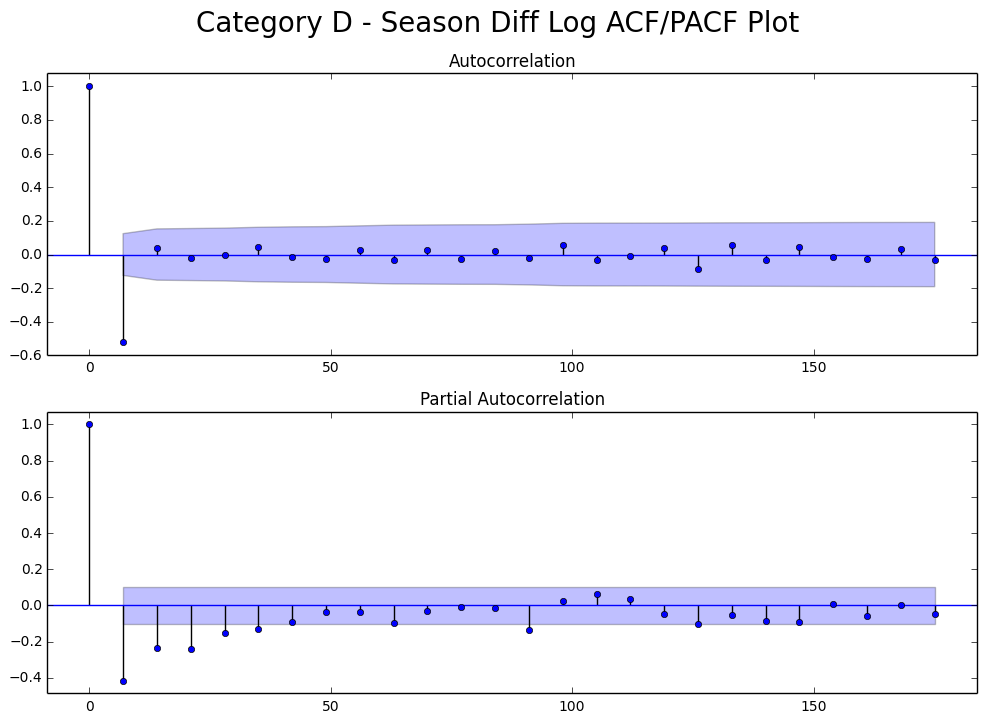

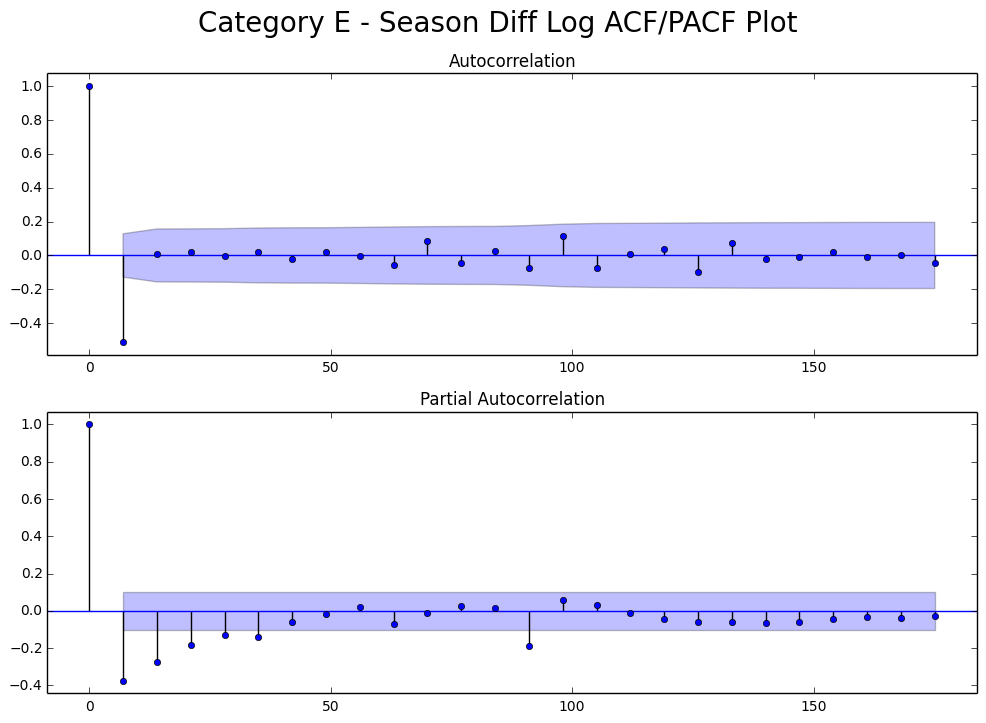

...

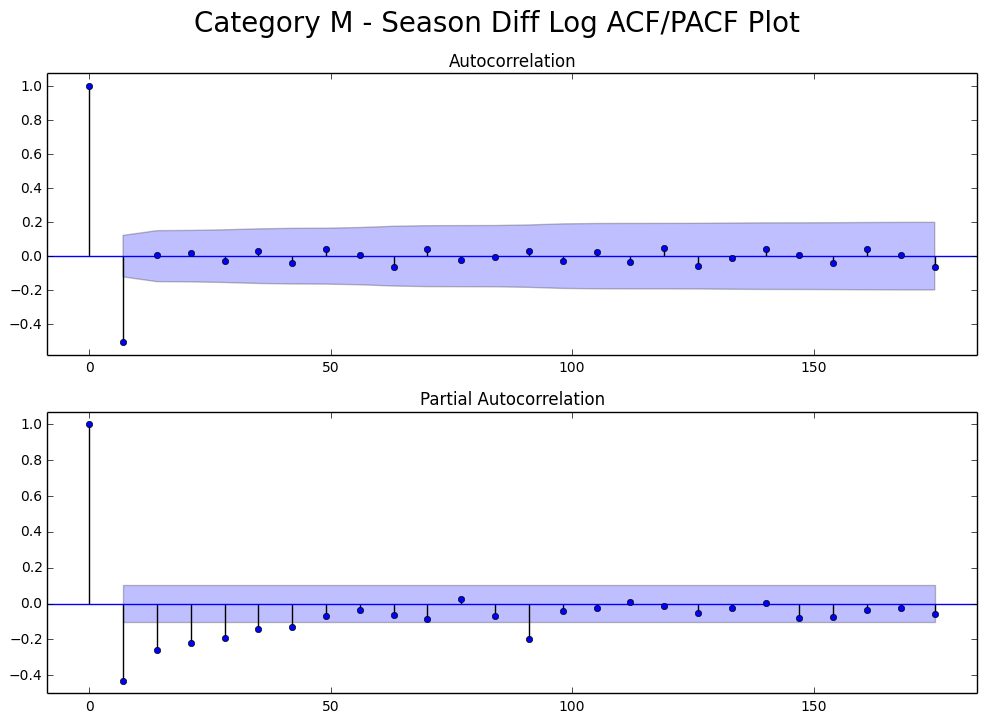

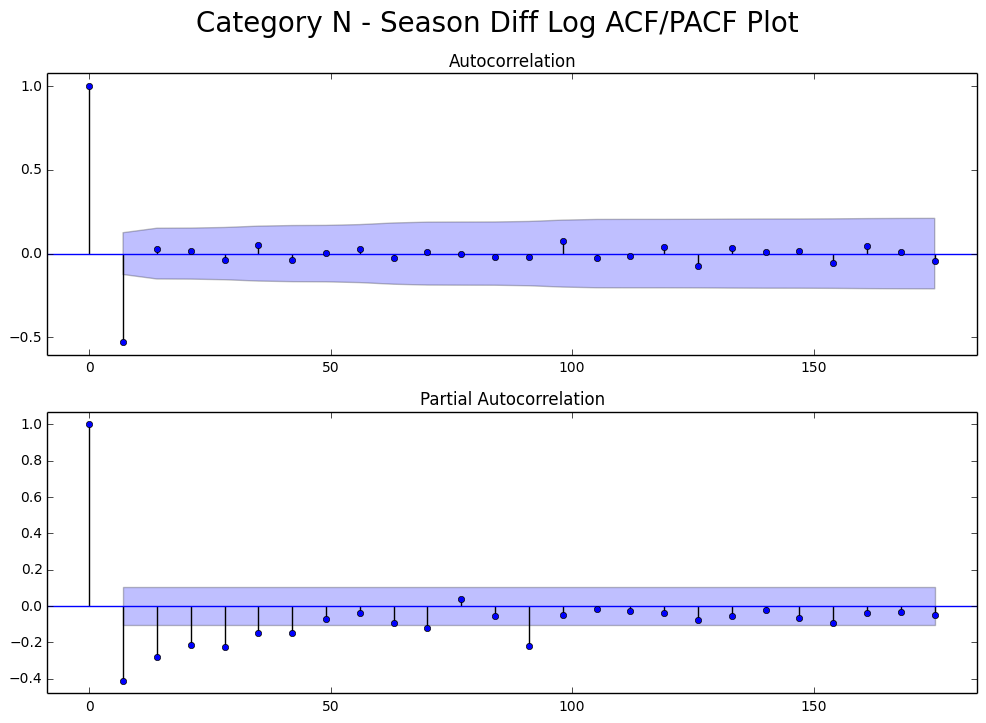

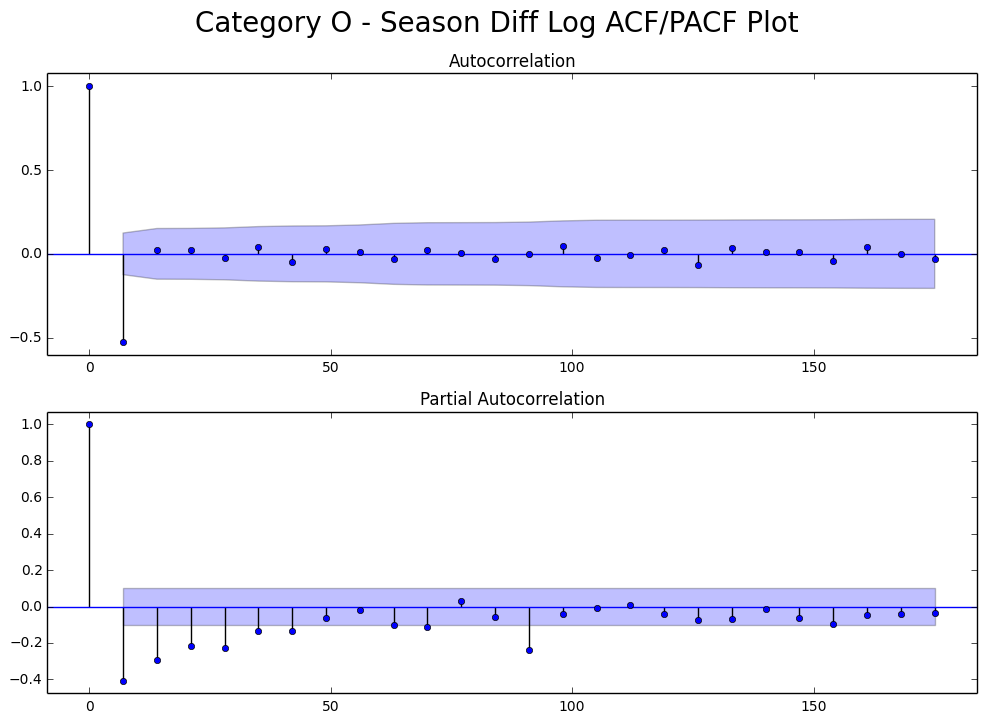

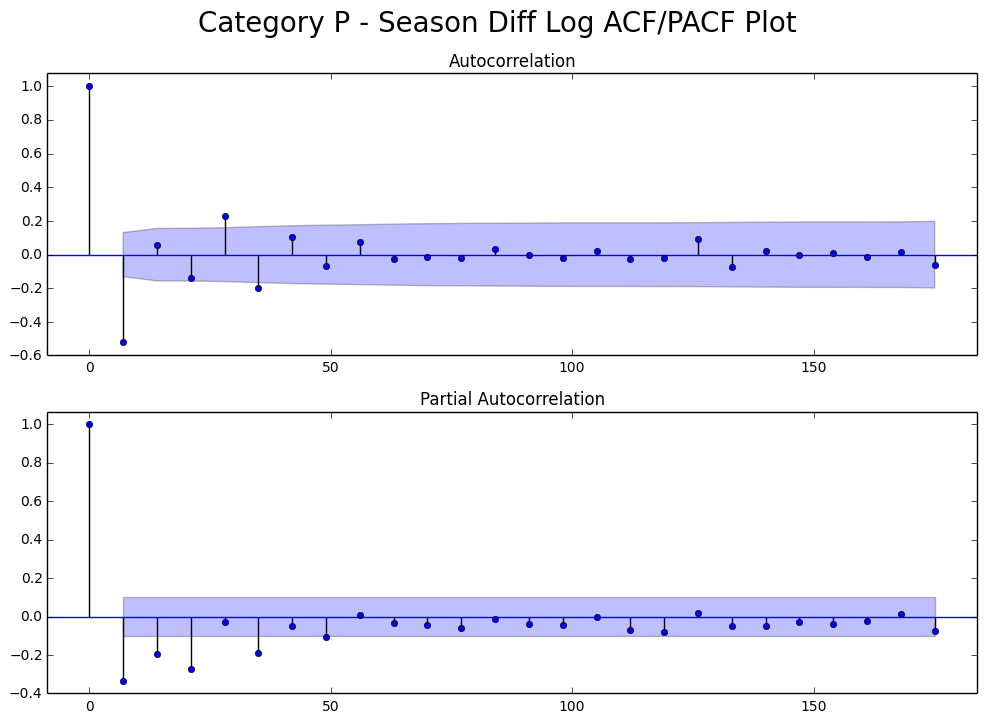

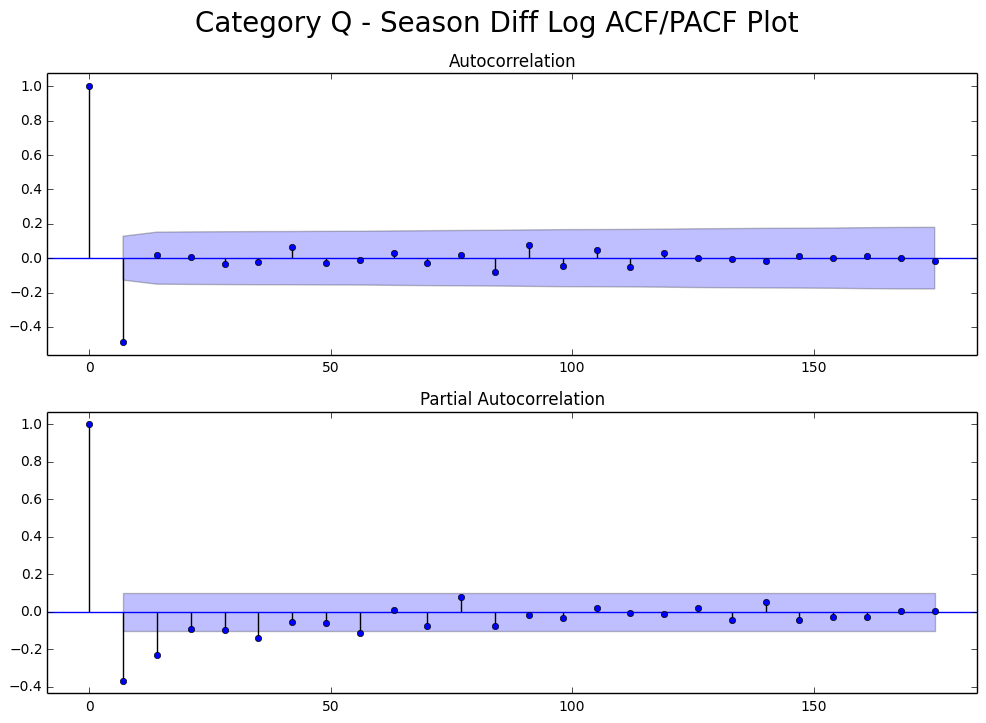

In [147]:
# Log ACF/PACF plot.

map(acf_pacf_plot, splitted_data_log_diff_season, ['Season Diff Log']*16, temp_list, [range(0, 182, 7)]*16)

### All - ACF cut 1...SMA(1)? -> SARIMA(0, 1, 1)?

In [73]:
def evaluate_models(dataset, p_values, q_values, P_values, Q_values):
    best_score, best_cfg, best_season = float("inf"), None, None
    for p in p_values:
        for q in q_values:
            for P in P_values:
                for Q in Q_values:
                    order = (p,1,q)
                    season_order = (P, 1, Q, 7)
                    mod = sm.tsa.statespace.SARIMAX(dataset, trend='n', order=order, \
                                                       seasonal_order=season_order)
                    result = mod.fit()
                    aic = result.aic
                    if aic < best_score:
                        best_score, best_cfg, best_season = aic, order, season_order
                    print('SARIMA%s %s AIC=%.3f' % (order, season_order, aic))

    print('Best SARIMA%s %s AIC=%.3f' % (best_cfg, best_season, best_score))
    return [best_cfg, best_season]

In [74]:
temp = evaluate_models(splitted_data[0], range(0,2), range(1, 2), range(0,2), range(1, 2))
print '\n', temp

SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=4215.472
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=4206.725
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=4190.120
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=4176.523
Best SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=4176.523

[(1, 1, 1), (1, 1, 1, 7)]


In [75]:
def model_building(timeseries, item, p=range(0,2), q=range(1, 2), P=range(0,2), Q=range(1, 2)):
    orders = evaluate_models(timeseries, p, q, P, Q)
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=orders[0], seasonal_order=orders[1])
    results_1 = mod.fit()
    
    print 'Category {}: '.format(item), results_1.summary()
    return results_1

In [76]:
results_1 = map(model_building, splitted_data, temp_list)

SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=4215.472
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=4206.725
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=4190.120
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=4176.523
Best SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=4176.523
Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -2083.261
Date:                           Fri, 17 Feb 2017   AIC                           4176.523
Time:                                   01:49:22   BIC                           4196.104
Sample:                               09-26-2015   HQIC                          4184.299
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3470.460
Date:                           Fri, 17 Feb 2017   AIC                           6950.920
Time:                                   01:49:40   BIC                           6970.501
Sample:                               09-26-2015   HQIC                          6958.697
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7506      0.030     25.208      0.000       0.692       0.809
ma.L1         -0.9704      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=6564.018
Best SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=6564.018


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category O:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3277.009
Date:                           Fri, 17 Feb 2017   AIC                           6564.019
Time:                                   01:50:13   BIC                           6583.600
Sample:                               09-26-2015   HQIC                          6571.796
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6589      0.042     15.514      0.000       0.576       0.742
ma.L1         -0.9353      0.0

In [ ]:
# TODO: May not need...
# This seems to generate better AIC/BIC...
# mod = sm.tsa.statespace.SARIMAX(temp_A_log, trend='n', order=(1,1,1), seasonal_order=(1,1,1,7))

results_2 = list(map(model_building, splitted_data, temp_list, [1]*16, [1]*16, [1]*16, [1]*16))

In [ ]:
# TODO: May not need...
# This seems to generate better AIC/BIC...
# mod = sm.tsa.statespace.SARIMAX(temp_A_log, trend='n', order=(0,1,1), seasonal_order=(0,1,1,7))

results_3 = map(model_building, splitted_data, temp_list, [0]*16, [1]*16, [0]*16, [1]*16)

In [77]:
def get_residuals(timeseries_results):
    residuals = pd.DataFrame(timeseries_results.resid)
    print residuals.head()
    print residuals.describe()
    
    return residuals

In [78]:
residuals = map(get_residuals, results_1)

                     0
2015-09-26   66.520000
2015-09-27   32.448729
2015-09-28  307.146267
2015-09-29   74.962315
2015-09-30  -36.093260
                0
count  371.000000
mean     2.273839
std     78.803616
min   -328.554144
25%    -26.718604
50%      2.690640
75%     31.273746
max    319.799116
                      0
2015-09-26  1181.950000
2015-09-27  -159.181461
2015-09-28  6310.531033
2015-09-29  1955.258903
2015-09-30   641.900750
                 0
count   371.000000
mean    -11.889402
std    1299.595044
min   -6475.887014
25%    -402.418043
50%     -13.532883
75%     347.722623
max    6310.531033
                      0
2015-09-26   713.040000
2015-09-27  -224.984022
2015-09-28  2331.837563
2015-09-29   313.584041
2015-09-30    67.873508
                 0
count   371.000000
mean      7.558373
std     485.169139
min   -2182.944510
25%    -149.318389
50%      11.501067
75%     166.087214
max    2331.837563
                     0
2015-09-26   89.000000
2015-09-27   23.868453
2

In [79]:
def residual_analysis(residuals, item):
    fig = plt.figure(figsize=(12,12))

    ax1 = fig.add_subplot(411)
    ax1 = sm.graphics.tsa.plot_acf(residuals, lags=30, ax=ax1, title='Category {} - ACF of Residual'.format(item))

    ax2 = fig.add_subplot(412)
    ax2.title.set_text('Q-Q Plot of Std Residuals')
    ax2 = qqplot(residuals, line='r', ax=plt.gca())

    # Plot residual errors.
    ax3 = fig.add_subplot(413)
    ax3.title.set_text('Standardized Residuals')
    ax3 = plt.plot(residuals)
    # residuals.plot(kind='kde')

    temp_q_stat = sm.stats.diagnostic.acorr_ljungbox(residuals, lags=30)
    ax4 = fig.add_subplot(414)
    ax4.title.set_text('P value for Ljung-Box Statistics')
    ax4 = plt.plot(temp_q_stat[1], 'o')
    # print temp_q_stat[0]

    plt.tight_layout()

/System/Library/Frameworks/Python.framework/Versions/2.7/Extras/lib/python/matplotlib/collections.py:548: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == 'face':


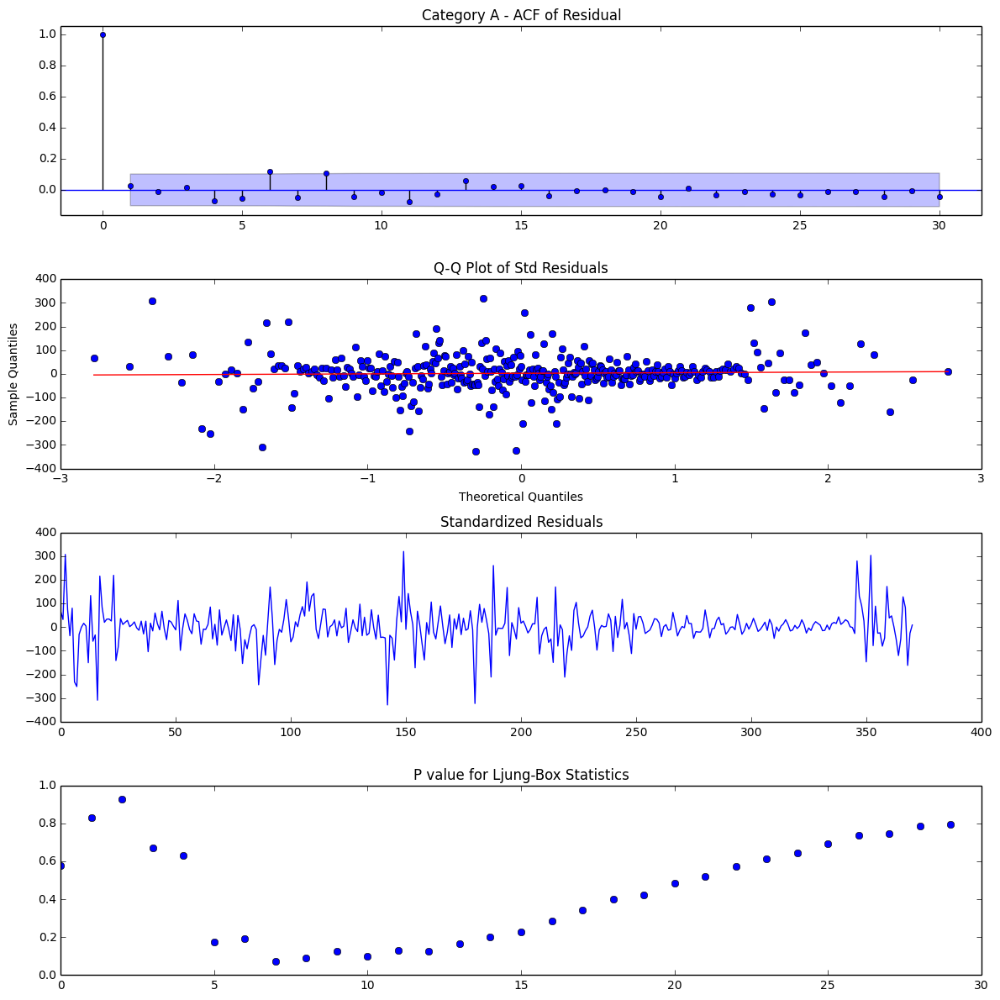

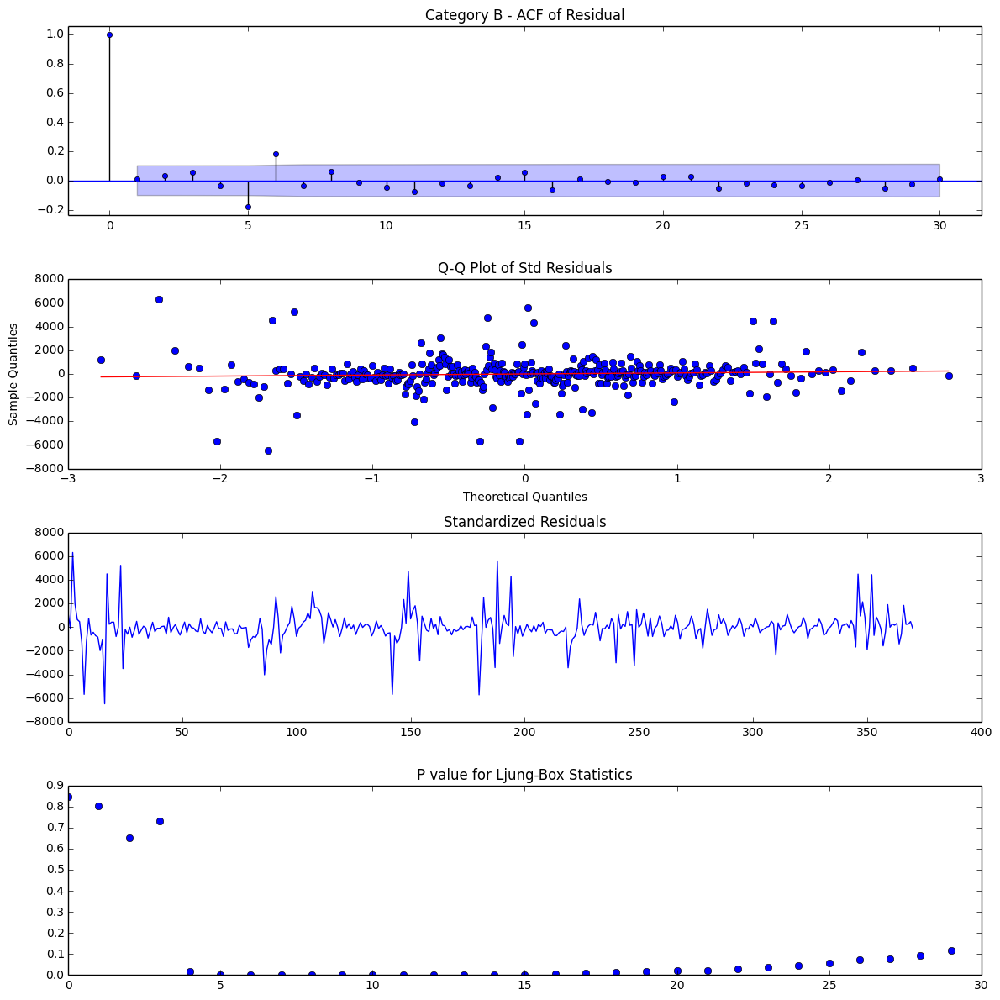

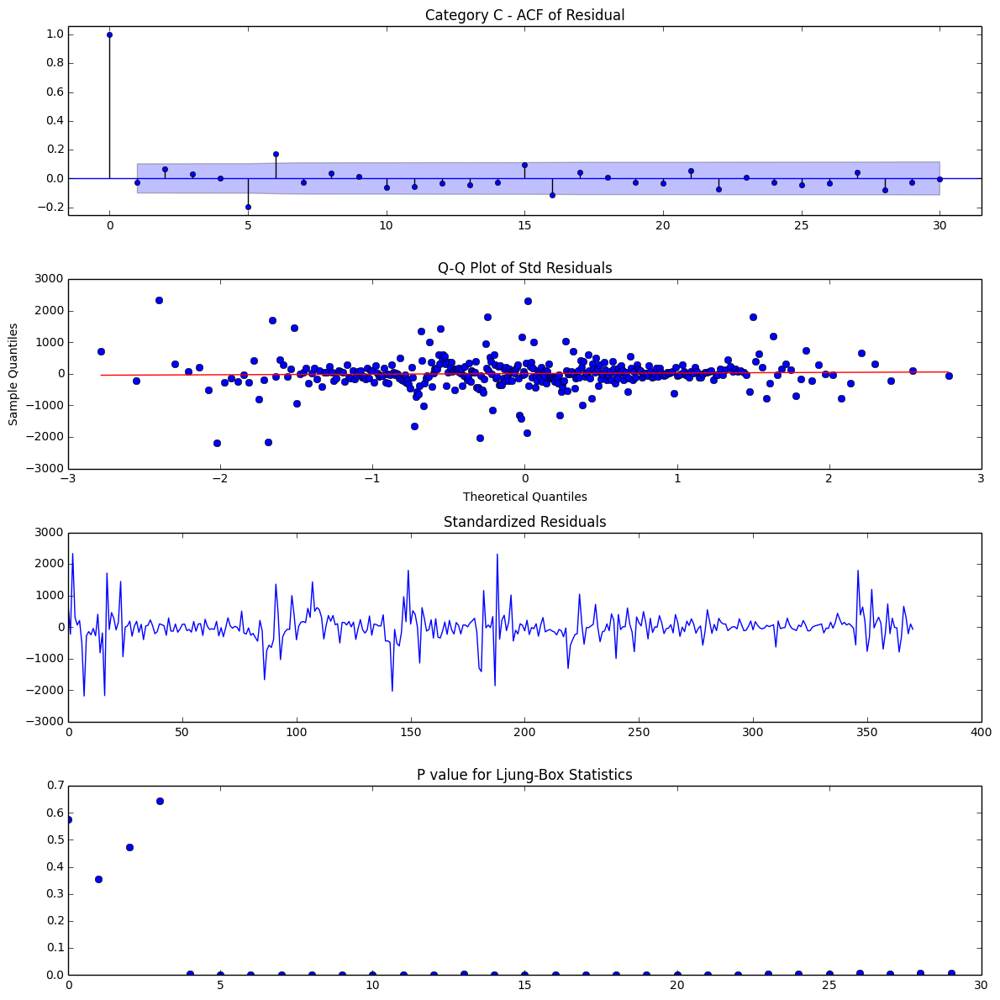

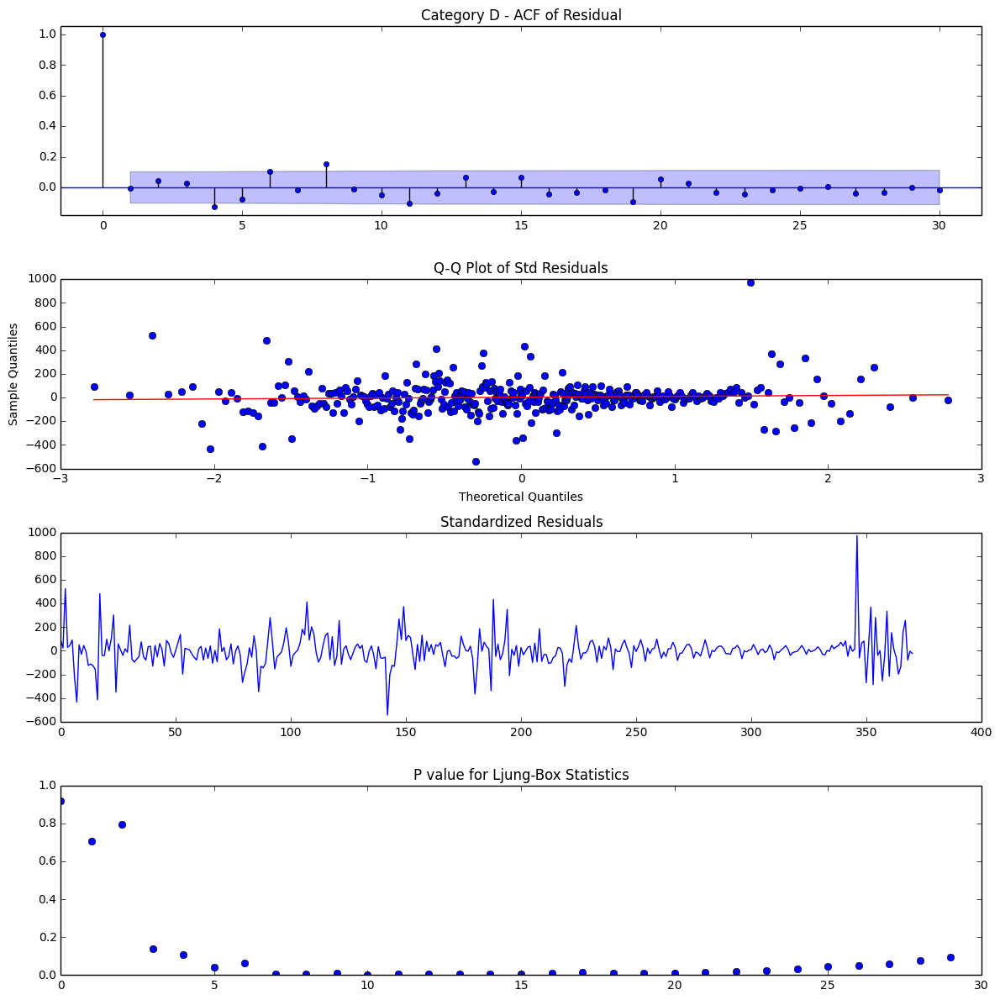

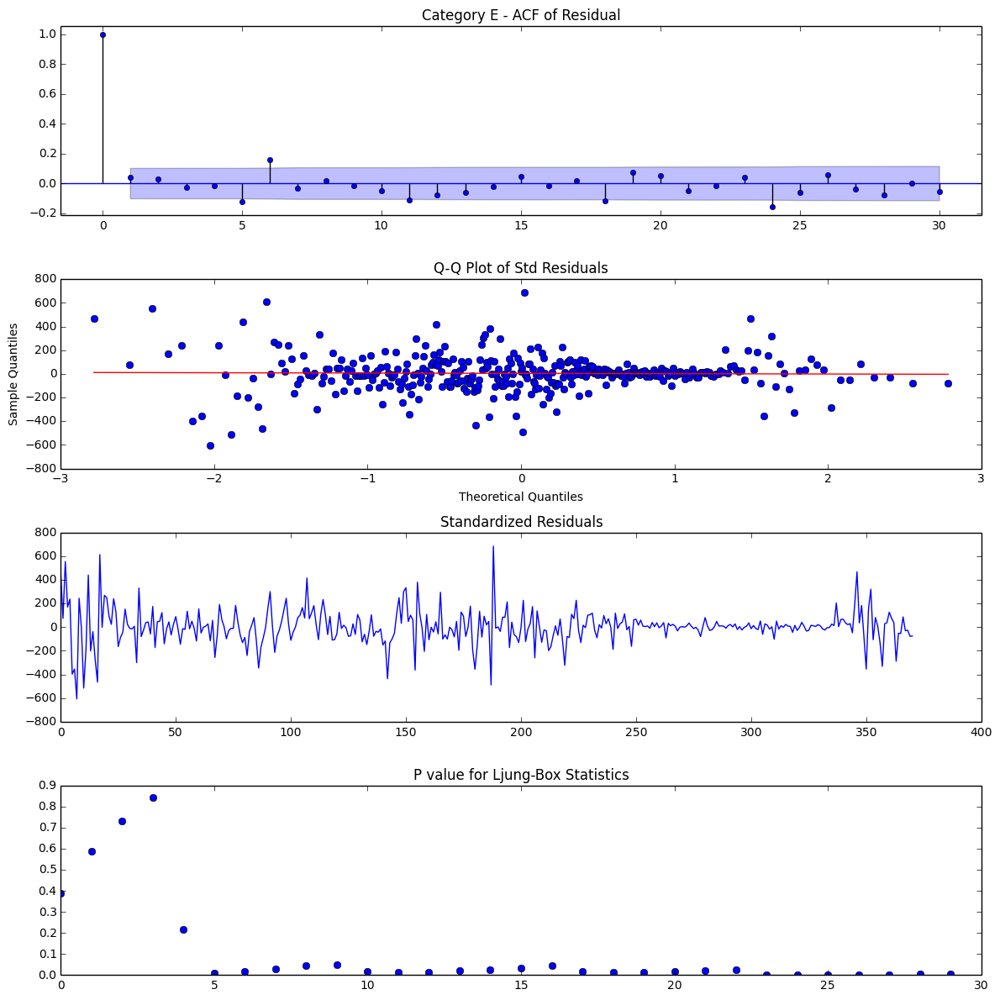

...

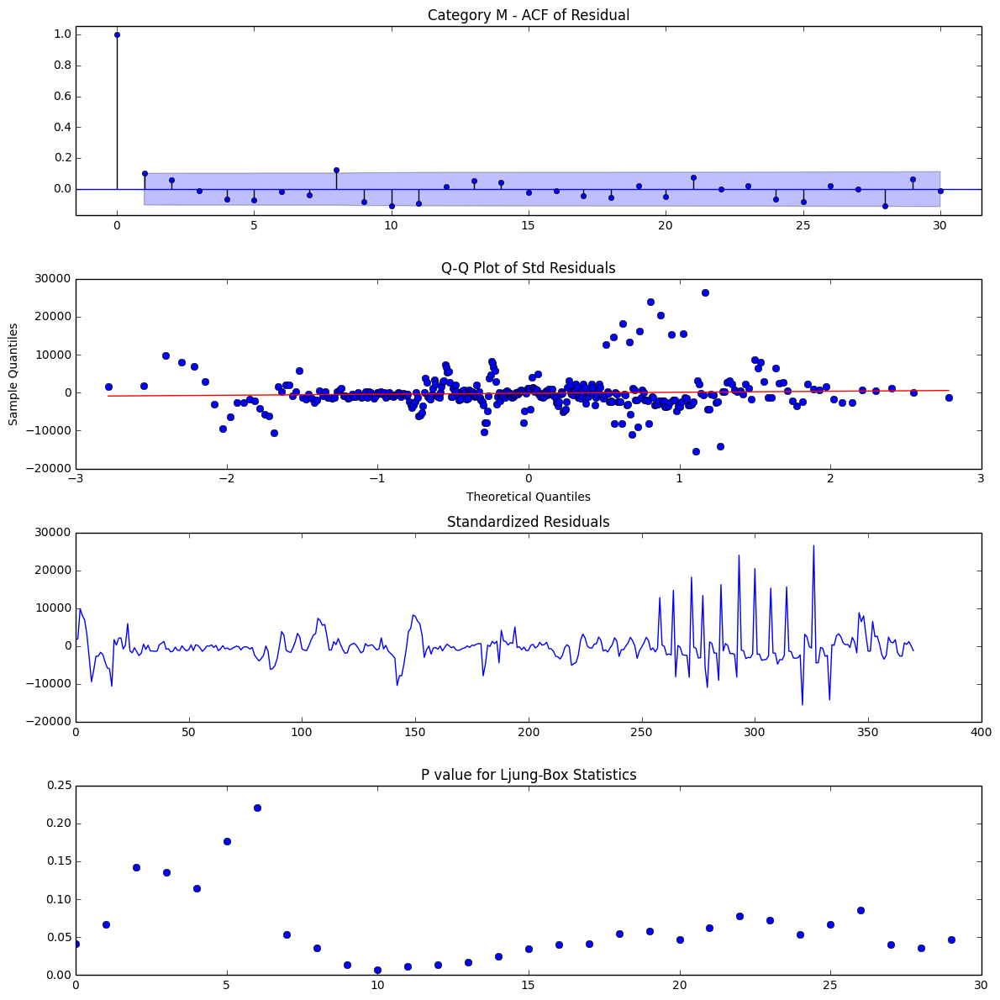

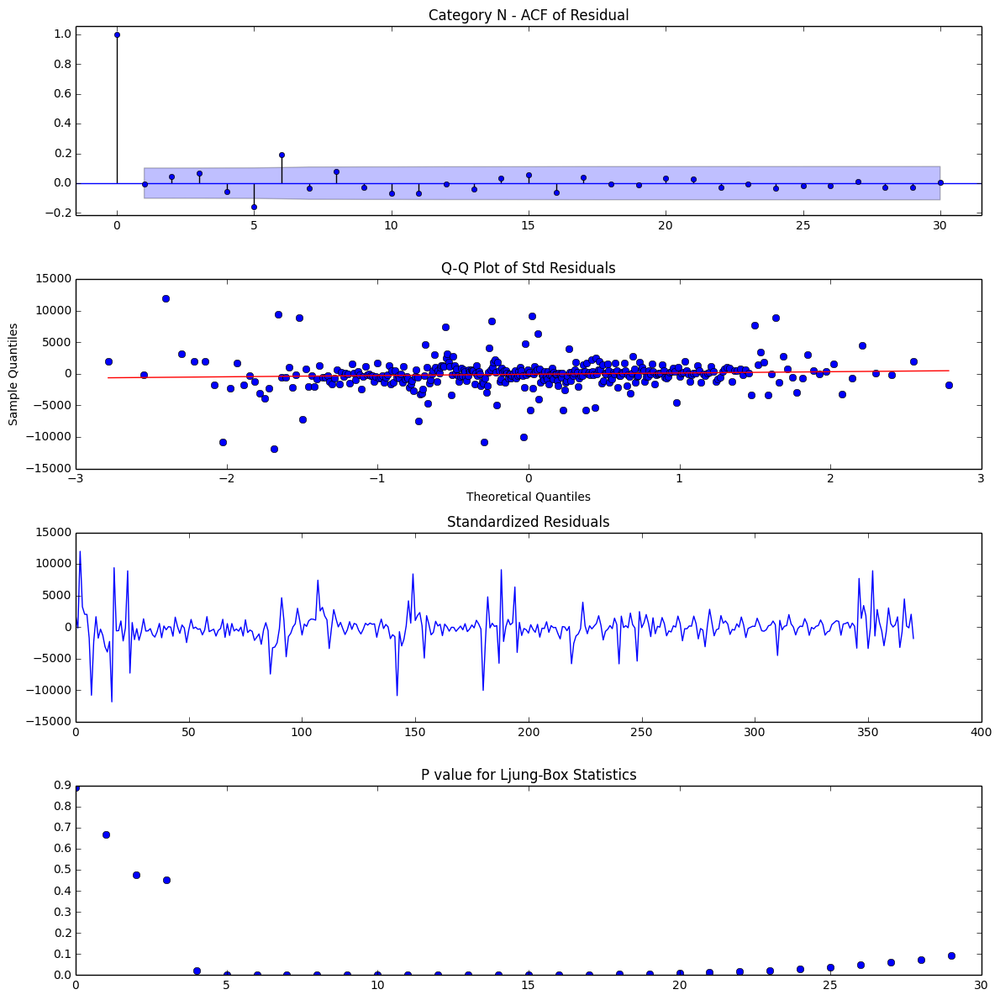

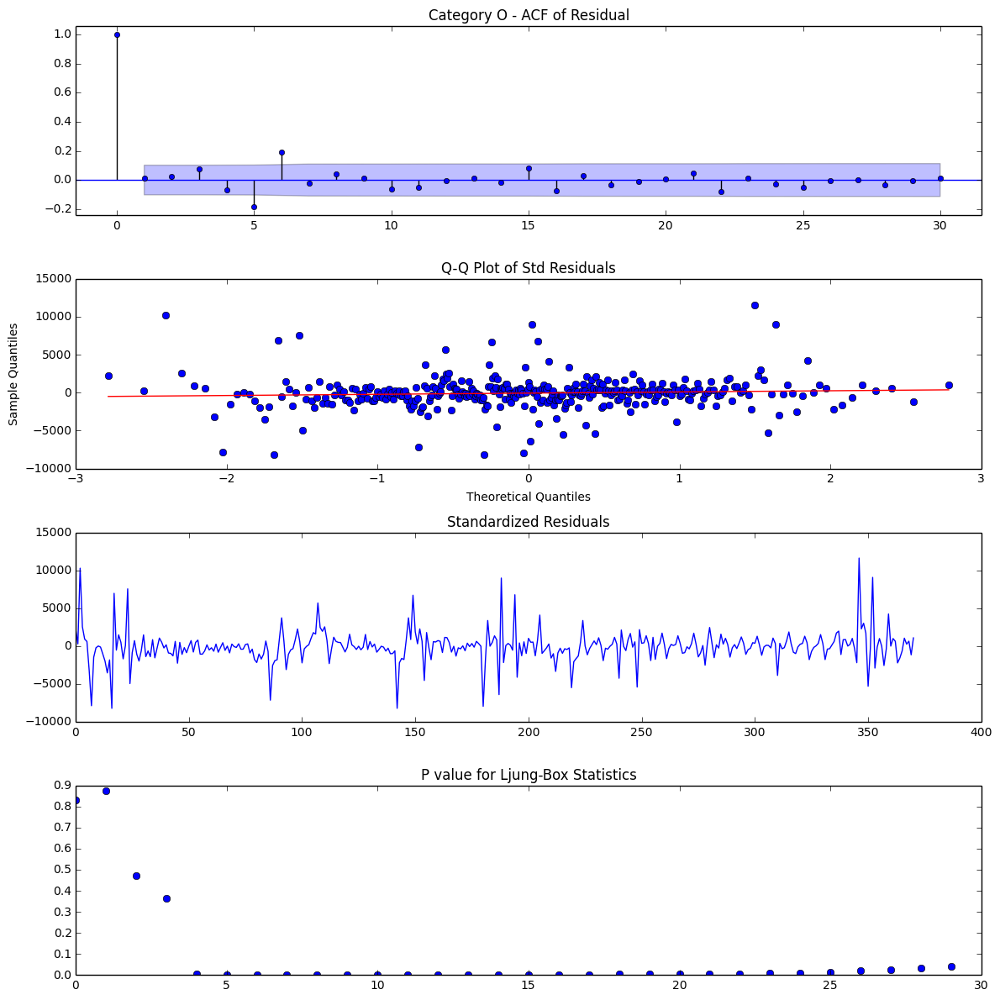

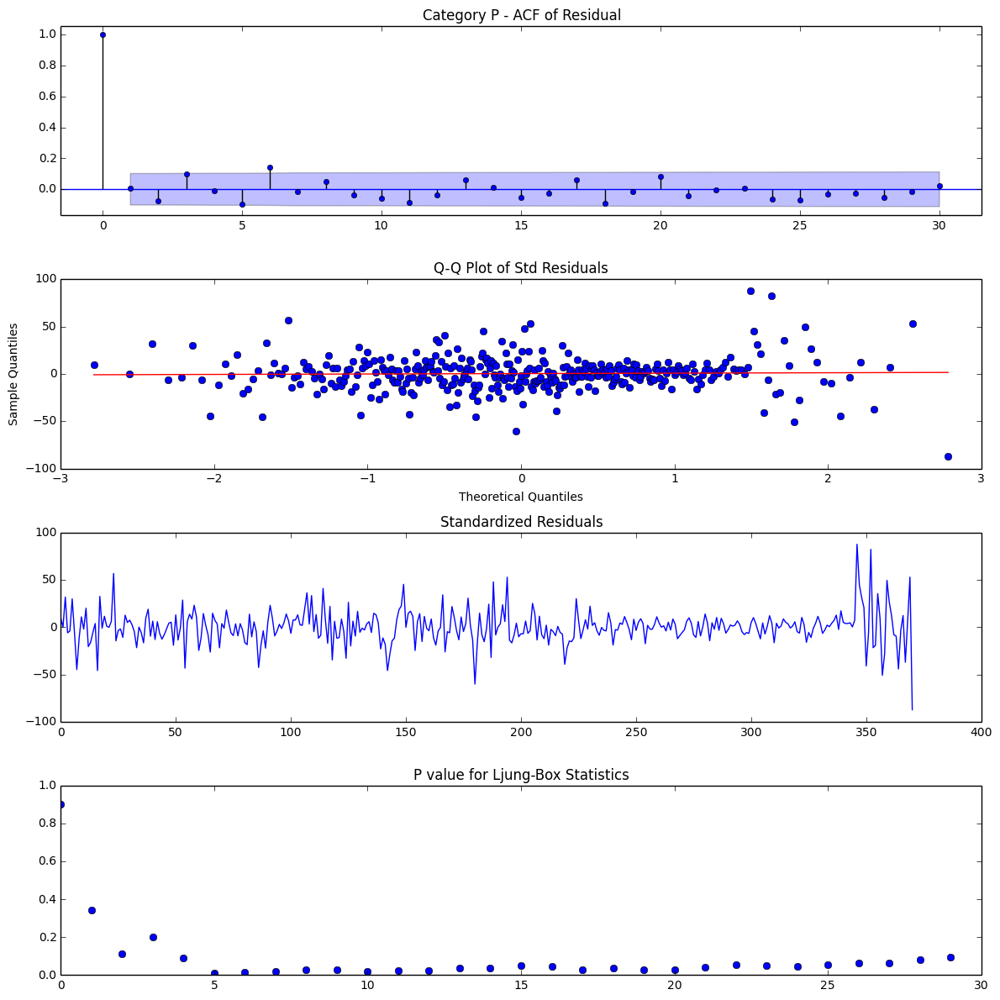

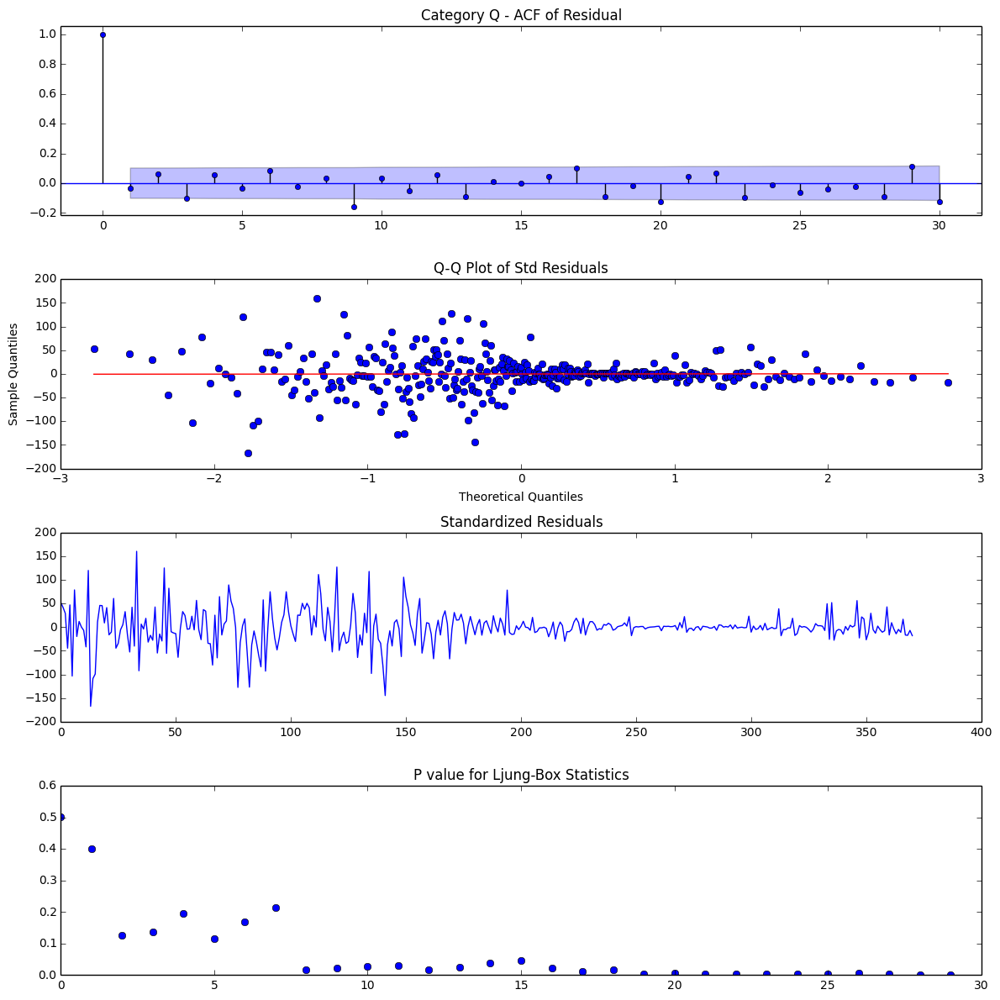

In [80]:
_ = map(residual_analysis, residuals, temp_list)

### Category L has problem...

# Prediction In Sample, and 90 Days Ahead

In [81]:
def plot_forecast(results, timeseries, item):
    pred = (results.predict())
    forecast_90 = (results.forecast(steps=90))

    pred.plot(label='predict')
    forecast_90.plot(label='forecast')
    timeseries.plot(label='original')
    plt.title(' Category {} Forecast '.format(item))
    plt.legend()
    plt.show(block=False)
    
    return pred

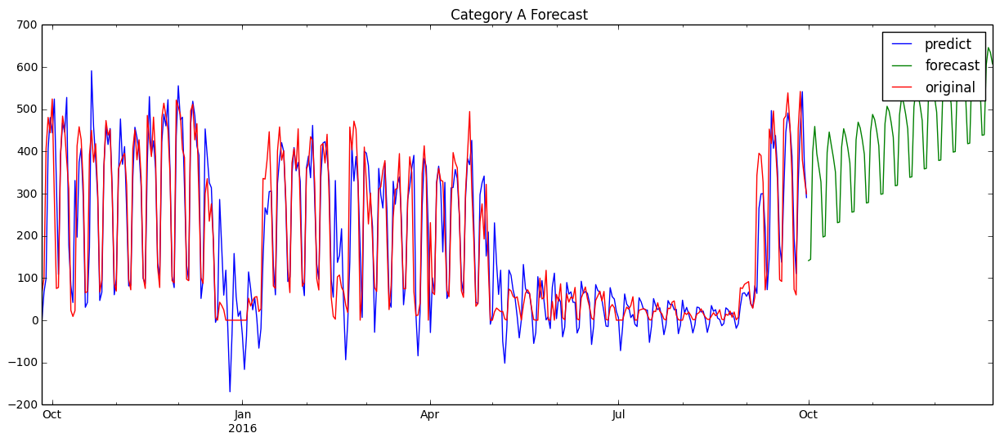

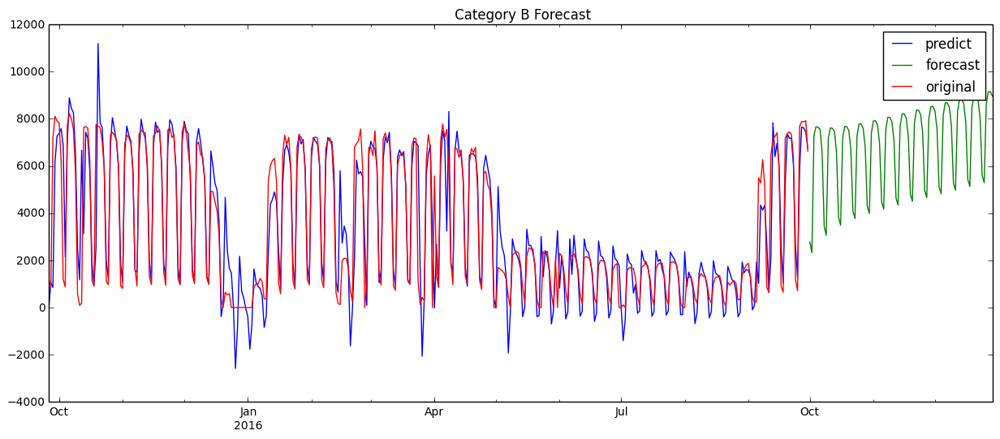

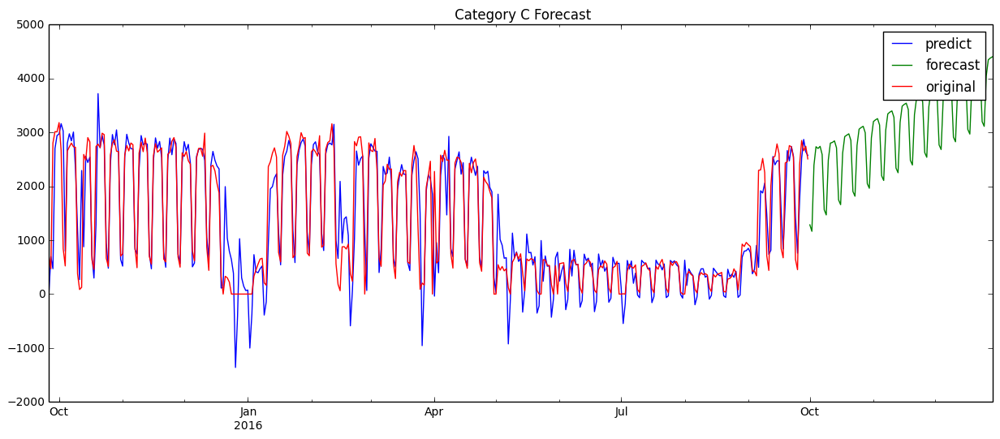

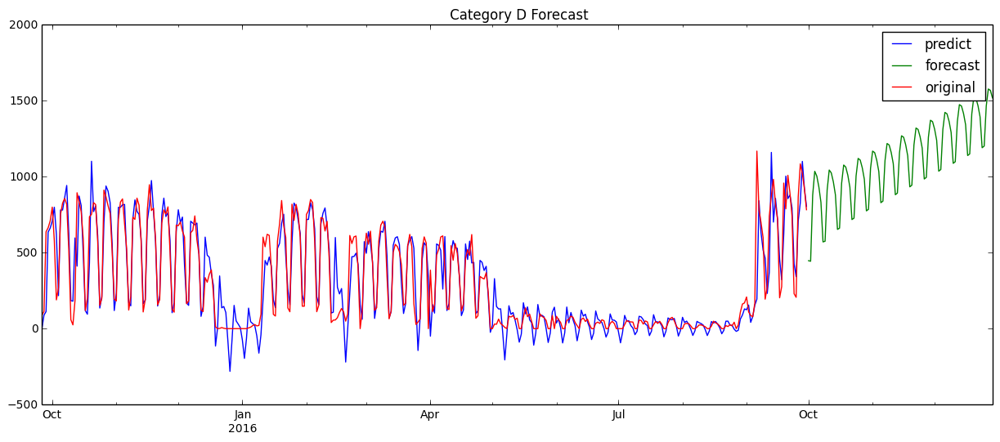

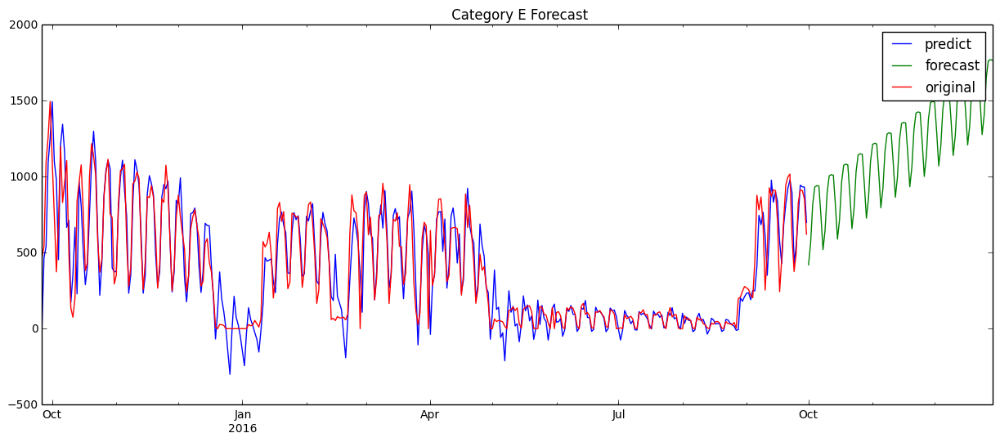

...

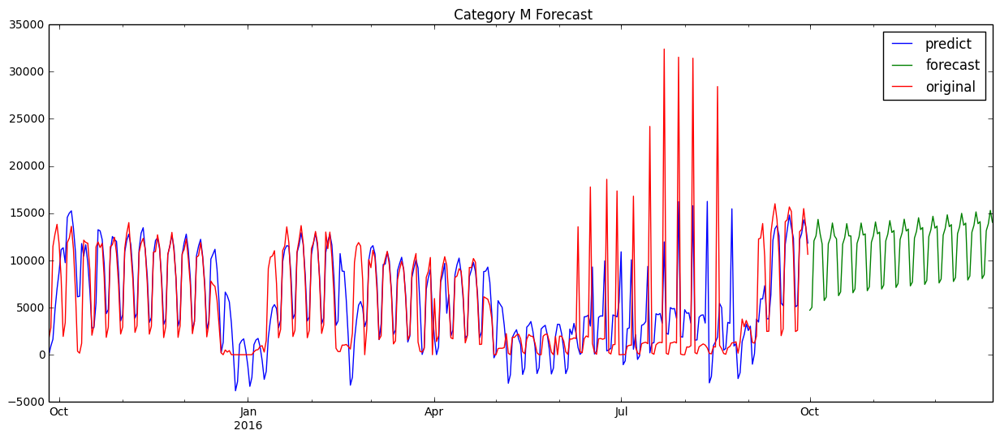

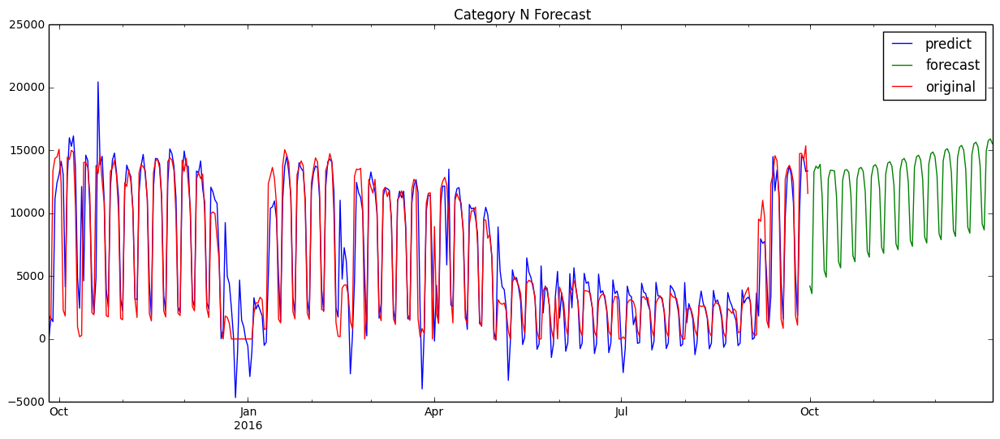

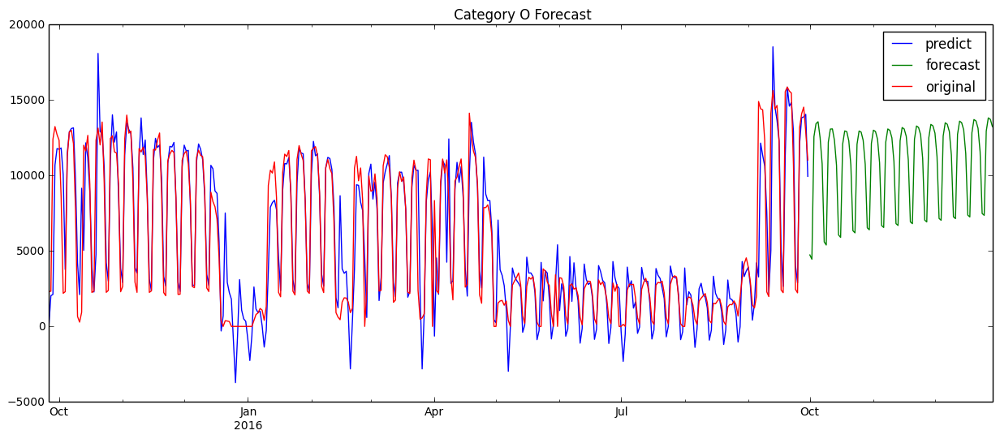

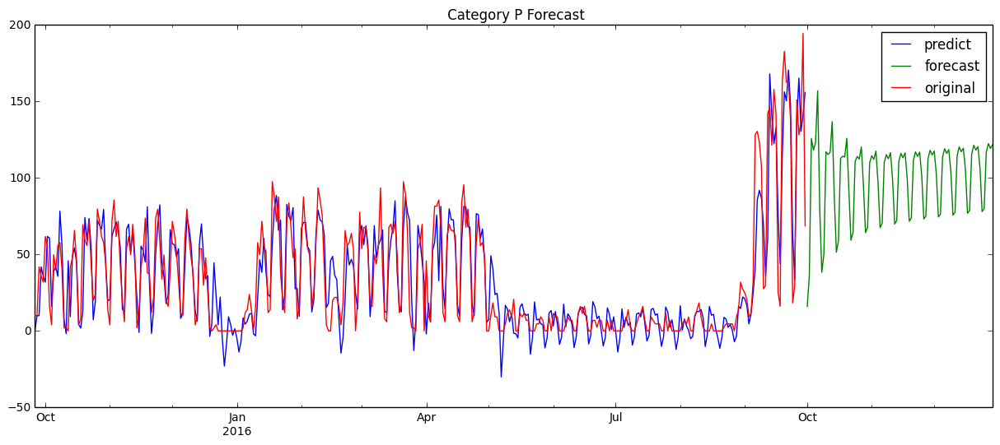

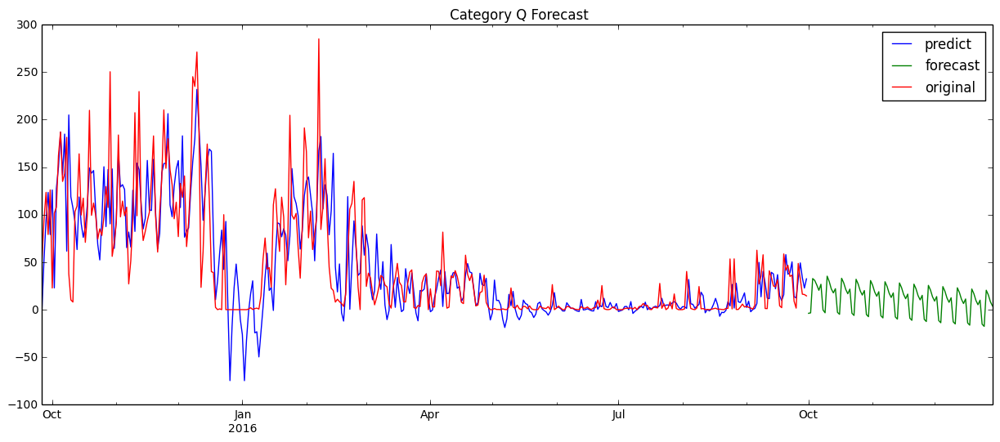

In [82]:
pred = map(plot_forecast, results_1, splitted_data, temp_list)

### Problem: A), D), E), I), L)

In [83]:
# report performance
def rmse_measurement(timeseries, pred, item):
    mse = mean_squared_error(timeseries, pred)
    rmse = sqrt(mse)
    print('Category {} - RMSE: %.3f'.format(item) % rmse)

In [84]:
_ = map(rmse_measurement, splitted_data, pred, temp_list)

Category A - RMSE: 78.730
Category B - RMSE: 1297.897
Category C - RMSE: 484.574
Category D - RMSE: 130.402
Category E - RMSE: 148.935
Category F - RMSE: 3682.584
Category G - RMSE: 628.287
Category H - RMSE: 1038.580
Category I - RMSE: 317.536
Category K - RMSE: 202.394
Category L - RMSE: 225.621
Category M - RMSE: 4310.820
Category N - RMSE: 2391.483
Category O - RMSE: 2125.309
Category P - RMSE: 17.857
Category Q - RMSE: 37.184


# Total Forecast

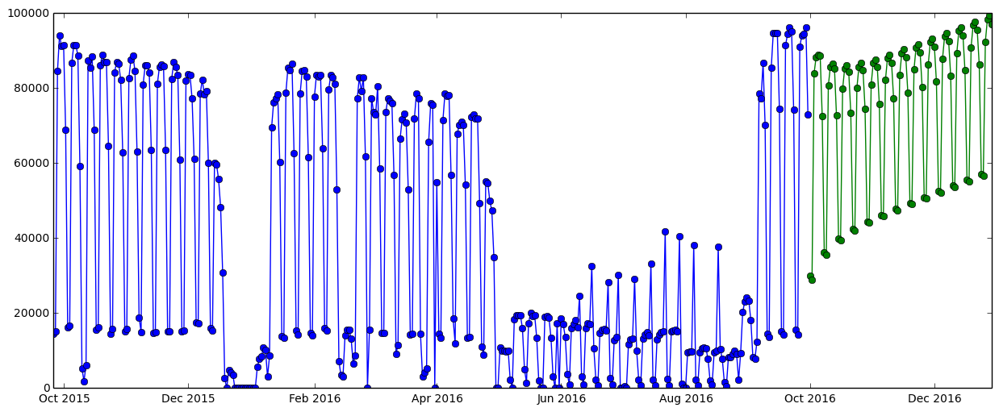

In [128]:
forecast_90 = map(lambda x: x.forecast(steps=90), results_1)

total_forecast = pd.Series()
original_sales = pd.Series()
for i, df in enumerate(forecast_90):
    if i == 0:
        total_forecast = df
        original_sales = splitted_data[i]
    else:
        total_forecast = total_forecast + df
        original_sales = original_sales + splitted_data[i]
        
plt.plot(original_sales.index, original_sales, '-o')
plt.plot(total_forecast.index, total_forecast, '-o')

Category B Sales Contribution:  0.0917437260854
Category F Sales Contribution:  0.191369354324
Category H Sales Contribution:  0.0803990744559
Category M Sales Contribution:  0.153073223437
Category N Sales Contribution:  0.156570073252
Category O Sales Contribution:  0.143709105854


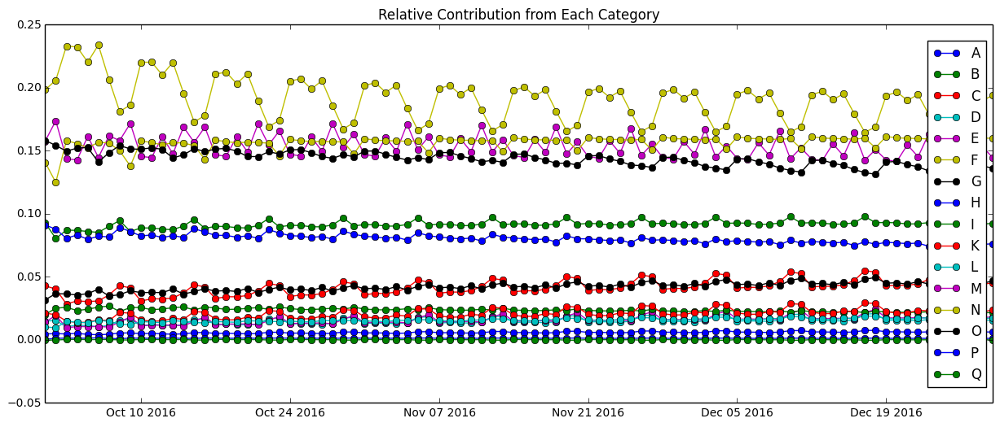

In [144]:
def relative_cont_plot(forecast_90, item):
    category = forecast_90 / total_forecast
#     print 'Category {}: '.format(item), category.mean()
    if category.mean() >= 0.08:
        print 'Category {} Sales Contribution: '.format(item), category.mean()
    _ = plt.plot(category.index, category, '-o', label=item)
    _ = plt.legend(loc='right')
    _ = plt.title('Relative Contribution from Each Category')
    
_ = map(relative_cont_plot, forecast_90, temp_list)

# Top Down Approach - Build Model and Forecast on All Categories.

In [95]:
print original_sales.head()
idx = pd.date_range('09-26-2015', '09-30-2016')    

original_sales.index = pd.DatetimeIndex(original_sales.index)
original_sales = original_sales.reindex(idx, fill_value=0)
print original_sales.shape, '-', original_sales.index

print '\n', original_sales.head()

2015-09-26    14588.23
2015-09-27    15143.61
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64
(371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')

2015-09-26    14588.23
2015-09-27    15143.61
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64


In [96]:
total_forecast = model_building(original_sales, 'Total')

SARIMA(0, 1, 1) (0, 1, 1, 7) AIC=8030.213
SARIMA(0, 1, 1) (1, 1, 1, 7) AIC=8008.632
SARIMA(1, 1, 1) (0, 1, 1, 7) AIC=8013.144
SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=7993.152
Best SARIMA(1, 1, 1) (1, 1, 1, 7) AIC=7993.152
Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3991.576
Date:                           Fri, 17 Feb 2017   AIC                           7993.152
Time:                                   02:03:38   BIC                           8012.733
Sample:                               09-26-2015   HQIC                          8000.929
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z     

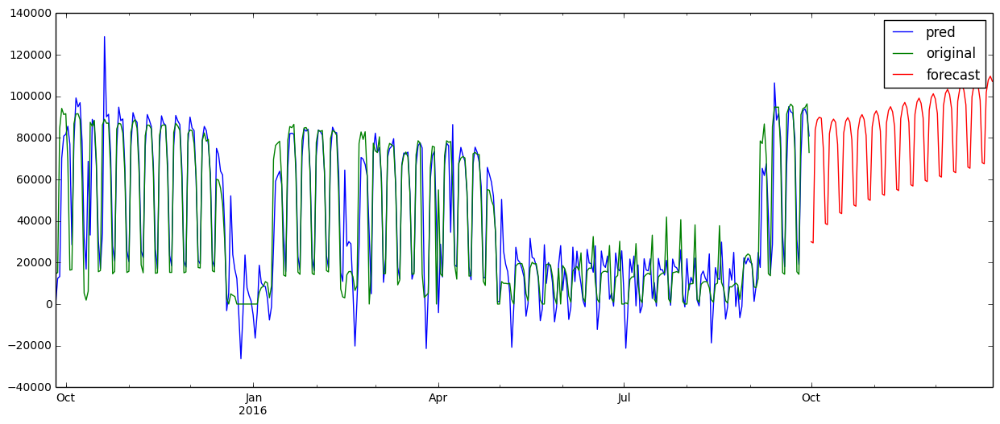

In [102]:
pred = total_forecast.predict()
forecast_90 = total_forecast.forecast(steps=90)

pred.plot(label='pred')
original_sales.plot(label='original')
forecast_90.plot(label='forecast')
plt.legend()

In [371]:
total_forecast = model_building(original_sales, 'Total', 0, 1, 0, 1)

Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  346
Model:             SARIMAX(0, 1, 1)x(0, 1, 1, 7)   Log Likelihood               -3769.269
Date:                           Thu, 16 Feb 2017   AIC                           7544.537
Time:                                   20:20:52   BIC                           7556.077
Sample:                               09-26-2015   HQIC                          7549.132
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.3097      0.037     -8.390      0.000      -0.382      -0.237
ma.S.L7       -0.2667     

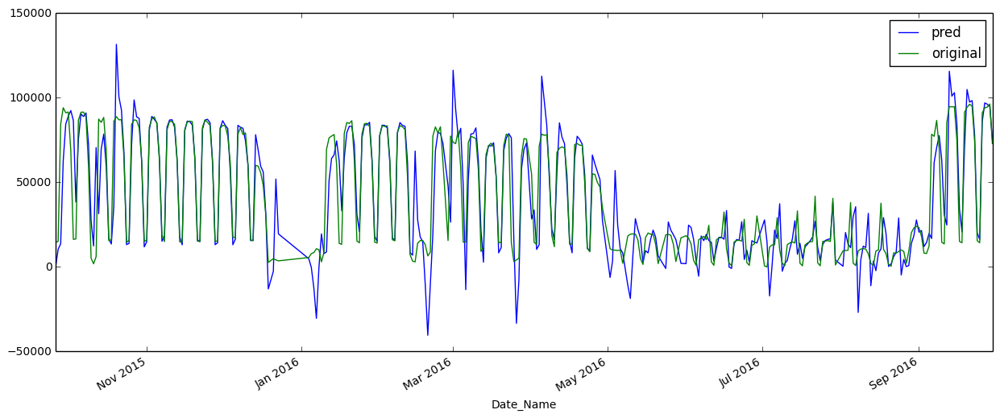

In [372]:
pred = total_forecast.predict()
pred_90 = total_forecast.predict(start=345, end=436)

pred.plot(label='pred')
original_sales.plot(label='original')
plt.legend()

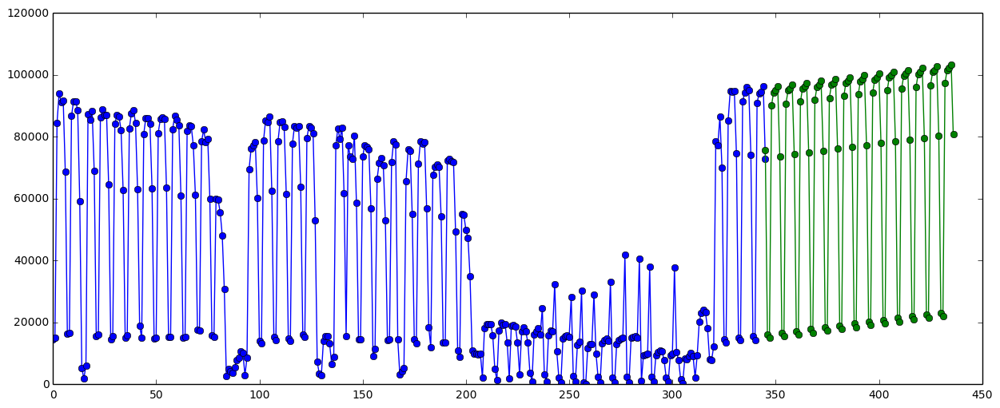

In [385]:
temp_array = np.array(original_sales)
plt.plot(temp_array, '-o')
plt.plot(pred_90.index, pred_90, '-o')

In [374]:
total_forecast_2 = model_building(original_sales, 'Total', 1, 1, 1, 1)

Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  346
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 7)   Log Likelihood               -3756.059
Date:                           Thu, 16 Feb 2017   AIC                           7522.117
Time:                                   20:23:49   BIC                           7541.349
Sample:                               09-26-2015   HQIC                          7529.775
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.6920      0.040     17.327      0.000       0.614       0.770
ma.L1         -0.9960     

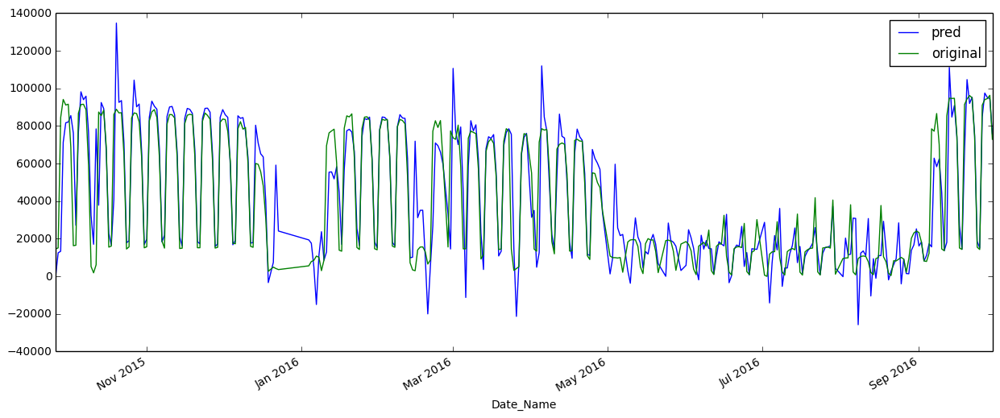

In [376]:
pred = total_forecast_2.predict()
pred_90_2 = total_forecast_2.predict(start=345, end=436)

pred.plot(label='pred')
original_sales.plot(label='original')
plt.legend()

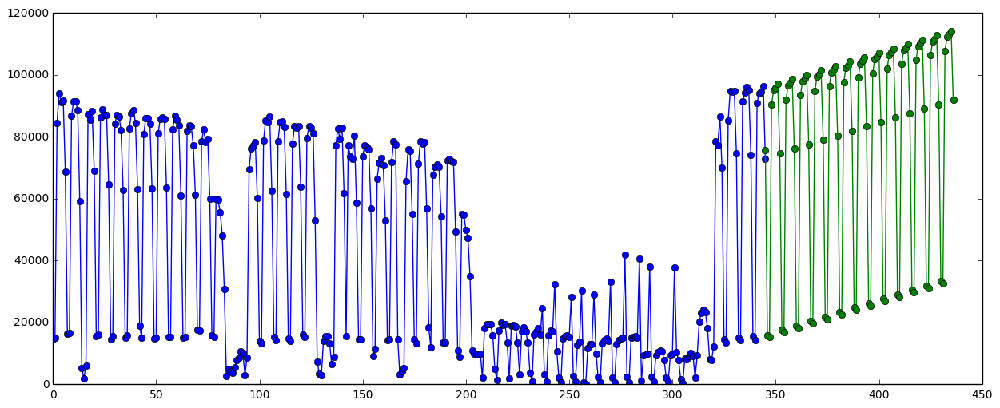

In [386]:
temp_array = np.array(original_sales)
plt.plot(temp_array, '-o')
plt.plot(pred_90_2.index, pred_90_2, '-o')